In [2]:
import os
import mdtraj as mdt
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import barnaba as bb
import scipy as sp
import pandas as pd
import seaborn as sns
from sklearn.decomposition import PCA
from matplotlib.lines import Line2D
import pickle
from scipy.spatial.distance import squareform,pdist
from rdkit import Chem
from sklearn.preprocessing import normalize
from collections import defaultdict
from scipy import stats
import copy

In [3]:
path_data="/media/francy/Storage/raguti/file4ric/malat1_analyses/"     #change here with the location of the data folder

## Pocketron

Here you can find all the steps required for the Pocketron workflow, including the generation of the matrix and the communication network between pockets.

In [4]:
os.chdir(path_data+"pocketron_malat1")

In [5]:
traj=mdt.load("ref.pdb")

In [32]:
file=open('pockets.txt','r')
file.readline()
pockets={}
i=0
for line in file:
    p1=[]
    i+=1
    line=line.split()
    for element in line:
        if element!='\n':
            p1.append(int(element)-1)
            res=np.array([a.residue.index for a in traj.top.atoms if a.index in p1])
            res=np.unique(res)
    temp=[]
    resid=[]
    for value in res:
        temp.append(int(value)+1)
    resid.append(temp)
    pockets.update({i:resid[0]})
last_key = list(pockets)[-1]
removed_tuple = pockets.pop(last_key)

In [33]:
n_pockets=len(pockets)
print(n_pockets)

37


In [34]:
file=open('volumes.txt',"r")
file.readline()
volumes=[0]*len(pockets)
frames=0
for line in file:
    frames+=1
    line=line.split('\t')
    if line[0]!="\n":
        for i in range(0,len(pockets)):
            volumes[i]+=float(line[i])
max=np.max(volumes)
max=max/frames
for i in range(len(volumes)):
    volumes[i]=float(volumes[i])/frames
file.close() 
com={}
for i in range(1,len(pockets)+1):
    string=""
    for element in range(len(pockets[i])):
        string+=" "+str(int(pockets[i][element])-1)
    string="resid"+str(string)
    COM=mdt.compute_center_of_mass(traj, select=string)
    com.update({i:COM})
def scale_range (inp, minv, maxv):
    inp += -(np.min(inp))
    inp /= np.max(inp) / (maxv - minv)
    inp += minv
    return inp

vol_mat=np.loadtxt('volumes.txt',skiprows=1)
scaled_vols=scale_range(np.average(vol_mat,axis=0),0.5,3)
file=open('com_malat1.txt',"w")
xyz=[]
file.write('graphics top color yellow \n')
j=0
for i in range(1,len(com)+1):
    string=""
    for element in range(3):
        string+=str(com[i][0][element]*10)+' '
    radius=scaled_vols[j]  
    file.write('graphics top sphere {'+str(string)+'} radius '+str(radius)+' resolution 100 \n')
    xyz.append(str(string))
    j+=1
file.write('graphics top color black \n')
j=0
for i in range(1,len(com)+1):
    string2=""
    for element in range(3):
        string2+=str((com[i][0][element]*10)+0.5)+' ' # To move the labels
    radius=scaled_vols[j]
    file.write('graphics top text {'+str(string2)+'} "'+str(i)+'" size 1 \n')
    j+=1
file.close()

In [35]:
X_m, Y_m, Z_m = np.loadtxt('mergeMatrix.txt', unpack=True)
X_m = np.reshape(X_m, (len(pockets),len(pockets)))
Y_m = np.reshape(Y_m, (len(pockets),len(pockets)))
Z_m = np.reshape(Z_m, (len(pockets),len(pockets)))
Z_ms=(Z_m+Z_m.T)/2 
X_s, Y_s, Z_s = np.loadtxt('splitMatrix.txt', unpack=True)
X_m = np.reshape(X_m, (len(pockets),len(pockets)))
X_s = np.reshape(X_m, (len(pockets),len(pockets)))
Y_s = np.reshape(Y_m, (len(pockets),len(pockets)))
Z_s = np.reshape(Z_m, (len(pockets),len(pockets)))
Z_ss=(Z_s+Z_s.T)/2
ms_avg= (Z_ms+Z_ss)/2 # merge/split average

In [36]:
X_m = np.reshape(X_m, (len(pockets),len(pockets)))
Y_m = np.reshape(Y_m, (len(pockets),len(pockets)))
Z_m = np.reshape(Z_m, (len(pockets),len(pockets)))

In [40]:
matrix=copy.deepcopy(ms_avg)
np.fill_diagonal(matrix,0)
matrix=matrix/np.max(matrix)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/matrix_pocketron.pkl", "wb") as f:
#    pickle.dump(matrix, f)

# --- Load ---
with open(path_data+"data_plots/matrix_pocketron.pkl", "rb") as f:
    matrix = pickle.load(f)

In [46]:
matrix_Pock_sort=np.sort((np.array(matrix).flatten()))[::-1]
matrix_Pock_sort = [i for i in matrix_Pock_sort if i != 0]
top_30=60

In [48]:
file=open('cylinder_Pock_malat1.txt',"w")
file.write('graphics top color green \n')
for i in range(len(xyz)):
    for j in range(len(xyz)):
        #print(i,j)
        if i<j:
            if matrix[i][j] > matrix_Pock_sort[top_30]:
                radius=matrix[i][j]*1 #Adjust to scale suitable for VMD visualization
            else:
                radius=0
            file.write("graphics top cylinder {"+str(xyz[i])+"} {"+str(xyz[j])+"} radius "+str(radius)+'\n')
file.close()

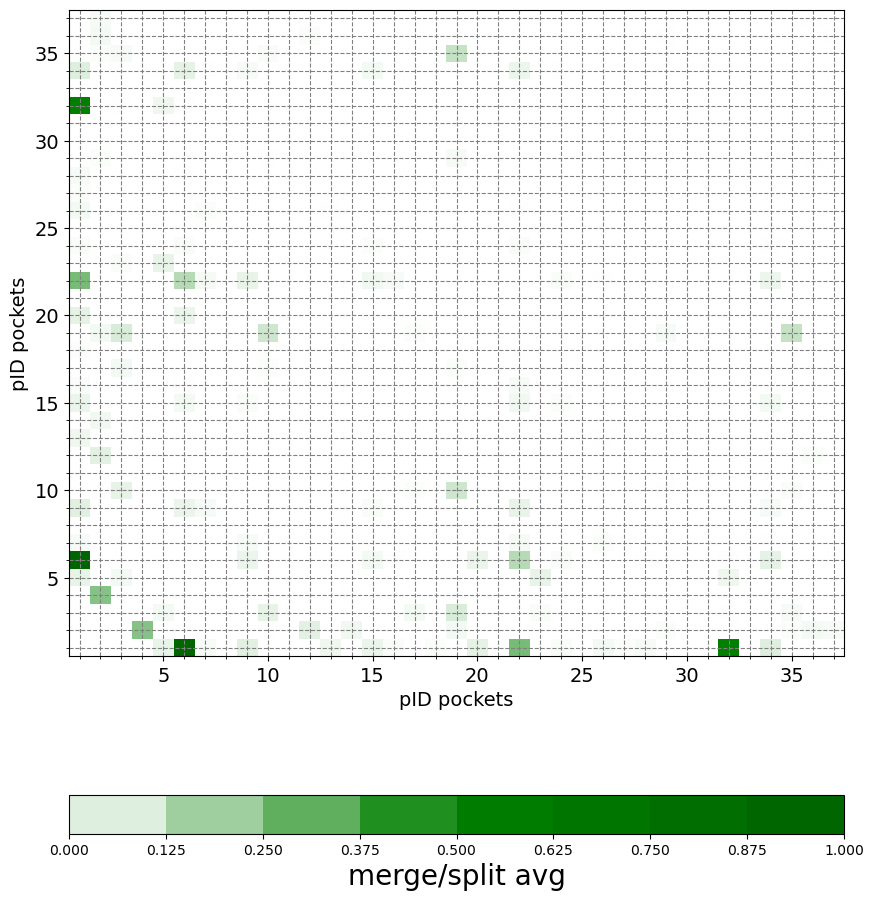

In [49]:
fig = plt.figure(figsize=(10,12))
ax = plt.axes()
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ["white","green","darkgreen"])

surf = ax.pcolormesh(X_s,Y_s,matrix,shading='nearest',cmap=cmap) # , vmin=0, vmax=25
plt.colorbar(surf,orientation="horizontal",pad=0.15,boundaries=np.linspace(0,1,9)).ax.set_xlabel('merge/split avg', fontsize=20)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("pID pockets",fontsize=14)
plt.ylabel("pID pockets",fontsize=14)
plt.gca().set_xticks(np.linspace(1,len(X_s),len(X_s),dtype='int'),minor=True)
plt.gca().set_yticks(np.linspace(1,len(X_s),len(X_s),dtype='int'),minor=True)
plt.grid(which='both',ls='--',color='gray')
plt.show()

## RMSD and eRMSD analysis

Here you can find all the analyses performed on the unbiased and HREX trajectories, including RMSD, eRMSD, and PCA calculations for the polyA residues as well as for site 1 and site 2.

In [6]:
os.chdir(path_data+"data_trj")

In [7]:
traj_unb_s1 = mdt.load('unb_joined_s1.xtc', top='em_RNA_s1.pdb')
traj_unb_s2 = mdt.load('unb_joined_s2.xtc', top='em_RNA_s2.pdb')
reference_unb_s1 = mdt.load('reference_unb_s1.pdb')
reference_unb_s2 = mdt.load('reference_unb_s2.pdb')
reference_crystal_s1=mdt.load('em_RNA_s1.pdb')
reference_crystal_s2=mdt.load('em_RNA_s2.pdb')
traj_hrex_s1 = mdt.load('traj_cat_RNA_whole_center_mol_skip2_s1.xtc', top="em_RNA_s1.pdb")
traj_hrex_s2 = mdt.load('traj_cat_RNA_whole_center_mol_skip2_s2.xtc', top="em_RNA_s2.pdb")
reference_hrex_s1=mdt.load("reference_hrex_s1.pdb")
reference_hrex_s2=mdt.load("reference_hrex_s2.pdb")
traj_tot_s1 = mdt.load('traj_cat_RNA_tot_skip10unb_skip2hrex_s1.xtc', top='em_RNA_s1.pdb')
traj_tot_s2 = mdt.load('traj_cat_RNA_tot_skip10unb_skip2hrex_s2.xtc', top='em_RNA_s2.pdb')
traj_unb_polyA= mdt.load("unb_joined_polyA.xtc", top="reference_unb_polyA.pdb")
traj_tot_polyA = mdt.load("traj_cat_RNA_tot_skip10unb_skip2hrex_polyA.xtc",top="reference_unb_polyA.pdb")
reference_unb_polyA= mdt.load("em_polyA.pdb")

In [8]:
top_s1='em_RNA_s1.pdb'
top_s2='em_RNA_s2.pdb'
top_polyA="reference_unb_polyA.pdb"
top_hrex_tot = 'reference_hrex.pdb'
trj_unb_s1 = 'unb_joined_s1.xtc'    
trj_unb_s2 = 'unb_joined_s2.xtc' 
trj_hrex_s1 = 'traj_cat_RNA_whole_center_mol_skip2_s1.xtc'    
trj_hrex_s2 = 'traj_cat_RNA_whole_center_mol_skip2_s2.xtc'
trj_hrex_tot = 'traj_cat_RNA_tot_skip20unb_skip5hrex.xtc'
trj_tot_s1 = 'traj_cat_RNA_tot_skip10unb_skip2hrex_s1.xtc'
trj_tot_s2 = 'traj_cat_RNA_tot_skip10unb_skip2hrex_s2.xtc'
trj_tot_polyA= "traj_cat_RNA_tot_skip10unb_skip2hrex_polyA.xtc"
trj_unb_polyA = 'unb_joined_polyA.xtc'
native_unb_polyA = "reference_unb_polyA.pdb"
native_unb_s1 = "reference_unb_s1.pdb"
native_unb_s2 = "reference_unb_s2.pdb"
native_hrex_s1 = "reference_hrex_s1.pdb"
native_hrex_s2 = "reference_hrex_s2.pdb"
native_crystal_s1 = "em_RNA_s1.pdb"
native_crystal_s2 = "em_RNA_s2.pdb"
native_crystal = "em_RNA.pdb"
native_crystal_polyA = "reference_unb_polyA.pdb"
native_hrex_tot = 'reference_unb.pdb'

In [9]:
site_1_resids=np.array('3 4 5 6 7 47 49 50 51 52 53 54 56 57 58 59 60 61 62 63 64 65 66 67'.split(),dtype=int)-2 # differenza tra VMD and 0-based array
site_2_resids=np.array('9 10 11 12 13 14 40 41 67 68 69 70 71 72 73'.split(),dtype=int)-2
site_polyA=np.arange(55,75)-2

In [10]:
sel_noh_s1 = reference_unb_s1.top.select('not element H and resname A U C G')
sel_noh_s2 = reference_unb_s2.top.select('not element H and resname A U C G')
sel_noh_polyA = reference_unb_polyA.top.select('not element H and resname A U C G')
traj_unb_s1.superpose(reference_unb_s1, frame=0, atom_indices=sel_noh_s1)
traj_unb_s2.superpose(reference_unb_s2, frame=0, atom_indices=sel_noh_s2)
traj_hrex_s1.superpose(reference_hrex_s1, frame=0, atom_indices=sel_noh_s1)
traj_hrex_s2.superpose(reference_hrex_s2, frame=0, atom_indices=sel_noh_s2)
traj_tot_s1.superpose(reference_unb_s1, frame=0, atom_indices=sel_noh_s1)
traj_tot_s2.superpose(reference_unb_s2, frame=0, atom_indices=sel_noh_s2)
traj_unb_polyA.superpose(reference_unb_polyA, frame=0, atom_indices=sel_noh_polyA)
traj_tot_polyA.superpose(reference_unb_polyA, frame=0, atom_indices=sel_noh_polyA)

<mdtraj.Trajectory with 63215 frames, 455 atoms, 21 residues, and unitcells at 0x7ac125e74430>

In [55]:
rmsd_unb_polyA= []
for i in range(traj_unb_polyA.n_frames):
    rmsd_i = np.sqrt(np.sum(np.square(traj_unb_polyA.xyz[i,sel_noh_polyA]-reference_unb_polyA.xyz[0,sel_noh_polyA]))/len(sel_noh_polyA))
    rmsd_unb_polyA.append(rmsd_i)
rmsd_unb_polyA=np.array(rmsd_unb_polyA)

In [56]:
gvec1_unb_polyA,seq1_unb_polyA = bb.dump_gvec(trj_unb_polyA,topology=top_polyA)
gvec1_unb_polyA.shape
gvec1_unb_polyA = gvec1_unb_polyA.reshape(gvec1_unb_polyA.shape[0],-1)
print(gvec1_unb_polyA.shape)
reference_gvec1_unb_polyA,reference_seq1_unb_polyA=bb.dump_gvec(native_unb_polyA)
reference_gvec1_unb_polyA = reference_gvec1_unb_polyA.reshape(reference_gvec1_unb_polyA.shape[0],-1)
print(reference_gvec1_unb_polyA.shape)
ermsd_mine1_unb_polyA=sp.spatial.distance_matrix(reference_gvec1_unb_polyA,gvec1_unb_polyA)[0]/np.sqrt(len(site_polyA))

# Loading unb_joined_polyA.xtc 


(150003, 1764)
(1, 1764)


# Loading reference_unb_polyA.pdb 


In [ ]:
# --- Save ---
#with open(path_data+"data_plots/rmsd_unb_polyA.pkl", "wb") as f:
#    pickle.dump(rmsd_unb_polyA, f)

# --- Load ---
with open(path_data+"data_plots/rmsd_unb_polyA.pkl", "rb") as f:
    rmsd_unb_polyA = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_unb_polyA.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_unb_polyA, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_unb_polyA.pkl", "rb") as f:
    ermsd_mine1_unb_polyA = pickle.load(f)

In [58]:
n_frames=traj_unb_polyA.n_frames

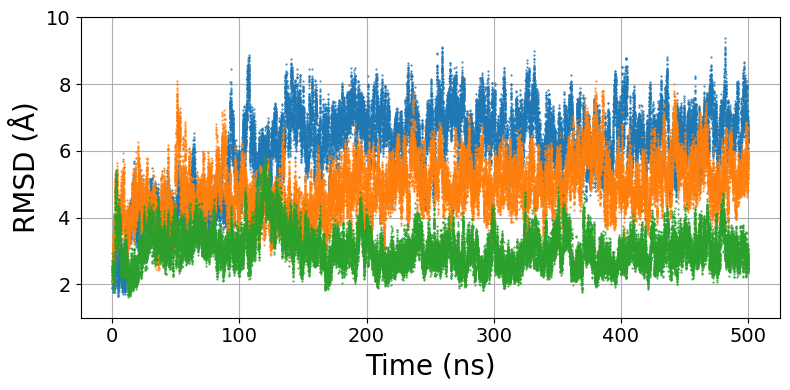

In [59]:
plt.figure(figsize=(8, 4))
plt.plot(np.arange(0,int(n_frames/3))/100, rmsd_unb_polyA[:int(n_frames/3)]*10,'.',ms=1,label="Run 1")
plt.plot(np.arange(0,int(n_frames/3))/100, rmsd_unb_polyA[int(n_frames/3):int(2*n_frames/3)]*10,'.',ms=1,label="Run 2")
plt.plot(np.arange(0,int(n_frames/3))/100, rmsd_unb_polyA[int(2*n_frames/3):int(n_frames)]*10,'.',ms=1,label="Run 3")


#plt.title('eRMSD RNA hrex site1', fontsize=16)
plt.xlabel('Time (ns)', fontsize=20)
plt.ylabel('RMSD (Å)', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.ylim(1,10)
plt.subplots_adjust(bottom=0.15, top=0.9, left=0.15, right=0.9)
plt.tight_layout()
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/RMSD_unb_polyA.png', dpi=300)
plt.show()

In [60]:
hist_rmsd_unb_polyA={}
hist_rmsd_unb_polyA["run1"]=np.histogram(rmsd_unb_polyA[0:int(n_frames/3)]*10,bins=50,range=(1,10),density=True)
hist_rmsd_unb_polyA["run2"]=np.histogram(rmsd_unb_polyA[int(n_frames/3):int(n_frames*2/3)]*10,bins=50,range=(1,10),density=True)
hist_rmsd_unb_polyA["run3"]=np.histogram(rmsd_unb_polyA[int(n_frames*2/3):int(n_frames)]*10,bins=50,range=(1,10),density=True)

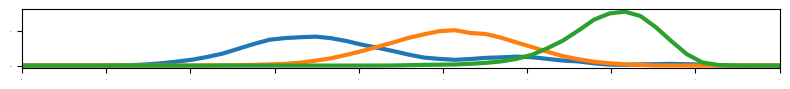

In [61]:
plt.figure(figsize=(8,1))
plt.plot(np.linspace(1,10,50),hist_rmsd_unb_polyA["run1"][0],label="Run 1",lw=3)
plt.plot(np.linspace(1,10,50),hist_rmsd_unb_polyA["run2"][0],label="Run 2",lw=3)
plt.plot(np.linspace(1,10,50),hist_rmsd_unb_polyA["run3"][0],label="Run 3",lw=3)
plt.xticks(size=0)
plt.yticks(size=0)
plt.xlim(1,10)
plt.gca().invert_xaxis()
plt.tight_layout()
#plt.legend()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/P(RMSD)_polyA_unb.png', dpi=300, bbox_inches='tight')
plt.show()

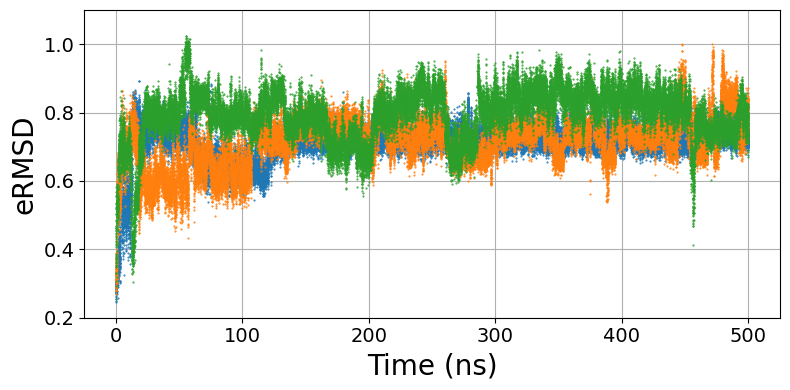

In [65]:
plt.figure(figsize=(8, 4))
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_polyA[1:int(n_frames/3)],'.',ms=1,label="Run1")
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_polyA[int(n_frames/3)+1:int(2*n_frames/3)],'.',ms=1,label="Run2")
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_polyA[int(2*n_frames/3)+1:int(n_frames)],'.',ms=1,label="Run3")
plt.xlabel('Time (ns)', fontsize=20)
plt.ylabel('eRMSD', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.subplots_adjust(bottom=0.15, top=0.9, left=0.15, right=0.9)
plt.ylim(0.2,1.1)
plt.tight_layout()
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/eRMSD_unb_polyA.png', dpi=300)
plt.show()

In [66]:
hist_ermsd_unb_polyA={}
hist_ermsd_unb_polyA["run1"]=np.histogram(ermsd_mine1_unb_polyA[0:int(n_frames/3)],bins=50,range=(0.2,1.1),density=True)
hist_ermsd_unb_polyA["run2"]=np.histogram(ermsd_mine1_unb_polyA[int(n_frames/3):int(n_frames*2/3)],bins=50,range=(0.2,1.1),density=True)
hist_ermsd_unb_polyA["run3"]=np.histogram(ermsd_mine1_unb_polyA[int(n_frames*2/3):int(n_frames)],bins=50,range=(0.2,1.1),density=True)

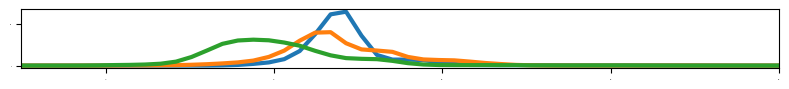

In [67]:
plt.figure(figsize=(8,1))
plt.plot(np.linspace(0.2,1.1,50),hist_ermsd_unb_polyA["run1"][0],label="Run 1",lw=3)
plt.plot(np.linspace(0.2,1.1,50),hist_ermsd_unb_polyA["run2"][0],label="Run 2",lw=3)
plt.plot(np.linspace(0.2,1.1,50),hist_ermsd_unb_polyA["run3"][0],label="Run 3",lw=3)
plt.xticks(size=0)
plt.yticks(size=0)
plt.xlim(0.2,1.1)
plt.gca().invert_xaxis()
plt.tight_layout()
#plt.legend()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/P(eRMSD)_polyA_unb.png', dpi=300, bbox_inches='tight')
plt.show()

In [68]:
rmsd_tot_polyA= []
for i in range(traj_tot_polyA.n_frames):
    rmsd_i = np.sqrt(np.sum(np.square(traj_tot_polyA.xyz[i,sel_noh_polyA]-reference_unb_polyA.xyz[0,sel_noh_polyA]))/len(sel_noh_polyA))
    rmsd_tot_polyA.append(rmsd_i)
rmsd_tot_polyA=np.array(rmsd_tot_polyA)

In [69]:
gvec1_tot_polyA,seq1_tot_polyA = bb.dump_gvec(trj_tot_polyA,topology=top_polyA)
gvec1_tot_polyA.shape
gvec1_tot_polyA = gvec1_tot_polyA.reshape(gvec1_tot_polyA.shape[0],-1)
print(gvec1_tot_polyA.shape)
reference_gvec1_tot_polyA,reference_seq1_tot_polyA=bb.dump_gvec(native_unb_polyA)
reference_gvec1_tot_polyA = reference_gvec1_tot_polyA.reshape(reference_gvec1_tot_polyA.shape[0],-1)
print(reference_gvec1_tot_polyA.shape)
ermsd_mine1_tot_polyA=sp.spatial.distance_matrix(reference_gvec1_tot_polyA,gvec1_tot_polyA)[0]/np.sqrt(len(site_polyA))

# Loading traj_cat_RNA_tot_skip10unb_skip2hrex_polyA.xtc 


(63215, 1764)
(1, 1764)


# Loading reference_unb_polyA.pdb 


In [ ]:
# --- Save ---
#with open(path_data+"data_plots/rmsd_tot_polyA.pkl", "wb") as f:
#    pickle.dump(rmsd_tot_polyA, f)

# --- Load ---
with open(path_data+"data_plots/rmsd_tot_polyA.pkl", "rb") as f:
    rmsd_tot_polyA = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_tot_polyA.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_tot_polyA, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_tot_polyA.pkl", "rb") as f:
    ermsd_mine1_tot_polyA = pickle.load(f)

In [72]:
n_frames_tot=int(traj_tot_polyA.n_frames)

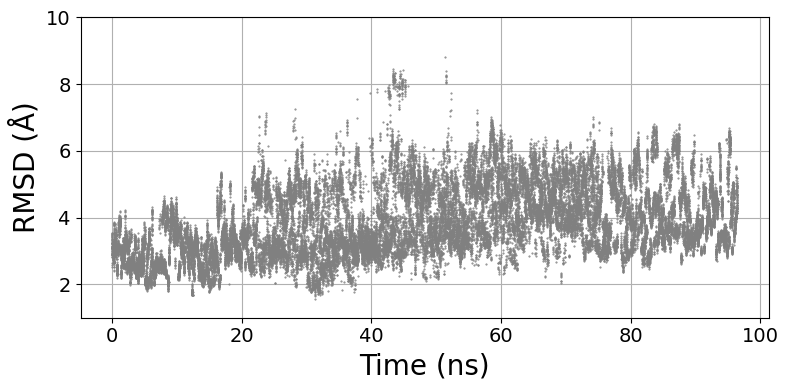

In [73]:
plt.figure(figsize=(8, 4))
plt.plot(np.arange(0,48215)/500, rmsd_tot_polyA[15000:]*10,'.',ms=1,label="hREX",color="gray")
plt.xlabel('Time (ns)', fontsize=20)
plt.ylabel('RMSD (Å)', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.ylim(1,10)
plt.subplots_adjust(bottom=0.15, top=0.9, left=0.15, right=0.9)
plt.tight_layout()
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/RMSD_tot_polyA.png', dpi=300)
plt.show()

In [74]:
hist_rmsd_tot_polyA={}
hist_rmsd_tot_polyA["hREX"]=np.histogram(rmsd_tot_polyA[15000:]*10,bins=50,range=(1,10),density=True)

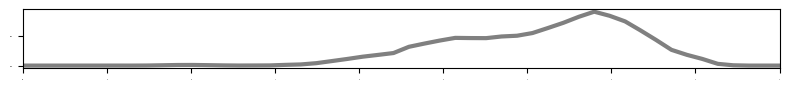

In [75]:
plt.figure(figsize=(8, 1))
plt.plot(np.linspace(1,10,50),hist_rmsd_tot_polyA["hREX"][0],label="Run 3",lw=3,color="gray")
plt.xticks(size=0)
plt.yticks(size=0)
plt.xlim(1,10)
plt.gca().invert_xaxis()
plt.tight_layout()
#plt.legend()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/P(RMSD)_tot_polyA.png', dpi=300, bbox_inches='tight')
plt.show()

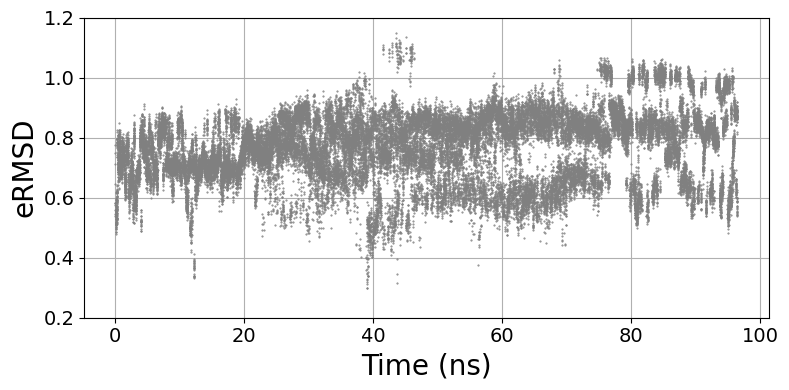

In [76]:
plt.figure(figsize=(8, 4))
plt.plot(np.arange(0,48215)/500, ermsd_mine1_tot_polyA[15000:],'.',ms=1,label="hREX",color="gray")
plt.xlabel('Time (ns)', fontsize=20)
plt.ylabel('eRMSD', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.subplots_adjust(bottom=0.15, top=0.9, left=0.15, right=0.9)
plt.ylim(0.2,1.2)
plt.tight_layout()
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/eRMSD_tot_polyA.png', dpi=300)
plt.show()

In [77]:
hist_ermsd_tot_polyA={}
hist_ermsd_tot_polyA["hREX"]=np.histogram(ermsd_mine1_tot_polyA[15000:],bins=50,range=(0.2,1.2),density=True)

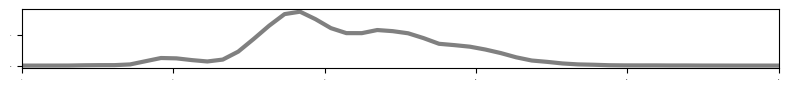

In [78]:
plt.figure(figsize=(8,1))
plt.plot(np.linspace(0.2,1.2,50),hist_ermsd_tot_polyA["hREX"][0],label="Run 3",lw=3,color="gray")
plt.xticks(size=0)
plt.yticks(size=0)
plt.xlim(0.2,1.2)
plt.gca().invert_xaxis()
plt.tight_layout()
#plt.legend()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/P(eRMSD)_tot_polyA.png', dpi=300, bbox_inches='tight')
plt.show()

In [79]:
reference_gvec1_crystal_polyA,reference_seq1_crystal_s1=bb.dump_gvec(native_crystal_polyA)
reference_gvec1_crystal_polyA = reference_gvec1_crystal_polyA.reshape(reference_gvec1_crystal_polyA.shape[0],-1)
print(reference_gvec1_crystal_polyA.shape)
ermsd_mine1_crystal_polyA=sp.spatial.distance_matrix(reference_gvec1_crystal_polyA,reference_gvec1_crystal_polyA)[0]/np.sqrt(len(site_polyA))

(1, 1764)


# Loading reference_unb_polyA.pdb 


In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_crystal_polyA.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_crystal_polyA, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_crystal_polyA.pkl", "rb") as f:
    ermsd_mine1_crystal_polyA = pickle.load(f)

In [81]:
pca_tot_polyA = PCA(n_components=2)
converted_data_tot_polyA = pca_tot_polyA.fit_transform(gvec1_tot_polyA)
pca_tot_polyA.explained_variance_ratio_
features_crystal_polyA=pca_tot_polyA.transform(reference_gvec1_crystal_polyA)

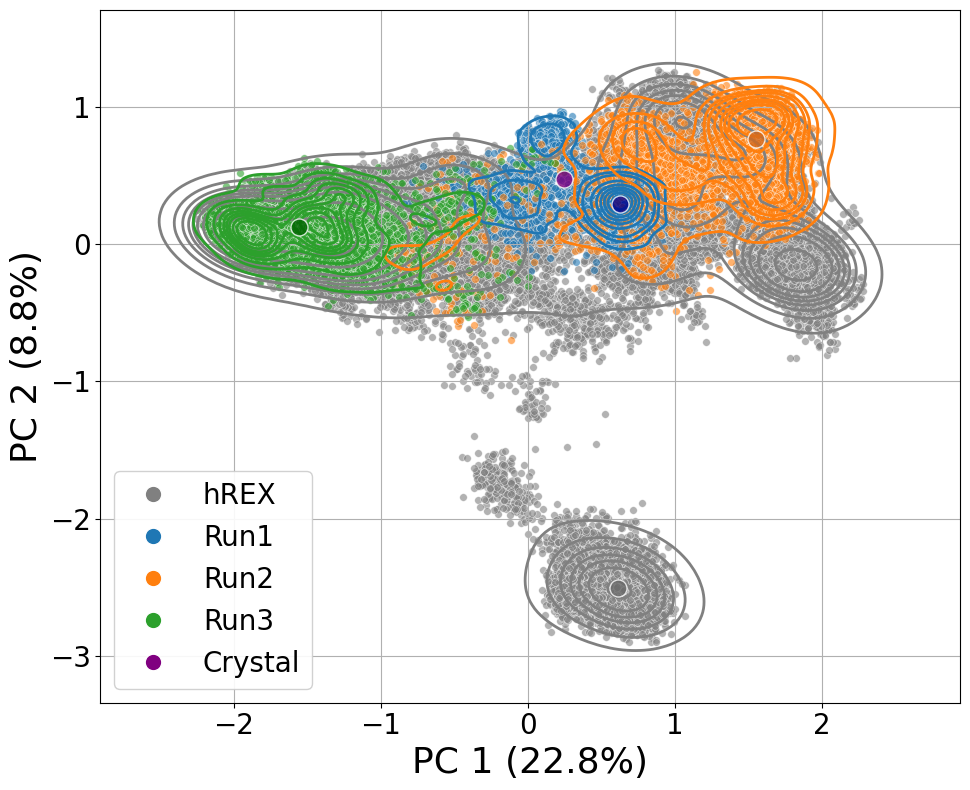

In [82]:
test_pca_tot_polyA=pd.DataFrame(converted_data_tot_polyA[:,:2],columns=["PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),"PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1))])
test_pca_crystal_polyA=pd.DataFrame(features_crystal_polyA[:,:2],columns=["PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),"PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1))])
fig,ax=plt.subplots(figsize=(9.8,8))
sns.kdeplot(data=test_pca_tot_polyA.loc[15003:],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2,color="gray")
sns.kdeplot(data=test_pca_tot_polyA.loc[:5001],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)
sns.kdeplot(data=test_pca_tot_polyA.loc[5001:10002],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)
sns.kdeplot(data=test_pca_tot_polyA.loc[10002:15003],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)

#sns.kdeplot(data=test_pca_crystal_s1,x="PC1 ({}%)".format(np.around(pca_unb_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_unb_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="purple")
sns.scatterplot(data=test_pca_tot_polyA.loc[15003:],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30,color="gray")
sns.scatterplot(data=test_pca_tot_polyA.loc[:5001],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_tot_polyA.loc[5001:10002],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_tot_polyA.loc[10002:15003],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_tot_polyA.loc[13541:13541],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="darkgreen",s=150,alpha=0.8,zorder=5)
sns.scatterplot(data=test_pca_tot_polyA.loc[7297:7297],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="chocolate",s=150,alpha=0.8,zorder=5)
sns.scatterplot(data=test_pca_tot_polyA.loc[4288:4288],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="darkblue",s=150,alpha=0.8,zorder=5)
sns.scatterplot(data=test_pca_tot_polyA.loc[33460:33460],x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="dimgrey",s=150,alpha=0.8,zorder=5)
sns.scatterplot(data=test_pca_crystal_polyA,x="PC1 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="purple",s=150,alpha=0.8,zorder=5)
plt.xlabel("PC 1 (%s%%)"%np.around(pca_tot_polyA.explained_variance_ratio_[0]*100,decimals=1), fontsize=26)
plt.ylabel("PC 2 (%s%%)"%np.around(pca_tot_polyA.explained_variance_ratio_[1]*100,decimals=1), fontsize=26)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
#ax.set_aspect('equal', adjustable='box')
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='hREX',
           markerfacecolor='gray', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run1',
           markerfacecolor='C0', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run2',
           markerfacecolor='C1', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run3',
           markerfacecolor='C2', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Crystal',
           markerfacecolor='purple', markersize=12)
]
ax.legend(handles=legend_elements, loc='lower left', fontsize=20,
          frameon=True, framealpha=0.9)
plt.grid()
plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/PCA_tot_polyA.png',dpi=300, bbox_inches='tight')
plt.show()

In [83]:
gvec1_unb_s1,seq1_unb_s1 = bb.dump_gvec(trj_unb_s1,topology=top_s1)
gvec1_unb_s1.shape
gvec1_unb_s1 = gvec1_unb_s1.reshape(gvec1_unb_s1.shape[0],-1)
print(gvec1_unb_s1.shape)
reference_gvec1_unb_s1,reference_seq1_unb_s1=bb.dump_gvec(native_unb_s1)
reference_gvec1_unb_s1 = reference_gvec1_unb_s1.reshape(reference_gvec1_unb_s1.shape[0],-1)
print(reference_gvec1_unb_s1.shape)
ermsd_mine1_unb_s1=sp.spatial.distance_matrix(reference_gvec1_unb_s1,gvec1_unb_s1)[0]/np.sqrt(len(site_1_resids))

# Loading unb_joined_s1.xtc 


(150003, 2304)
(1, 2304)


# Loading reference_unb_s1.pdb 


In [84]:
gvec1_unb_s2,seq1_unb_s2 = bb.dump_gvec(trj_unb_s2,topology=top_s2)
gvec1_unb_s2.shape
gvec1_unb_s2 = gvec1_unb_s2.reshape(gvec1_unb_s2.shape[0],-1)
print(gvec1_unb_s2.shape)
reference_gvec1_unb_s2,reference_seq1_unb_s2=bb.dump_gvec(native_unb_s2)
reference_gvec1_unb_s2 = reference_gvec1_unb_s2.reshape(reference_gvec1_unb_s2.shape[0],-1)
print(reference_gvec1_unb_s2.shape)
ermsd_mine1_unb_s2=sp.spatial.distance_matrix(reference_gvec1_unb_s2,gvec1_unb_s2)[0]/np.sqrt(len(site_2_resids))

# Loading unb_joined_s2.xtc 


(150003, 900)
(1, 900)


# Loading reference_unb_s2.pdb 


In [85]:
gvec1_hrex_s1,seq1_hrex_s1 = bb.dump_gvec(trj_hrex_s1,topology=top_s1)
gvec1_hrex_s1.shape
gvec1_hrex_s1 = gvec1_hrex_s1.reshape(gvec1_hrex_s1.shape[0],-1)
print(gvec1_hrex_s1.shape)
reference_gvec1_hrex_s1,reference_seq1_hrex_s1=bb.dump_gvec(native_hrex_s1)
reference_gvec1_hrex_s1 = reference_gvec1_hrex_s1.reshape(reference_gvec1_hrex_s1.shape[0],-1)
print(reference_gvec1_hrex_s1.shape)
ermsd_mine1_hrex_s1=sp.spatial.distance_matrix(reference_gvec1_hrex_s1,gvec1_hrex_s1)[0]/np.sqrt(len(site_1_resids))

# Loading traj_cat_RNA_whole_center_mol_skip2_s1.xtc 


(48212, 2304)
(1, 2304)


# Loading reference_hrex_s1.pdb 


In [86]:
gvec1_hrex_s2,seq1_hrex_s2 = bb.dump_gvec(trj_hrex_s2,topology=top_s2)
gvec1_hrex_s2.shape
gvec1_hrex_s2 = gvec1_hrex_s2.reshape(gvec1_hrex_s2.shape[0],-1)
print(gvec1_hrex_s2.shape)
reference_gvec1_hrex_s2,reference_seq1_hrex_s2=bb.dump_gvec(native_hrex_s2)
reference_gvec1_hrex_s2 = reference_gvec1_hrex_s2.reshape(reference_gvec1_hrex_s2.shape[0],-1)
print(reference_gvec1_hrex_s2.shape)
ermsd_mine1_hrex_s2=sp.spatial.distance_matrix(reference_gvec1_hrex_s2,gvec1_hrex_s2)[0]/np.sqrt(len(site_2_resids))

# Loading traj_cat_RNA_whole_center_mol_skip2_s2.xtc 


(48212, 900)
(1, 900)


# Loading reference_hrex_s2.pdb 


In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_unb_s1.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_unb_s1, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_unb_s1.pkl", "rb") as f:
    ermsd_mine1_unb_s1 = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_unb_s2.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_unb_s2, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_unb_s2.pkl", "rb") as f:
    ermsd_mine1_unb_s2 = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_hrex_s1.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_hrex_s1, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_hrex_s1.pkl", "rb") as f:
    ermsd_mine1_hrex_s1 = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_hrex_s2.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_hrex_s2, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_hrex_s2.pkl", "rb") as f:
    ermsd_mine1_hrex_s2 = pickle.load(f)

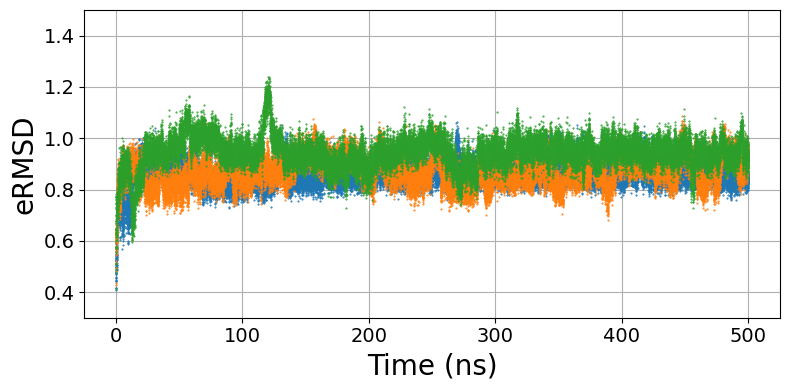

In [91]:
plt.figure(figsize=(8, 4))
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_s1[1:int(n_frames/3)],'.',ms=1,label="Run1")
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_s1[int(n_frames/3)+1:int(2*n_frames/3)],'.',ms=1,label="Run2")
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_s1[int(2*n_frames/3)+1:int(n_frames)],'.',ms=1,label="Run3")
plt.xlabel('Time (ns)', fontsize=20)
plt.ylabel('eRMSD', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.subplots_adjust(bottom=0.15, top=0.9, left=0.15, right=0.9)
plt.ylim(0.3,1.5)
plt.tight_layout()
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/eRMSD_unb_polyA.png', dpi=300)
plt.show()

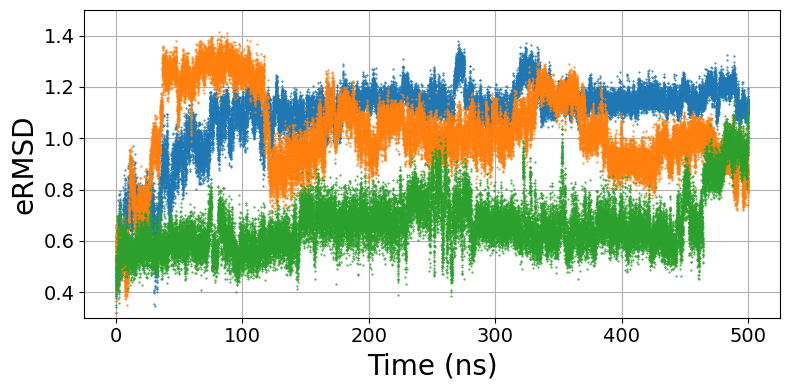

In [92]:
plt.figure(figsize=(8, 4))
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_s2[1:int(n_frames/3)],'.',ms=1,label="Run1")
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_s2[int(n_frames/3)+1:int(2*n_frames/3)],'.',ms=1,label="Run2")
plt.plot(np.arange(1,int(n_frames/3))/100, ermsd_mine1_unb_s2[int(2*n_frames/3)+1:int(n_frames)],'.',ms=1,label="Run3")
plt.xlabel('Time (ns)', fontsize=20)
plt.ylabel('eRMSD', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.subplots_adjust(bottom=0.15, top=0.9, left=0.15, right=0.9)
plt.ylim(0.3,1.5)
plt.tight_layout()
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/eRMSD_unb_polyA.png', dpi=300)
plt.show()

In [94]:
n_frames_hrex=traj_hrex_s1.n_frames

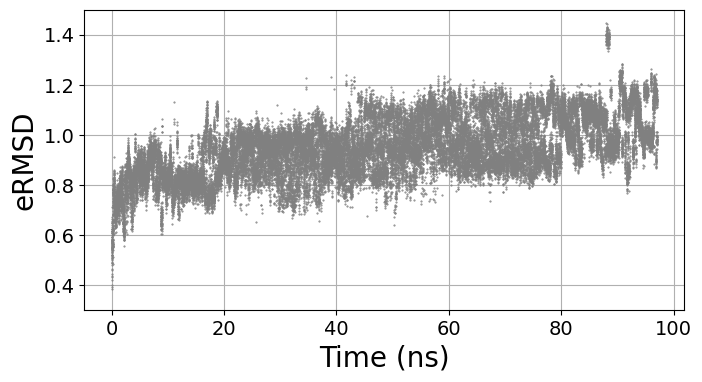

In [95]:
plt.figure(figsize=(8, 4))
plt.plot(np.linspace(0,97,n_frames_hrex-1), ermsd_mine1_hrex_s1[1:],'.',ms=1,label="hrex",color="gray")
plt.xlabel('Time (ns)', fontsize=20)
plt.ylabel('eRMSD', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.subplots_adjust(bottom=0.15, top=0.9, left=0.15, right=0.9)
plt.ylim(0.3,1.5)
#plt.savefig('/home/riccardo/Desktop/Immagini_clusters_Mattia/eRMSD hrex site1.tiff', dpi=300)
plt.grid()
plt.show()

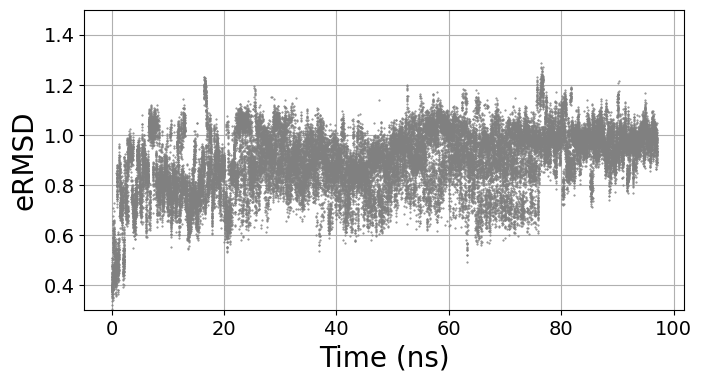

In [96]:
plt.figure(figsize=(8, 4))
plt.plot(np.linspace(0,97,n_frames_hrex-1), ermsd_mine1_hrex_s2[1:],'.',ms=1,label="hrex",color="gray")
plt.xlabel('Time (ns)', fontsize=20)
plt.ylabel('eRMSD', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.subplots_adjust(bottom=0.15, top=0.9, left=0.15, right=0.9)
plt.ylim(0.3,1.5)
#plt.savefig('/home/riccardo/Desktop/Immagini_clusters_Mattia/eRMSD hrex site1.tiff', dpi=300)
plt.grid()
plt.show()

In [19]:
gvec1_tot_s1,seq1_tot_s1 = bb.dump_gvec(trj_tot_s1,topology=top_s1)
gvec1_tot_s1.shape
gvec1_tot_s1 = gvec1_tot_s1.reshape(gvec1_tot_s1.shape[0],-1)
print(gvec1_tot_s1.shape)
reference_gvec1_tot_s1,reference_seq1_tot_s1=bb.dump_gvec(native_unb_s1)
reference_gvec1_tot_s1 = reference_gvec1_tot_s1.reshape(reference_gvec1_tot_s1.shape[0],-1)
print(reference_gvec1_tot_s1.shape)
ermsd_mine1_tot_s1=sp.spatial.distance_matrix(reference_gvec1_tot_s1,gvec1_tot_s1)[0]/np.sqrt(len(site_1_resids))

# Loading traj_cat_RNA_tot_skip10unb_skip2hrex_s1.xtc 


(63215, 2304)
(1, 2304)


# Loading reference_unb_s1.pdb 


In [20]:
reference_gvec1_crystal_s1,reference_seq1_crystal_s1=bb.dump_gvec(native_crystal_s1)
reference_gvec1_crystal_s1 = reference_gvec1_crystal_s1.reshape(reference_gvec1_crystal_s1.shape[0],-1)
print(reference_gvec1_crystal_s1.shape)
ermsd_mine1_crystal_s1=sp.spatial.distance_matrix(reference_gvec1_crystal_s1,reference_gvec1_crystal_s1)[0]/np.sqrt(len(site_1_resids))

(1, 2304)


# Loading em_RNA_s1.pdb 


In [11]:
gvec1_tot_s2,seq1_tot_s2 = bb.dump_gvec(trj_tot_s2,topology=top_s2)
gvec1_tot_s2.shape
gvec1_tot_s2 = gvec1_tot_s2.reshape(gvec1_tot_s2.shape[0],-1)
print(gvec1_tot_s2.shape)
reference_gvec1_tot_s2,reference_seq1_tot_s2=bb.dump_gvec(native_unb_s2)
reference_gvec1_tot_s2 = reference_gvec1_tot_s2.reshape(reference_gvec1_tot_s2.shape[0],-1)
print(reference_gvec1_tot_s2.shape)
ermsd_mine1_tot_s2=sp.spatial.distance_matrix(reference_gvec1_tot_s2,gvec1_tot_s2)[0]/np.sqrt(len(site_2_resids))

# Loading traj_cat_RNA_tot_skip10unb_skip2hrex_s2.xtc 


(63215, 900)
(1, 900)


# Loading reference_unb_s2.pdb 


In [12]:
reference_gvec1_crystal_s2,reference_seq1_crystal_s2=bb.dump_gvec(native_crystal_s2)
reference_gvec1_crystal_s2 = reference_gvec1_crystal_s2.reshape(reference_gvec1_crystal_s2.shape[0],-1)
print(reference_gvec1_crystal_s2.shape)
ermsd_mine1_crystal_s2=sp.spatial.distance_matrix(reference_gvec1_crystal_s2,reference_gvec1_crystal_s2)[0]/np.sqrt(len(site_2_resids))

(1, 900)


# Loading em_RNA_s2.pdb 


In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_tot_s1.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_tot_s1, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_tot_s1.pkl", "rb") as f:
    ermsd_mine1_tot_s1 = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_crystal_s1.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_crystal_s1, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_crystal_s1.pkl", "rb") as f:
    ermsd_mine1_crystal_s1 = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_tot_s2.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_tot_s2, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_tot_s2.pkl", "rb") as f:
    ermsd_mine1_tot_s2 = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mine1_crystal_s2.pkl", "wb") as f:
#    pickle.dump(ermsd_mine1_crystal_s2, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mine1_crystal_s2.pkl", "rb") as f:
    ermsd_mine1_crystal_s2 = pickle.load(f)

In [21]:
pca_tot_s1 = PCA(n_components=2)
converted_data_tot_s1 = pca_tot_s1.fit_transform(gvec1_tot_s1)
pca_tot_s1.explained_variance_ratio_

array([0.21989278, 0.06621394])

In [22]:
features_crystal_s1=pca_tot_s1.transform(reference_gvec1_crystal_s1)

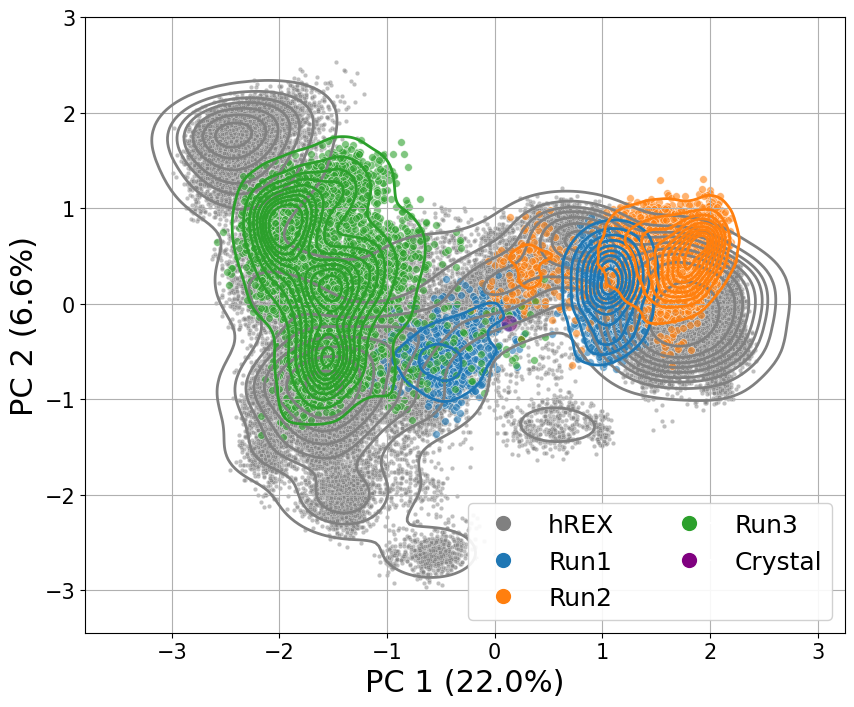

In [23]:
test_pca_tot_s1=pd.DataFrame(converted_data_tot_s1[:,:2],columns=["PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),"PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1))])
test_pca_crystal_s1=pd.DataFrame(features_crystal_s1[:,:2],columns=["PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),"PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1))])
fig,ax=plt.subplots(figsize=(9.8,8))
sns.kdeplot(data=test_pca_tot_s1.loc[15003:],x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="gray",linewidths=2)
sns.kdeplot(data=test_pca_tot_s1.loc[:5001],x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)
sns.kdeplot(data=test_pca_tot_s1.loc[5001:10002],x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)
sns.kdeplot(data=test_pca_tot_s1.loc[10002:15003],x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)
sns.scatterplot(data=test_pca_tot_s1.loc[15003:],x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.5,color="gray",s=10)
sns.scatterplot(data=test_pca_tot_s1.loc[:5001],x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_tot_s1.loc[5001:10002],x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_tot_s1.loc[10002:15003],x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_crystal_s1,x="PC1 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="purple",s=150,alpha=0.5)
plt.xlabel("PC 1 (%s%%)"%np.around(pca_tot_s1.explained_variance_ratio_[0]*100,decimals=1), fontsize=22)
plt.ylabel("PC 2 (%s%%)"%np.around(pca_tot_s1.explained_variance_ratio_[1]*100,decimals=1), fontsize=22)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='hREX',
           markerfacecolor='gray', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run1',
           markerfacecolor='C0', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run2',
           markerfacecolor='C1', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run3',
           markerfacecolor='C2', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Crystal',
           markerfacecolor='purple', markersize=12)
]

ax.legend(handles=legend_elements, loc='lower right', fontsize=18,frameon=True, framealpha=0.9, ncol=2)
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/PCA_malat_s1.tiff', dpi=300, bbox_inches='tight')
plt.show()

In [24]:
pca_tot_s2 = PCA(n_components=2)
converted_data_tot_s2 = pca_tot_s2.fit_transform(gvec1_tot_s2)
pca_tot_s2.explained_variance_ratio_

array([0.21695673, 0.17014894])

In [25]:
features_crystal_s2=pca_tot_s2.transform(reference_gvec1_crystal_s2)

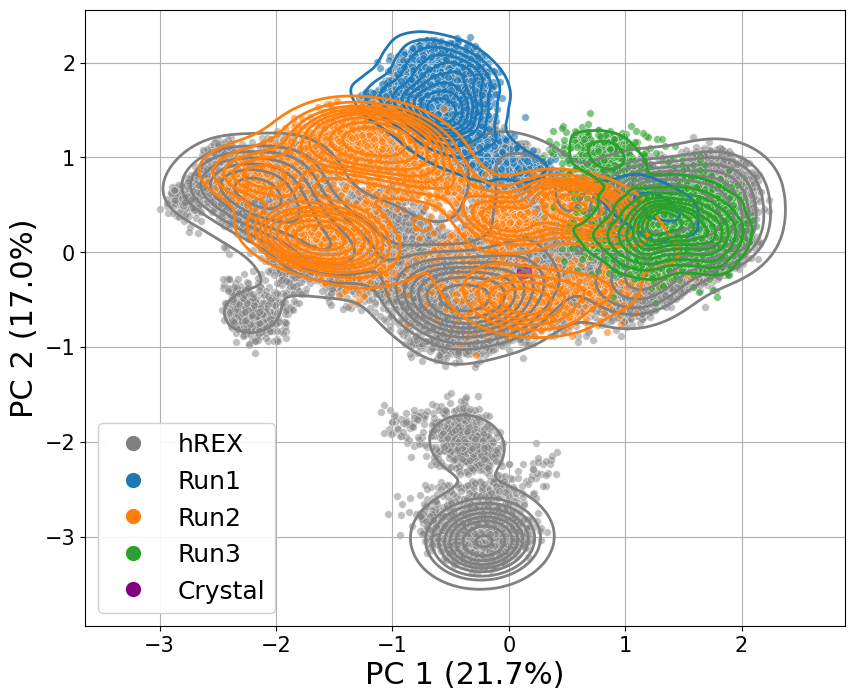

In [26]:
test_pca_tot_s2=pd.DataFrame(converted_data_tot_s2[:,:2],columns=["PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),"PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1))])
test_pca_crystal_s2=pd.DataFrame(features_crystal_s1[:,:2],columns=["PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),"PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1))])
fig,ax=plt.subplots(figsize=(9.8,8))
sns.kdeplot(data=test_pca_tot_s2.loc[15003:],x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="gray",linewidths=2)
sns.kdeplot(data=test_pca_tot_s2.loc[:5001],x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)
sns.kdeplot(data=test_pca_tot_s2.loc[5001:10002],x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)
sns.kdeplot(data=test_pca_tot_s2.loc[10002:15003],x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,linewidths=2)
sns.scatterplot(data=test_pca_tot_s2.loc[15003:],x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.5,s=30,color="gray")
sns.scatterplot(data=test_pca_tot_s2.loc[:5001],x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_tot_s2.loc[5001:10002],x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_tot_s2.loc[10002:15003],x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,alpha=0.6,s=30)
sns.scatterplot(data=test_pca_crystal_s2,x="PC1 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1)),y="PC2 ({}%)".format(np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1)),ax=ax,color="purple",s=150,alpha=0.5)
plt.xlabel("PC 1 (%s%%)"%np.around(pca_tot_s2.explained_variance_ratio_[0]*100,decimals=1), fontsize=22)
plt.ylabel("PC 2 (%s%%)"%np.around(pca_tot_s2.explained_variance_ratio_[1]*100,decimals=1), fontsize=22)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.grid()
# legenda custom in basso a destra
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='hREX',
           markerfacecolor='gray', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run1',
           markerfacecolor='C0', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run2',
           markerfacecolor='C1', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Run3',
           markerfacecolor='C2', markersize=12),
    Line2D([0], [0], marker='o', color='w', label='Crystal',
           markerfacecolor='purple', markersize=12)
]
ax.legend(handles=legend_elements, loc='lower left', fontsize=18,frameon=True, framealpha=0.9)
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/PCA_malat_s2.tiff', dpi=300, bbox_inches='tight')
plt.show()

## Centroids RMSD and eRMSD matrixes

Here you can find the complete workflow used to compute the filtered RMSD and eRMSD matrices for both binding site and to generate the centroid ensemble

In [27]:
skip="2"
threshold="0.7"

In [40]:
traj_hrex_malat_2=mdt.load('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/traj_cat_RNA_whole_center_mol_skip{}.xtc'.format(skip),top='/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/em_RNA.pdb')

In [ ]:
#centroids_s1=pickle.load(open(path_data+"data_trj/centroids.dat_{}_site1".format(threshold,threshold), "rb"))
#centroids_s2=pickle.load(open(path_data+"data_trj/centroids.dat_{}_site2".format(threshold,threshold), "rb"))

In [ ]:
traj_hrex_malat_5_s1 = mdt.load('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_{}_s1.xtc'.format(skip,threshold), top=path_data+"data_trj/npt2_RNA_whole_center_mol.pdb")
traj_hrex_malat_5_s2 = mdt.load('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_{}_s2.xtc'.format(skip,threshold), top=path_data+"data_trj/npt2_RNA_whole_center_mol.pdb")
reference = mdt.load('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/npt2_RNA_whole_center_mol.pdb')
top_hrex_malat_5='/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/npt2_RNA_whole_center_mol.pdb'
trj_hrex_malat_5_s1 = '/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_{}_s1.xtc'.format(skip,threshold)
native_hrex_malat_5 = path_data+"data_trj/npt2_RNA_whole_center_mol.pdb"
trj_hrex_malat_5_s2 = '/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_{}_s2.xtc'.format(skip,threshold) 

In [142]:
sel_noh_s1 = reference.top.select('residue 3 4 5 6 7 47 49 50 51 52 53 54 56 57 58 59 60 61 62 63 64 65 66 67 and not element H')
traj_hrex_malat_5_s1.superpose(reference, frame=0, atom_indices=sel_noh_s1)
sel_noh_s2 = reference.top.select('residue 9 10 11 12 13 14 40 41 67 68 69 70 71 72 73 and not element H')
traj_hrex_malat_5_s2.superpose(reference, frame=0, atom_indices=sel_noh_s2)

<mdtraj.Trajectory with 88 frames, 2355 atoms, 74 residues, and unitcells at 0x79459d656dc0>

In [143]:
gvec_centroids_5_s1,seq_centroids_5_s1 = bb.dump_gvec(trj_hrex_malat_5_s1,topology=native_hrex_malat_5)
gvec_centroids_5_s2,seq_centroids_5_s2 = bb.dump_gvec(trj_hrex_malat_5_s2,topology=native_hrex_malat_5)
gvec_centroids_5_s1 = gvec_centroids_5_s1[:,site_1_resids][:,:,site_1_resids].reshape(gvec_centroids_5_s1[:,site_1_resids][:,:,site_1_resids].shape[0],-1)
gvec_centroids_5_s2 = gvec_centroids_5_s2[:,site_2_resids][:,:,site_2_resids].reshape(gvec_centroids_5_s2[:,site_2_resids][:,:,site_2_resids].shape[0],-1)

# Loading /media/francy/Storage/raguti/file4ric/analysis_hrex/ensamble_centroids_skip2_0.7_s1.xtc 
# Loading /media/francy/Storage/raguti/file4ric/analysis_hrex/ensamble_centroids_skip2_0.7_s2.xtc 


In [144]:
ermsd_mat_centroids_s1 = squareform(pdist(gvec_centroids_5_s1))/np.sqrt(len(site_1_resids)) # eRMSD matrix
ermsd_mat_centroids_s2 = squareform(pdist(gvec_centroids_5_s2))/np.sqrt(len(site_2_resids)) 

In [145]:
traj_hrex_malat_5_s1.superpose(reference, frame=0, atom_indices=sel_noh_s1)
traj_hrex_malat_5_s2.superpose(reference, frame=0, atom_indices=sel_noh_s2)

<mdtraj.Trajectory with 88 frames, 2355 atoms, 74 residues, and unitcells at 0x79459d656dc0>

In [ ]:
dict_ermsd_s1={}
index_centroids_filtered=[]
for i in range(0,len(ermsd_mat_centroids_s1)):
    for j in range(0,len(ermsd_mat_centroids_s1)):
        if i>j and i not in index_centroids_filtered and j not in index_centroids_filtered:
            dict_ermsd_s1["Frame {} {}".format(i,j)]=ermsd_mat_centroids_s1[i][j]
            if ermsd_mat_centroids_s1[i][j]<0.8:
                if i>j:
                        index_centroids_filtered.append(i)
                else:
                        index_centroids_filtered.append(j)

[3, 6, 7, 9, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 39, 40, 41, 42, 43, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 79, 80, 82, 84, 85, 86, 87, 88, 89, 91, 92, 93, 95, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 111, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154]


In [ ]:
dict_ermsd_s1={}
for i in range(0,len(ermsd_mat_centroids_s1)):
    for j in range(0,len(ermsd_mat_centroids_s1)):
        if i>j:
            dict_ermsd_s1["Frame {} {}".format(i,j)]=ermsd_mat_centroids_s1[i][j]
sorted_values = sorted(dict_ermsd_s1.values())
sorted_dict_s1={}
for i in range(0,len(sorted_values)):
    for key, value in dict_ermsd_s1.items():
        if value == sorted_values[i]:
            sorted_dict_s1[key]= value
            break

{'Frame 155 28': 0.45454856230973617, 'Frame 146 7': 0.4556515712780718, 'Frame 49 0': 0.47701207966814263, 'Frame 131 2': 0.4778820942412727, 'Frame 143 4': 0.4809389812340617, 'Frame 67 9': 0.48481745962692957, 'Frame 83 6': 0.48825276898553804, 'Frame 18 7': 0.4954370852686812, 'Frame 108 32': 0.49579273697912396, 'Frame 63 0': 0.4959215286583148, 'Frame 76 6': 0.5001603188354893, 'Frame 93 1': 0.5003050772318792, 'Frame 51 7': 0.5024406909481035, 'Frame 153 27': 0.5052683035924215, 'Frame 92 1': 0.5059146057789194, 'Frame 116 3': 0.506044329378199, 'Frame 47 5': 0.5061858321314423, 'Frame 103 3': 0.5073090878375559, 'Frame 154 24': 0.509586527926437, 'Frame 112 14': 0.512698559736314, 'Frame 35 16': 0.5147004115468123, 'Frame 135 51': 0.5151205532562012, 'Frame 64 16': 0.5170840892567335, 'Frame 89 20': 0.5190423686062853, 'Frame 133 57': 0.5198232911801473, 'Frame 26 3': 0.5238469932880961, 'Frame 41 8': 0.5244786706571907, 'Frame 141 21': 0.5251638208510485, 'Frame 77 4': 0.52516

In [148]:
array=np.arange(0,20)
array_filtrato = np.setdiff1d(array, index_centroids_filtered)
print(array_filtrato)
ermsd_mat_centroids_s1_filtered=ermsd_mat_centroids_s1[array_filtrato][:,array_filtrato]
ermsd_mat_centroids_s1_filtered.shape

[ 0  1  2  4  5  8 10 11 13 15]


(10, 10)

In [ ]:
dict_ermsd_s1_filtered={}
for i in range(0,len(ermsd_mat_centroids_s1_filtered)):
    for j in range(0,len(ermsd_mat_centroids_s1_filtered)):
        if i>j:
            dict_ermsd_s1_filtered["Frame {} {}".format(i,j)]=ermsd_mat_centroids_s1_filtered[i][j]
sorted_values = sorted(dict_ermsd_s1_filtered.values())
sorted_dict_s1={}
for i in range(0,len(sorted_values)):
    for key, value in dict_ermsd_s1_filtered.items():
        if value == sorted_values[i]:
            sorted_dict_s1[key]= value
            break

{'Frame 3 2': 0.8072228772966967, 'Frame 5 0': 0.8250028798752791, 'Frame 9 8': 0.8388652936800014, 'Frame 2 1': 0.8721364260195416, 'Frame 7 2': 0.8792263185615712, 'Frame 8 5': 0.8862416213463683, 'Frame 6 1': 0.886562249799785, 'Frame 3 1': 0.8872774499985858, 'Frame 6 2': 0.8972701752300299, 'Frame 7 3': 0.8973083757813661, 'Frame 7 1': 0.8980690063604538, 'Frame 6 3': 0.8982906185644549, 'Frame 6 4': 0.903618276106745, 'Frame 7 6': 0.9063468471711965, 'Frame 4 1': 0.9248730908439322, 'Frame 5 1': 0.9291658813073197, 'Frame 4 2': 0.9547192929584039, 'Frame 5 4': 0.9851368764144509, 'Frame 5 3': 1.000906538506333, 'Frame 7 5': 1.0021348412354985, 'Frame 1 0': 1.003096131720094, 'Frame 6 5': 1.0139760225914736, 'Frame 8 0': 1.0312123832841127, 'Frame 4 3': 1.036504146449525, 'Frame 9 5': 1.0453841860836557, 'Frame 4 0': 1.0491422274491364, 'Frame 7 4': 1.051942394175942, 'Frame 5 2': 1.0812055283662676, 'Frame 8 1': 1.1013043838934444, 'Frame 8 3': 1.1232047173483777, 'Frame 9 3': 1.

In [ ]:
#centroids_traj_hrex_malat_5_s1_filtered = traj_hrex_malat_2[centroids_s1[array_filtrato]]
#centroids_traj_hrex_malat_5_s1_filtered.save_xtc('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_{}_s1_filtered.xtc'.format(skip,threshold))

In [ ]:
dict_ermsd_s2={}
index_centroids_filtered=[]
for i in range(0,len(ermsd_mat_centroids_s2)):
    for j in range(0,len(ermsd_mat_centroids_s2)):
        if i>j and i not in index_centroids_filtered and j not in index_centroids_filtered:
            dict_ermsd_s2["Frame {} {}".format(i,j)]=ermsd_mat_centroids_s2[i][j]
            if ermsd_mat_centroids_s2[i][j]<0.8:
                print(i,j)
                if i>j:
                        index_centroids_filtered.append(i)
                else:
                        index_centroids_filtered.append(j)

2 0
3 0
5 0
6 4
7 0
8 0
9 0
10 0
11 4
13 1
15 14
16 14
17 12
18 14
19 0
20 0
21 4
22 0
23 4
24 4
26 4
27 0
28 4
29 12
30 12
31 0
32 14
33 0
34 0
35 4
36 0
37 4
38 4
39 4
40 0
41 0
42 4
43 4
44 0
45 4
46 4
47 4
48 0
49 4
50 4
51 4
52 0
53 4
54 4
55 0
56 1
58 1
59 0
60 4
61 0
62 4
63 14
64 0
65 4
66 14
67 4
68 0
69 4
70 14
71 12
72 14
73 1
74 4
75 0
76 0
77 0
78 4
79 0
80 4
81 0
82 4
83 0
84 25
85 0
86 4
87 0
[2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87]


In [ ]:
sorted_values = sorted(dict_ermsd_s2.values())
sorted_dict_s2={}
for i in range(0,len(sorted_values)):
    for key, value in dict_ermsd_s2.items():
        if value == sorted_values[i]:
            sorted_dict_s2[key]= value
            break

{'Frame 58 1': 0.39453793625541955, 'Frame 20 0': 0.41144450502764024, 'Frame 46 4': 0.4629550540390987, 'Frame 68 0': 0.4730891362730404, 'Frame 56 1': 0.47588910180711264, 'Frame 23 4': 0.4770682876855294, 'Frame 44 0': 0.48202508089532514, 'Frame 73 1': 0.48643695218674377, 'Frame 35 4': 0.4876609168503687, 'Frame 40 0': 0.48955379756549494, 'Frame 54 4': 0.49158192319984273, 'Frame 6 4': 0.5019726022076968, 'Frame 61 0': 0.5026129546455674, 'Frame 34 0': 0.5057189019835795, 'Frame 11 4': 0.5175880327654084, 'Frame 36 0': 0.5192070717023438, 'Frame 24 4': 0.5254378468799504, 'Frame 76 0': 0.527157002701279, 'Frame 22 0': 0.5396133573117738, 'Frame 71 12': 0.5503570097645993, 'Frame 21 4': 0.5552751043105815, 'Frame 38 4': 0.5645341917462953, 'Frame 85 0': 0.5910995458297901, 'Frame 8 0': 0.5939702875018384, 'Frame 69 4': 0.5987367145702237, 'Frame 82 4': 0.6038035973758309, 'Frame 51 4': 0.6166295213403775, 'Frame 83 0': 0.6181272136865967, 'Frame 74 4': 0.620826498141835, 'Frame 79

In [ ]:
array=np.arange(0,20)
array_filtrato = np.setdiff1d(array, index_centroids_filtered)
ermsd_mat_centroids_s2_filtered=ermsd_mat_centroids_s2[array_filtrato][:,array_filtrato]
ermsd_mat_centroids_s2_filtered.shape

[ 0  1  4 12 14]


(5, 5)

In [ ]:
dict_ermsd_s2_filtered={}
for i in range(0,len(ermsd_mat_centroids_s2_filtered)):
    for j in range(0,len(ermsd_mat_centroids_s2_filtered)):
        if i>j:
            dict_ermsd_s2_filtered["Frame {} {}".format(i,j)]=ermsd_mat_centroids_s2_filtered[i][j]
sorted_values = sorted(dict_ermsd_s2_filtered.values())
sorted_dict_s2={}
for i in range(0,len(sorted_values)):
    for key, value in dict_ermsd_s2_filtered.items():
        if value == sorted_values[i]:
            sorted_dict_s2[key]= value
            break

{'Frame 3 0': 0.8331844778298167, 'Frame 4 2': 0.8522301526082585, 'Frame 4 0': 0.8850539041831856, 'Frame 4 3': 0.913893220542571, 'Frame 4 1': 0.9475058498813946, 'Frame 2 0': 1.0448301333210068, 'Frame 3 1': 1.0678838453265436, 'Frame 3 2': 1.1037547754525334, 'Frame 1 0': 1.1236748019120848, 'Frame 2 1': 1.1753781398093992}


In [ ]:
#centroids_traj_hrex_malat_2_s2_filtered = traj_hrex_malat_2[centroids_s2[array_filtrato]]
#centroids_traj_hrex_malat_2_s2_filtered.save_xtc('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_{}_s2_filtered.xtc'.format(skip,threshold))

In [ ]:
top_filtered='/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/npt2_RNA_whole_center_mol.pdb'
native = path_data+"data_trj/em_RNA.pdb"
reference = mdt.load('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/em_RNA.pdb')

traj_hrex_malat_2_s1_filtered_07 = mdt.load('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_0.7_s1_filtered.xtc'.format(skip), top=path_data+"data_trj/npt2_RNA_whole_center_mol.pdb")
traj_hrex_malat_2_s2_filtered_07 = mdt.load('/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_0.7_s2_filtered.xtc'.format(skip), top=path_data+"data_trj/npt2_RNA_whole_center_mol.pdb")
traj_hrex_malat_2_s1_filtered_07.superpose(reference, frame=0, atom_indices=sel_noh_s1)
traj_hrex_malat_2_s2_filtered_07.superpose(reference, frame=0, atom_indices=sel_noh_s2)
trj_s1_filtered_07 = '/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_0.7_s1_filtered.xtc'.format(skip)   
trj_s2_filtered_07 = '/media/francy/Storage/raguti/file4ric/Github_malat/data_trj/ensamble_centroids_skip{}_0.7_s2_filtered.xtc'.format(skip)

In [156]:
n_frames = traj_hrex_malat_2_s1_filtered_07.n_frames
rmsd_centroids_s1_filtered_07 = np.zeros((n_frames, n_frames))
for i in range(traj_hrex_malat_2_s1_filtered_07.n_frames):
    rmsd_centroids_s1_filtered_07[i] = mdt.rmsd(traj_hrex_malat_2_s1_filtered_07, traj_hrex_malat_2_s1_filtered_07, i, atom_indices=sel_noh_s1)

In [157]:
n_frames = traj_hrex_malat_2_s2_filtered_07.n_frames
rmsd_centroids_s2_filtered_07 = np.zeros((n_frames, n_frames))
for i in range(traj_hrex_malat_2_s2_filtered_07.n_frames):
    rmsd_centroids_s2_filtered_07[i] = mdt.rmsd(traj_hrex_malat_2_s2_filtered_07, traj_hrex_malat_2_s2_filtered_07, i, atom_indices=sel_noh_s2)

In [158]:
gvec1_filtered_07,seq1_filtered_07 = bb.dump_gvec(trj_s1_filtered_07,topology=top_filtered)
gvec1_filtered_07.shape
gvec1_s1_filtered_07 = gvec1_filtered_07[:,site_1_resids][:,:,site_1_resids].reshape(gvec1_filtered_07[:,site_1_resids][:,:,site_1_resids].shape[0],-1)
gvec1_s1_filtered_07 = gvec1_s1_filtered_07.reshape(gvec1_s1_filtered_07.shape[0],-1)
print(gvec1_s1_filtered_07.shape)
reference_gvec1_filtered_07,reference_seq1_filtered_07=bb.dump_gvec(native)
reference_gvec1_s1_filtered_07=reference_gvec1_filtered_07[:,site_1_resids][:,:,site_1_resids].reshape(reference_gvec1_filtered_07[:,site_1_resids][:,:,site_1_resids].shape[0],-1)
reference_gvec1_s1_filtered_07 = reference_gvec1_s1_filtered_07.reshape(reference_gvec1_s1_filtered_07.shape[0],-1)
print(reference_gvec1_s1_filtered_07.shape)
ermsd_mine1_s1_filtered_07=sp.spatial.distance_matrix(reference_gvec1_s1_filtered_07,gvec1_s1_filtered_07)[0]/np.sqrt(len(site_1_resids))

(10, 2304)
(1, 2304)


# Loading /media/francy/Storage/raguti/file4ric/analysis_hrex/ensamble_centroids_skip2_0.7_s1_filtered.xtc 
# Loading /media/francy/Storage/raguti/file4ric/analysis_hrex/em_RNA.pdb 


In [159]:
gvec1_filtered_07,seq1_filtered_07 = bb.dump_gvec(trj_s2_filtered_07,topology=top_filtered)
gvec1_filtered_07.shape
gvec1_s2_filtered_07 = gvec1_filtered_07[:,site_2_resids][:,:,site_2_resids].reshape(gvec1_filtered_07[:,site_2_resids][:,:,site_2_resids].shape[0],-1)
gvec1_s2_filtered_07 = gvec1_s2_filtered_07.reshape(gvec1_s2_filtered_07.shape[0],-1)
print(gvec1_s2_filtered_07.shape)
reference_gvec1_filtered_07,reference_seq1_filtered_07=bb.dump_gvec(native)
reference_gvec1_s2_filtered_07=reference_gvec1_filtered_07[:,site_2_resids][:,:,site_2_resids].reshape(reference_gvec1_filtered_07[:,site_2_resids][:,:,site_2_resids].shape[0],-1)
reference_gvec1_s2_filtered_07 = reference_gvec1_s2_filtered_07.reshape(reference_gvec1_s2_filtered_07.shape[0],-1)
print(reference_gvec1_s2_filtered_07.shape)
ermsd_mine1_s2_filtered_07=sp.spatial.distance_matrix(reference_gvec1_s2_filtered_07,gvec1_s2_filtered_07)[0]/np.sqrt(len(site_2_resids))

# Loading /media/francy/Storage/raguti/file4ric/analysis_hrex/ensamble_centroids_skip2_0.7_s2_filtered.xtc 


(5, 900)
(1, 900)


# Loading /media/francy/Storage/raguti/file4ric/analysis_hrex/em_RNA.pdb 


In [160]:
ermsd_mat_centroids_s1_filtered_07 = squareform(pdist(gvec1_s1_filtered_07))/np.sqrt(len(site_1_resids)) 
ermsd_mat_centroids_s2_filtered_07 = squareform(pdist(gvec1_s2_filtered_07))/np.sqrt(len(site_2_resids)) 

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mat_centroids_s1_filtered_07.pkl", "wb") as f:
#    pickle.dump(ermsd_mat_centroids_s1_filtered_07, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mat_centroids_s1_filtered_07.pkl", "rb") as f:
    ermsd_mat_centroids_s1_filtered_07 = pickle.load(f)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/ermsd_mat_centroids_s2_filtered_07.pkl", "wb") as f:
#    pickle.dump(ermsd_mat_centroids_s2_filtered_07, f)

# --- Load ---
with open(path_data+"data_plots/ermsd_mat_centroids_s2_filtered_07.pkl", "rb") as f:
    ermsd_mat_centroids_s2_filtered_07 = pickle.load(f)

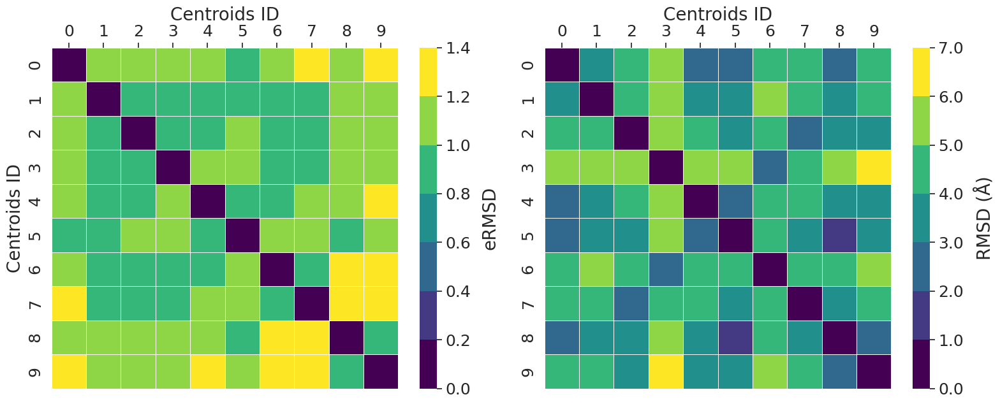

In [161]:
import matplotlib
values = np.arange(0, 0.2 + np.max(ermsd_mat_centroids_s1_filtered_07) + 0.2 - np.max(ermsd_mat_centroids_s1_filtered_07) % 0.2, 0.2)
cmap = plt.cm.viridis
cmaplist = [cmap(i) for i in range(cmap.N)]
cmap = matplotlib.colors.LinearSegmentedColormap.from_list('Custom cmap', cmaplist, cmap.N)
bounds = np.linspace(0, np.max(ermsd_mat_centroids_s1_filtered_07) + 0.2 - np.max(ermsd_mat_centroids_s1_filtered_07) % 0.2, len(values))
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)
data = pd.DataFrame(ermsd_mat_centroids_s1_filtered_07)

sns.set()
plt.figure(figsize=(16, 6.5))

plt.subplot(1, 2, 1)
ax1 = sns.heatmap(data, cmap=cmap, norm=norm, annot=False,
                  cbar_kws={'ticks': values, 'format': '%.1f'}, linewidth=0.5)
cbar1 = ax1.collections[0].colorbar
cbar1.set_ticks(values)
cbar1.set_ticklabels(['{:.1f}'.format(val) for val in values])
cbar1.ax.tick_params(labelsize=18)
cbar1.set_label('eRMSD', fontsize=20, labelpad=12)  

# Assi: etichetta sopra e a sinistra
ax1.tick_params(axis='x', which='both', bottom=False, top=True, labelbottom=False, labeltop=True)
ax1.tick_params(axis='both', which='major', labelsize=18)
ax1.set_ylabel('Centroids ID', fontsize=20)
ax1.set_xlabel('Centroids ID', fontsize=20)
ax1.xaxis.set_label_position('top') 

plt.subplot(1, 2, 2)
values = np.arange(0, 1 + np.max(rmsd_centroids_s1_filtered_07*10) + 1 - np.max(rmsd_centroids_s1_filtered_07*10) % 1, 1)
cmap = plt.cm.viridis
cmaplist = [cmap(i) for i in range(cmap.N)]
cmap = matplotlib.colors.LinearSegmentedColormap.from_list('Custom cmap', cmaplist, cmap.N)
bounds = np.linspace(0, np.max(rmsd_centroids_s1_filtered_07*10) + 1 - np.max(rmsd_centroids_s1_filtered_07*10) % 1, len(values))
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)
data = pd.DataFrame(rmsd_centroids_s1_filtered_07*10)

ax2 = sns.heatmap(data, cmap=cmap, norm=norm, annot=False,
                  cbar_kws={'ticks': values, 'format': '%.1f'}, linewidth=0.5)
cbar2 = ax2.collections[0].colorbar
cbar2.set_ticks(values)
cbar2.set_ticklabels(['{:.1f}'.format(val) for val in values])
cbar2.ax.tick_params(labelsize=18)
cbar2.set_label('RMSD (Å)', fontsize=20, labelpad=12)

# Assi: etichetta SOLO sopra
ax2.tick_params(axis='x', which='both', bottom=False, top=True, labelbottom=False, labeltop=True)
ax2.tick_params(axis='both', which='major', labelsize=18)
ax2.set_ylabel('')  
ax2.set_xlabel('Centroids ID', fontsize=20)
ax2.xaxis.set_label_position('top')

plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/RMSD RNA matrix site1 filtered 0.7.tiff', dpi=300)
plt.show()

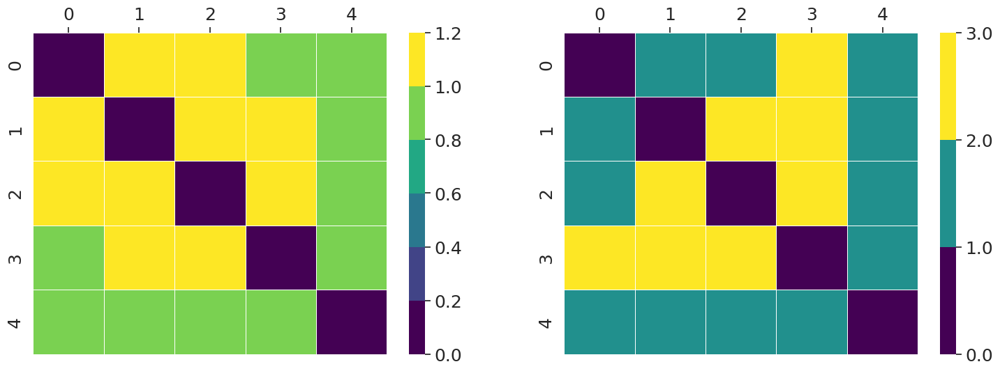

In [162]:
plt.figure(figsize=(18, 6))

plt.subplot(1,2,1)
values = np.arange(0, 0.2 + np.max(ermsd_mat_centroids_s2_filtered_07) + 0.2 - np.max(ermsd_mat_centroids_s2_filtered_07) % 0.2, 0.2)
cmap = plt.cm.viridis
cmaplist = [cmap(i) for i in range(cmap.N)]
cmap = matplotlib.colors.LinearSegmentedColormap.from_list('Custom cmap', cmaplist, cmap.N)
bounds = np.linspace(0, np.max(ermsd_mat_centroids_s2_filtered_07) + 0.2 - np.max(ermsd_mat_centroids_s2_filtered_07) % 0.2, len(values))
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)
data = pd.DataFrame(ermsd_mat_centroids_s2_filtered_07)
sns.set()
ax = sns.heatmap(data, cmap=cmap, norm=norm, annot=False, cbar_kws={'ticks': values, 'format': '%.1f'},linewidth=0.5)
cbar = ax.collections[0].colorbar
cbar.set_ticks(values)
cbar.set_ticklabels(['{:.1f}'.format(val) for val in values])
plt.tick_params(axis='x', which='both', bottom=False, top=True,labelbottom=False,labeltop=True)
plt.tick_params(axis='both', which='major', labelsize=18)
cbar.ax.tick_params(labelsize=18)
#plt.title('eRMSD RNA matrix site2 filtered 0.7', fontsize=20)
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/eRMSD RNA matrix site2 filtered 0.7.tiff', dpi=300)

plt.subplot(1,2,2)
values = np.arange(0, 1 + np.max(rmsd_centroids_s2_filtered_07*10) + 1 - np.max(rmsd_centroids_s2_filtered_07*10) % 1, 1)
cmap = plt.cm.viridis
cmaplist = [cmap(i) for i in range(cmap.N)]
cmap = matplotlib.colors.LinearSegmentedColormap.from_list('Custom cmap', cmaplist, cmap.N)
bounds = np.linspace(0, np.max(rmsd_centroids_s2_filtered_07*10) + 1 - np.max(rmsd_centroids_s2_filtered_07*10) % 1, len(values))
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)
data = pd.DataFrame(rmsd_centroids_s2_filtered_07*10)
sns.set()
ax = sns.heatmap(data, cmap=cmap, norm=norm, annot=False, cbar_kws={'ticks': values, 'format': '%.1f'},linewidth=0.5)
cbar = ax.collections[0].colorbar
cbar.set_ticks(values)
cbar.set_ticklabels(['{:.1f}'.format(val) for val in values])
plt.tick_params(axis='x', which='both', bottom=False, top=True,labelbottom=False,labeltop=True)
plt.tick_params(axis='both', which='major', labelsize=18)
#plt.title('RMSD RNA matrix site2 filtered 0.7', fontsize=20)
cbar.ax.tick_params(labelsize=18)
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/RMSD RNA matrix site2 filtered 0.7.tiff', dpi=300)
plt.show()

## Docking Analysis

Here you can find all the docking results, including line plots of the scores obtained with the different scoring functions, the best-scoring pose for each conformation and the global top-scoring pose for both binding sites, as well as PCA plots of the poses generated with rDock and AutoDock for ligand P13.

In [ ]:
work_dir_site1=path_data+"data_docking/site1/"
work_dir_site2=path_data+"data_docking/site2/"
proteins_site2=['centroid_1','centroid_2','centroid_3','centroid_4','centroid_5','crystal']
proteins_site1=['centroid_1','centroid_2','centroid_3','centroid_4','centroid_5','centroid_6','centroid_7','centroid_8','centroid_9','centroid_10','crystal']
ligands=['m10', 'm15', 'm1', 'm22', 'm24', 'm3', 'm4', 'm7', 'o1', 'o2', 'o4', 'o5', 'o6', 'p13', 'p14', 'p17', 'p1', 'p5', 'p8', 'p9','p0']
poses=250
poses_soft=["adt","rdock"]
scor_funct=["adt","rdock","vina","ann","sprank"]

In [10]:
site_1_resids='resid 3 4 5 6 7 47 49 50 51 52 53 54 56 57 58 59 60 61 62 63 64 65 66 67'
site_2_resids='resid 9 10 11 12 13 14 40 41 67 68 69 70 71 72 73'
site_1_resids_start1='resid 2 3 4 5 6 46 48 49 50 51 52 53 55 56 57 58 59 60 61 62 63 64 65 66'
site_2_resids_start1='resid 8 9 10 11 12 13 39 40 66 67 68 69 70 71 72'

In [24]:
results_tot={}
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/autodock_gpu/rescore_autodock/results")
        scores=[]
        results=Chem.SDMolSupplier('results_min_{}.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("meeko").split()[1]))
        results_tot[(prot,"adt","adt",lig)]=scores

In [33]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/rdock/")
        scores=[]
        results=Chem.SDMolSupplier('results_rdock_{}.sd'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("SCORE").split()[0]))
        results_tot[(prot,"rdock","rdock",lig)]=scores

In [25]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/autodock_gpu/rescore_rdock/results")
        scores=[]
        results=Chem.SDMolSupplier('results_min_{}.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("SCORE").split()[0]))
        results_tot[(prot,"adt","rdock",lig)]=scores

In [26]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/rdock/rescore_autodock/results")
        scores=[]
        results=Chem.SDMolSupplier('results_min_{}.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("meeko").split()[1]))
        results_tot[(prot,"rdock","adt",lig)]=scores

In [ ]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/autodock_gpu/rescore_annapurna")
        scores=[]
        results=Chem.SDMolSupplier('annapurna_{}_output.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("AnnapuRNA Score")))
        results_tot[(prot,"adt","ann",lig)]=scores

In [ ]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/rdock/rescore_annapurna")
        scores=[]
        results=Chem.SDMolSupplier('annapurna_{}_output.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("AnnapuRNA Score")))
        results_tot[(prot,"rdock","ann",lig)]=scores

In [38]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/autodock_gpu/rescore_vina/results")
        results_tot[(prot,"adt","vina",lig)]=np.loadtxt("vina_score.txt").tolist()

In [ ]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/rdock/rescore_vina/results")
        results_tot[(prot,"rdock","vina",lig)]=np.loadtxt("vina_score.txt").tolist()

In [40]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/autodock_gpu/rescore_sprank")
        file=open("score.dat","r")
        temp=[]
        for line in file:
            line=line.split()
            if len(line)==4 and line[0]=="*****":
                temp.append(float(line[3]))
        results_tot[(prot,"adt","sprank",lig)]=temp

In [41]:
for prot in proteins_site1:
    for lig in ligands:
        os.chdir(work_dir_site1+prot+"/"+lig+"/rdock/rescore_sprank")
        file=open("score.dat","r")
        temp=[]
        for line in file:
            line=line.split()
            if len(line)==2 and line[0]=="#Scoring":
                line=file.readline()
                for i in range(0,250):
                    line=file.readline()
                    line=line.split()
                    temp.append(float(line[3]))
        results_tot[(prot,"rdock","sprank",lig)]=temp

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/results_tot_site1.pkl", "wb") as f:
#    pickle.dump(results_tot, f)

# --- Load ---
with open(path_data+"data_plots/results_tot_site1.pkl", "rb") as f:
    results_tot = pickle.load(f)

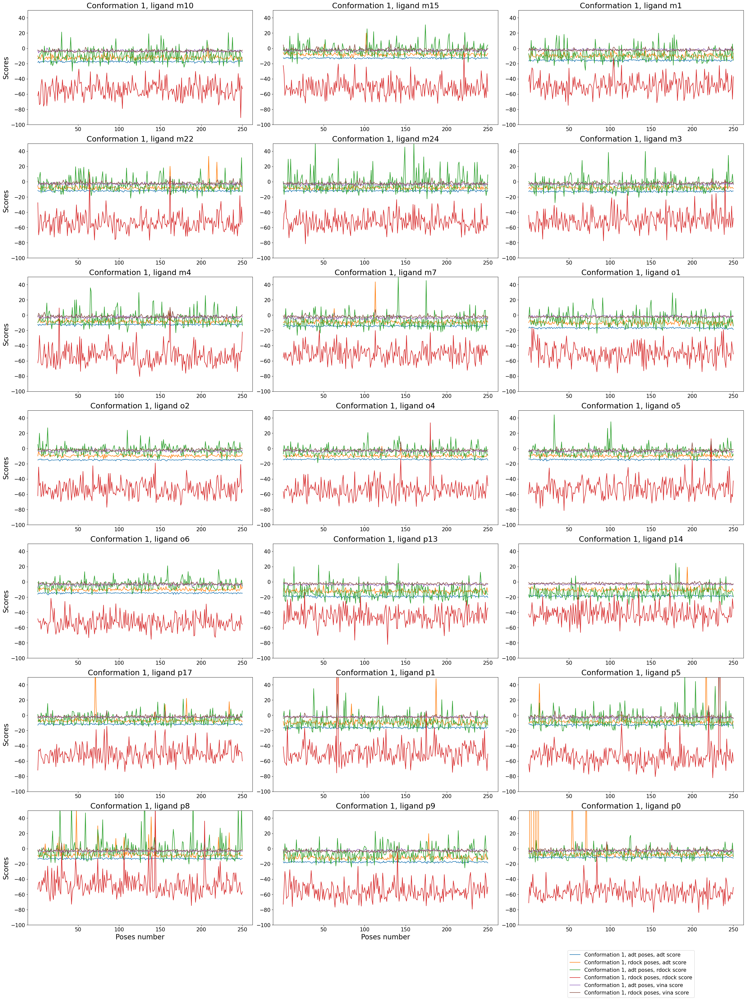

In [14]:
plt.style.use('default') 
#for prot in proteins_site1:      #uncomment this line for the analysis for all conformations
for prot in proteins_site1[0:1]:    #plot only results derived from first conformation
    plt.figure(figsize=(30,40))
    k=0
    for lig in ligands:
        plt.subplot(7,3,k+1)
        for j in scor_funct[0:3]:
            for i in poses_soft:
                plt.plot(np.linspace(1,len(results_tot[prot,"adt","adt","m10"]),len(results_tot[prot,"adt","adt","m10"])),results_tot[(prot,i,j,lig)],label="Conformation {}, {} poses, {} score".format(str(prot)[9:],i,j))
        if prot=="crystal":
            plt.title('Crystal, ligand {}'.format(lig), fontsize=22)
        else:
            plt.title('Conformation {}, ligand {}'.format(str(prot)[9:],lig), fontsize=22)
        plt.yticks(fontsize=15) 
        plt.ylim(-100,50)
        plt.xticks(range(50,251,50),fontsize=15)
        if k%3==0:
            plt.ylabel("Scores", fontsize=20)
        k+=1
        if lig=="p8" or lig=="p9" or lig=="p0" and prot=="crystal":
            plt.xlabel("Poses number", fontsize=20)
    
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),fontsize=15)
plt.tight_layout()
#plt.savefig('/home/riccardo/Desktop/score_ff_site1.png', dpi=300, bbox_inches='tight')
plt.show()

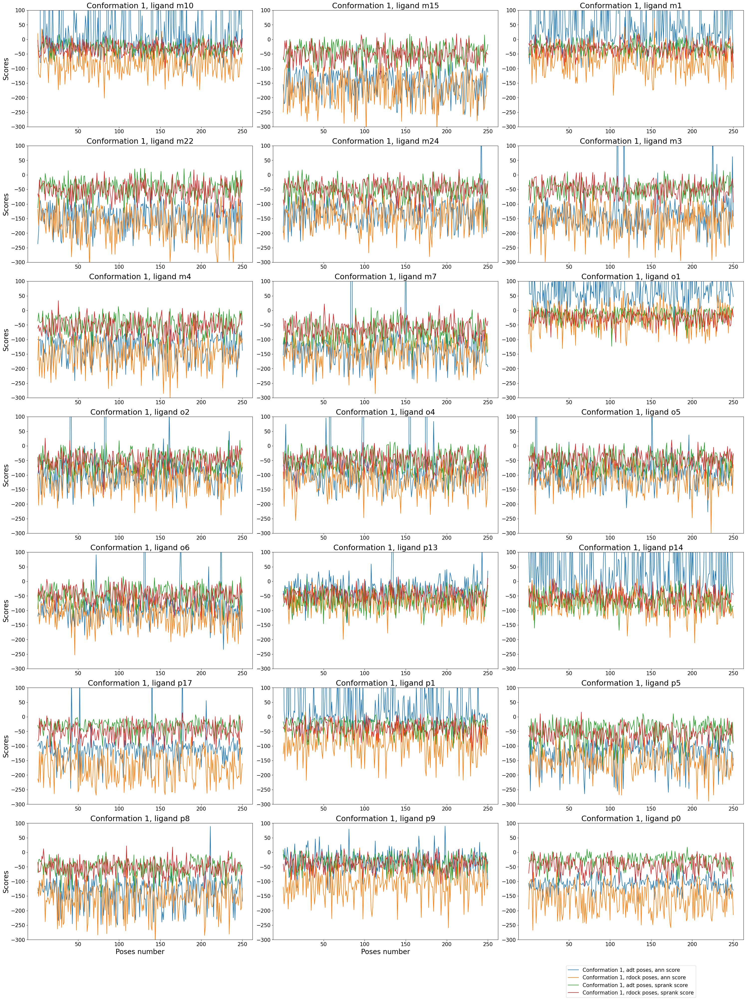

In [44]:
#for prot in proteins_site1:      #uncomment this line for the analysis for all conformations
for prot in proteins_site1[0:1]:    #plot only results derived from first conformation
    plt.figure(figsize=(30,40))
    k=0
    for lig in ligands[0:]:
        plt.subplot(7,3,k+1)
        for j in scor_funct[3:5]:
            for i in poses_soft:
                plt.plot(np.linspace(1,len(results_tot[prot,"adt","adt","m10"]),len(results_tot[prot,"adt","adt","m10"])),results_tot[(prot,i,j,lig)], label="Conformation {}, {} poses, {} score".format(str(prot)[9:],i,j))
        if prot=="crystal":
            plt.title('Crystal, ligand {}'.format(lig), fontsize=22)
        else:
            plt.title('Conformation {}, ligand {}'.format(str(prot)[9:],lig), fontsize=22)
        plt.yticks(fontsize=15) 
        plt.xticks(range(50,251,50),fontsize=15)
        plt.ylim(-300,100)
        if k%3==0:
            plt.ylabel("Scores", fontsize=20)
        k+=1
        if lig=="p8" or lig=="p9" or lig=="p0" and prot=="crystal":
            plt.xlabel("Poses number", fontsize=20)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),fontsize=15)
plt.tight_layout()
#plt.savefig('/home/riccardo/Desktop/score_ML_site1.png', dpi=300, bbox_inches='tight')
plt.show()

In [108]:
exp_rank={"p9":1,"m1":2,"p1":3,"p13":4,"p8":5,"m10":6,"o1":7,"p5":8,"m7":8,"p14":9,"p0":10,"m15":11,"p17":12,"m3":13,"m4":14,"m24":15,"m22":16,"o5":17,"o2":18,"o4":18,"o6":18}

In [109]:
results_tot_sorted={}
x_values=[]
for chiave, valore in exp_rank.items():
    x_values.append(chiave)
print(x_values)
for prot in proteins_site1:
    for lig in x_values:
        for i in poses_soft:
            for j in scor_funct:
                results_tot_sorted[prot,i,j,lig]=np.sort(results_tot[prot,i,j,lig])[0]

['p9', 'm1', 'p1', 'p13', 'p8', 'm10', 'o1', 'p5', 'm7', 'p14', 'p0', 'm15', 'p17', 'm3', 'm4', 'm24', 'm22', 'o5', 'o2', 'o4', 'o6']


In [110]:
results_tot_sorted_best_score={}
for prot in proteins_site1:
    for j in scor_funct:
        for lig in x_values:
            best=0
            for i in poses_soft:
                temp=results_tot_sorted[prot,i,j,lig]
                if temp<best:
                    best=temp
                    poses_method=i
                    scoring_function=j
            results_tot_sorted_best_score[prot,poses_method,scoring_function,lig]=best

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/results_tot_sorted_best_score_site1.pkl", "wb") as f:
#    pickle.dump(results_tot_sorted_best_score, f)

# --- Load ---
with open(path_data+"data_plots/results_tot_sorted_best_score_site1.pkl", "rb") as f:
    results_tot_sorted_best_score = pickle.load(f)

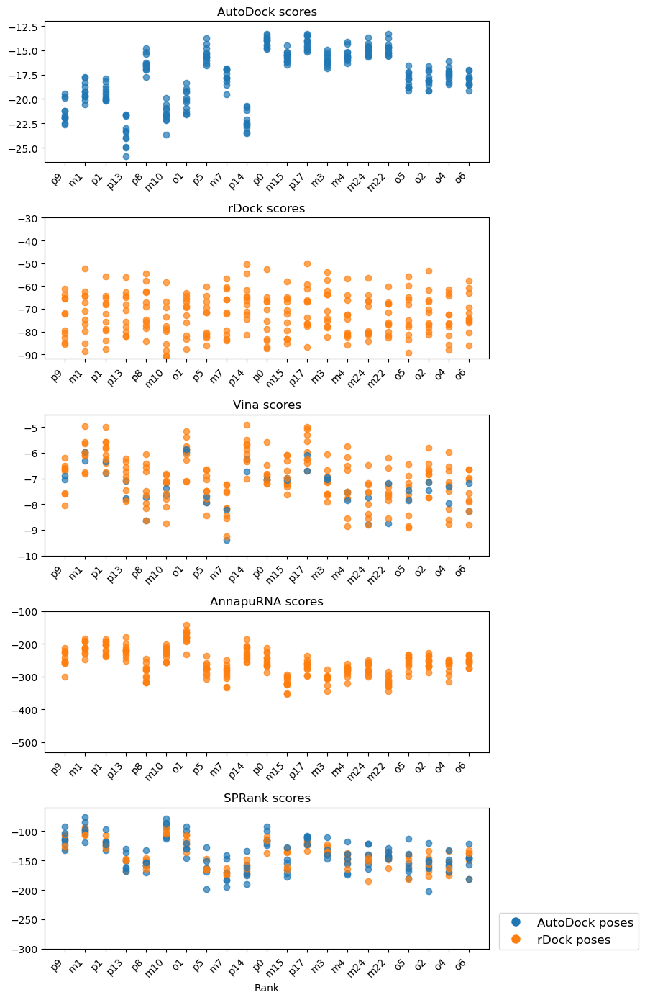

In [113]:
scores_best=[]
array_0_1=[]
for key,value in results_tot_sorted_best_score.items():
    scores_best.append(value)
    if key[1]=="adt":
        array_0_1.append(0)
    else:
        array_0_1.append(1)


plt.figure(figsize=(7,14))  
plt.subplot(5,1,1)
j=0
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("AutoDock scores")
plt.xticks(rotation=45, ha="right") 
plt.ylim(-26.5,-12)
plt.subplot(5,1,2)
j=21
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("rDock scores")
plt.ylim(-92,-30)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,3)
j=42
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("Vina scores")
plt.ylim(-10,-4.5)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,4)
j=63
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("AnnapuRNA scores")
plt.ylim(-530,-100)
plt.xticks(rotation=45, ha="right")  
plt.subplot(5,1,5)
j=84
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("SPRank scores")
plt.ylim(-300,-60)
plt.xlabel("Rank")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
handles = [
    Line2D([0], [0], marker='o', color='w', markerfacecolor='C0', markersize=10, label='AutoDock poses'),
    Line2D([0], [0], marker='o', color='w', markerfacecolor='C1', markersize=10, label='rDock poses')
]
plt.legend(handles=handles, fontsize=12,loc='lower right',bbox_to_anchor=(1.35, -0.05))
# Mostra il grafico
plt.show()

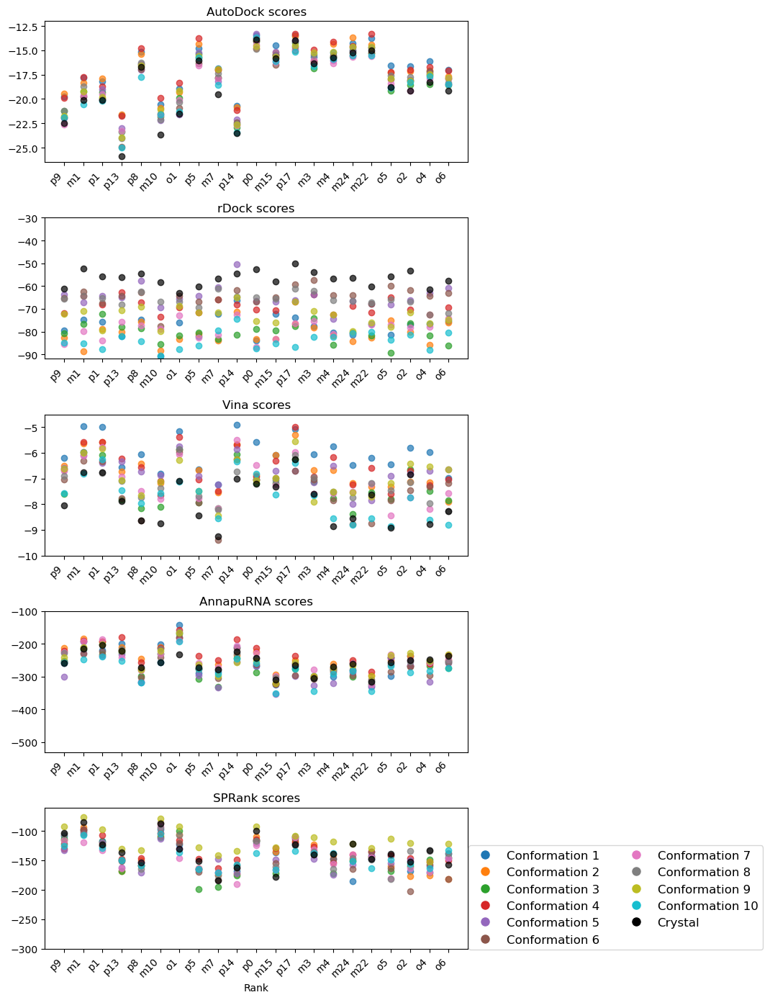

In [115]:
scores_best=[]
array_0_4=[]
for key,value in results_tot_sorted_best_score.items():
    scores_best.append(value)
    if key[0]=="centroid_1":
        array_0_4.append(0)
    elif key[0]=="centroid_2":
        array_0_4.append(1)
    elif key[0]=="centroid_3":
        array_0_4.append(2)
    elif key[0]=="centroid_4":
        array_0_4.append(3)
    elif key[0]=="centroid_5":
        array_0_4.append(4)
    elif key[0]=="centroid_6":
        array_0_4.append(5)
    elif key[0]=="centroid_7":
        array_0_4.append(6)
    elif key[0]=="centroid_8":
        array_0_4.append(7)
    elif key[0]=="centroid_9":
        array_0_4.append(8)
    elif key[0]=="crystal":
        array_0_4.append("black")
    else:
        array_0_4.append(9)
plt.figure(figsize=(12,14))
plt.subplot(5,1,1)
j=0
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j]))
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j]))
        j+=105
plt.title("AutoDock scores")
plt.ylim(-26.5,-12)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,2)
j=21
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j]))
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j]))
        j+=105
plt.title("rDock scores")
plt.ylim(-92,-30)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,3)
j=42
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j]))
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j])) 
        j+=105
plt.title("Vina scores")
plt.ylim(-10,-4.5)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,4)
j=63
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j])) 
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j])) 
        j+=105
plt.title("AnnapuRNA scores")
plt.ylim(-530,-100)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,5)
j=84
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j])) 
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j])) 
        j+=105
plt.title("SPRank scores")
plt.xlabel("Rank")
plt.ylim(-300,-60)
plt.xticks(rotation=45, ha="right")
handles = []
for i in range(10):
    handles.append(Line2D([0], [0],marker='o', color='w',markerfacecolor=f'C{i}',markersize=10,label=f'Conformation {i+1}'))

# Crystal (nero)
handles.append(Line2D([0], [0],marker='o', color='w',markerfacecolor='black',markersize=10,label='Crystal'))

plt.legend(handles=handles,fontsize=12,loc='lower center',bbox_to_anchor=(1.35, -0.05),ncol=2)  

plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/temp/legenda_conf.png', dpi=300, bbox_inches='tight')
plt.show()

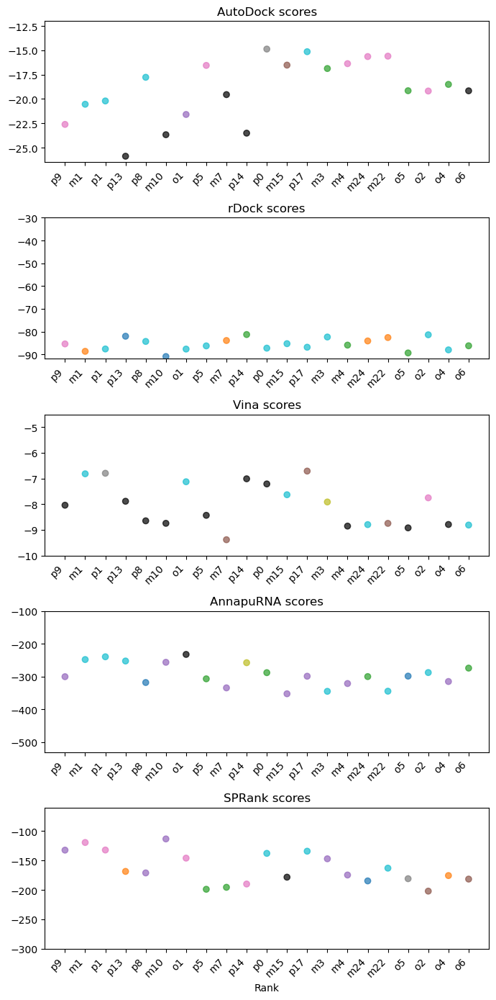

In [116]:
best_centroid={}
color_best=[]
for k in range(0,21):
    j=0
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.figure(figsize=(7,14))
plt.subplot(5,1,1)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("AutoDock scores")
plt.ylim(-26.5,-12)
plt.xticks(rotation=45, ha="right") 

best_centroid={}
color_best=[]
for k in range(0,21):
    j=21
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.subplot(5,1,2)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("rDock scores")
plt.ylim(-92,-30)
plt.xticks(rotation=45, ha="right")  

best_centroid={}
color_best=[]
for k in range(0,21):
    j=42
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.subplot(5,1,3)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("Vina scores")
plt.ylim(-10,-4.5)
plt.xticks(rotation=45, ha="right")  

best_centroid={}
color_best=[]
for k in range(0,21):
    j=63
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.subplot(5,1,4)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("AnnapuRNA scores")
plt.ylim(-530,-100)
plt.xticks(rotation=45, ha="right")  

best_centroid={}
color_best=[]
for k in range(0,21):
    j=84
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.subplot(5,1,5)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("SPRank scores")
plt.xlabel("Rank")
plt.ylim(-300,-60)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

In [52]:
results_tot={}
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/autodock_gpu/rescore_autodock/results")
        scores=[]
        results=Chem.SDMolSupplier('results_min_{}.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("meeko").split()[1]))
        results_tot[(prot,"adt","adt",lig)]=scores

In [53]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/rdock/")
        scores=[]
        results=Chem.SDMolSupplier('results_rdock_{}.sd'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("SCORE").split()[0]))
        results_tot[(prot,"rdock","rdock",lig)]=scores

In [90]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/autodock_gpu/rescore_rdock/results")
        scores=[]
        results=Chem.SDMolSupplier('results_min_{}.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("SCORE").split()[0]))
        results_tot[(prot,"adt","rdock",lig)]=scores

In [87]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/rdock/rescore_autodock/results")
        scores=[]
        results=Chem.SDMolSupplier('results_min_{}.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("meeko").split()[1]))
        results_tot[(prot,"rdock","adt",lig)]=scores

In [ ]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/autodock_gpu/rescore_annapurna")
        scores=[]
        results=Chem.SDMolSupplier('annapurna_{}_output.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("AnnapuRNA Score")))
        results_tot[(prot,"adt","ann",lig)]=scores

In [ ]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/rdock/rescore_annapurna")
        scores=[]
        results=Chem.SDMolSupplier('annapurna_{}_output.sdf'.format(lig))
        for i in range(0,poses):
            scores.append(float(results[i].GetProp("AnnapuRNA Score")))
        results_tot[(prot,"rdock","ann",lig)]=scores

In [80]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/autodock_gpu/rescore_vina/results")
        results_tot[(prot,"adt","vina",lig)]=np.loadtxt("vina_score.txt").tolist()

In [81]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/rdock/rescore_vina/results")
        results_tot[(prot,"rdock","vina",lig)]=np.loadtxt("vina_score.txt").tolist()

In [82]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/autodock_gpu/rescore_sprank")
        file=open("score.dat","r")
        temp=[]
        for line in file:
            line=line.split()
            if len(line)==4 and line[0]=="*****":
                temp.append(float(line[3]))
        results_tot[(prot,"adt","sprank",lig)]=temp

In [83]:
for prot in proteins_site2:
    for lig in ligands:
        os.chdir(work_dir_site2+prot+"/"+lig+"/rdock/rescore_sprank")
        file=open("score.dat","r")
        temp=[]
        for line in file:
            line=line.split()
            if len(line)==2 and line[0]=="#Scoring":
                line=file.readline()
                for i in range(0,250):
                    line=file.readline()
                    line=line.split()
                    temp.append(float(line[3]))
        results_tot[(prot,"rdock","sprank",lig)]=temp

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/results_tot_site2.pkl", "wb") as f:
#    pickle.dump(results_tot, f)

# --- Load ---
with open(path_data+"data_plots/results_tot_site2.pkl", "rb") as f:
    results_tot = pickle.load(f)

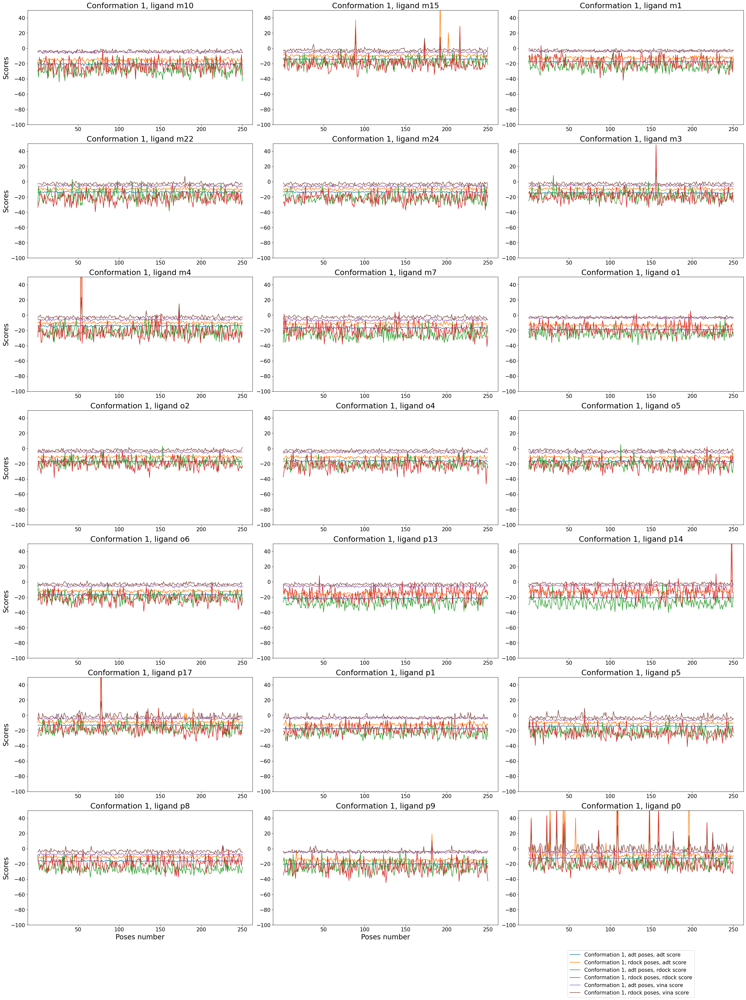

In [27]:
#for prot in proteins_site2:      #uncomment this line for the analysis for all conformations
for prot in proteins_site2[0:1]:    #plot only results derived from first conformation
    plt.figure(figsize=(30,40))
    k=0
    for lig in ligands:
        plt.subplot(7,3,k+1)
        for j in scor_funct[0:3]:
            for i in poses_soft:
                plt.plot(np.linspace(1,len(results_tot[prot,"adt","adt","m10"]),len(results_tot[prot,"adt","adt","m10"])),results_tot[(prot,i,j,lig)],label="Conformation {}, {} poses, {} score".format(str(prot)[9:],i,j))
        if prot=="crystal":
            plt.title('Crystal, ligand {}'.format(lig), fontsize=22)
        else:
            plt.title('Conformation {}, ligand {}'.format(str(prot)[9:],lig), fontsize=22)
        plt.yticks(fontsize=15) 
        plt.ylim(-100,50)
        plt.xticks(range(50,251,50),fontsize=15)
        if k%3==0:
            plt.ylabel("Scores", fontsize=20)
        k+=1
        if lig=="p8" or lig=="p9" or lig=="p0" and prot=="crystal":
            plt.xlabel("Poses number", fontsize=20)
    
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),fontsize=15)
plt.tight_layout()
#plt.savefig('/home/riccardo/Desktop/score_ff_site2.png', dpi=300, bbox_inches='tight')
plt.show()

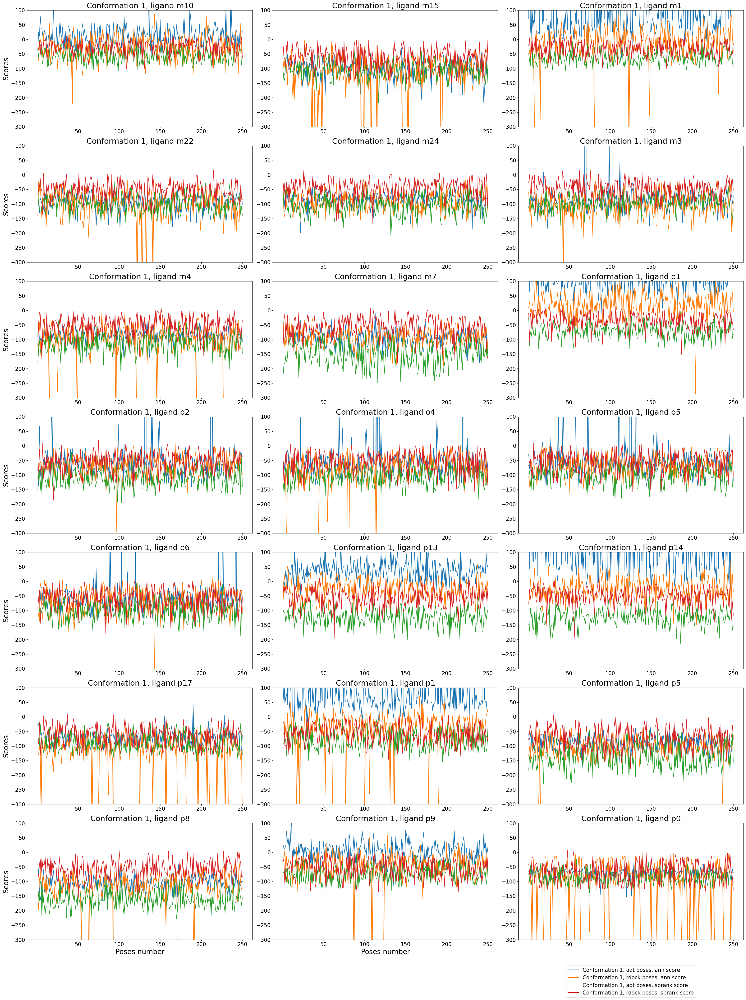

In [93]:
#for prot in proteins_site2:      #uncomment this line for the analysis for all conformations
for prot in proteins_site2[0:1]:    #plot only results derived from first conformation
    plt.figure(figsize=(30,40))
    k=0
    for lig in ligands[0:]:
        plt.subplot(7,3,k+1)
        for j in scor_funct[3:5]:
            for i in poses_soft:
                plt.plot(np.linspace(1,len(results_tot[prot,"adt","adt","m10"]),len(results_tot[prot,"adt","adt","m10"])),results_tot[(prot,i,j,lig)], label="Conformation {}, {} poses, {} score".format(str(prot)[9:],i,j))
        if prot=="crystal":
            plt.title('Crystal, ligand {}'.format(lig), fontsize=22)
        else:
            plt.title('Conformation {}, ligand {}'.format(str(prot)[9:],lig), fontsize=22)
        plt.yticks(fontsize=15) 
        plt.xticks(range(50,251,50),fontsize=15)
        plt.ylim(-300,100)
        if k%3==0:
            plt.ylabel("Scores", fontsize=20)
        k+=1
        if lig=="p8" or lig=="p9" or lig=="p0" and prot=="crystal":
            plt.xlabel("Poses number", fontsize=20)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),fontsize=15)
plt.tight_layout()
#plt.savefig('/home/riccardo/Desktop/score_ML_site2.png', dpi=300, bbox_inches='tight')
plt.show()

In [118]:
results_tot_sorted={}
x_values=[]
for chiave, valore in exp_rank.items():
    x_values.append(chiave)
print(x_values)
for prot in proteins_site2:
    for lig in x_values:
        for i in poses_soft:
            for j in scor_funct:
                results_tot_sorted[prot,i,j,lig]=np.sort(results_tot[prot,i,j,lig])[0]

['p9', 'm1', 'p1', 'p13', 'p8', 'm10', 'o1', 'p5', 'm7', 'p14', 'p0', 'm15', 'p17', 'm3', 'm4', 'm24', 'm22', 'o5', 'o2', 'o4', 'o6']


In [119]:
results_tot_sorted_best_score={}
for prot in proteins_site2:
    for j in scor_funct:
        for lig in x_values:
            best=0
            for i in poses_soft:
                temp=results_tot_sorted[prot,i,j,lig]
                if temp<best:
                    best=temp
                    poses_method=i
                    scoring_function=j
            results_tot_sorted_best_score[prot,poses_method,scoring_function,lig]=best

In [ ]:
# --- Save ---
with open(path_data+"data_plots/results_tot_sorted_best_score_site2.pkl", "wb") as f:
    pickle.dump(results_tot_sorted_best_score, f)

# --- Load ---
with open(path_data+"data_plots/results_tot_sorted_best_score_site2.pkl", "rb") as f:
    results_tot_sorted_best_score = pickle.load(f)

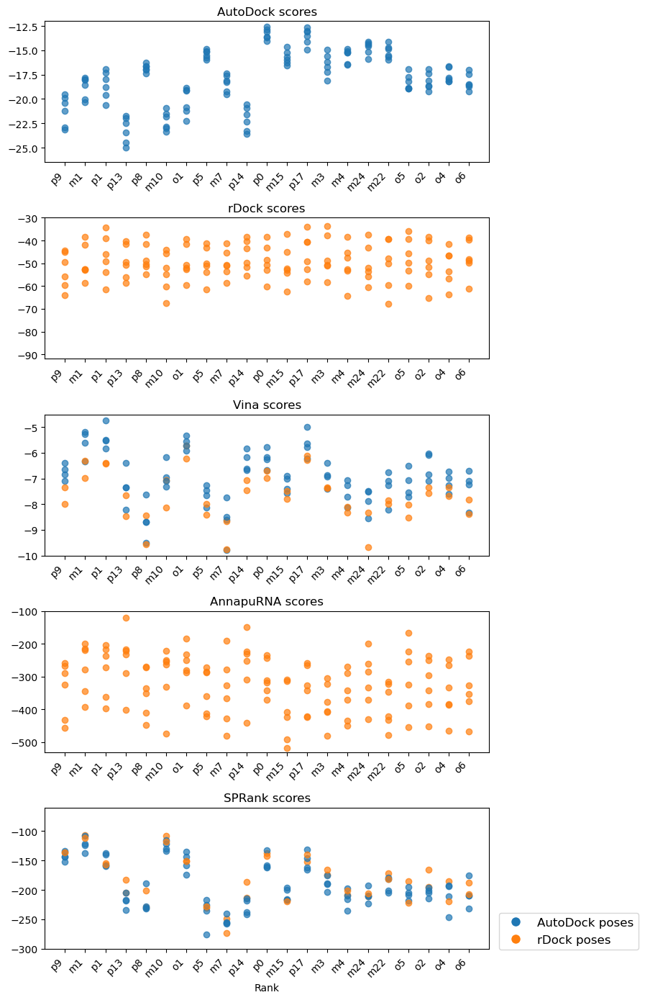

In [122]:
scores_best=[]
array_0_1=[]
for key,value in results_tot_sorted_best_score.items():
    scores_best.append(value)
    if key[1]=="adt":
        array_0_1.append(0)
    else:
        array_0_1.append(1)


plt.figure(figsize=(7,14))  
plt.subplot(5,1,1)
j=0
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("AutoDock scores")
plt.xticks(rotation=45, ha="right") 
plt.ylim(-26.5,-12)
plt.subplot(5,1,2)
j=21
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("rDock scores")
plt.ylim(-92,-30)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,3)
j=42
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("Vina scores")
plt.ylim(-10,-4.5)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,4)
j=63
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("AnnapuRNA scores")
plt.ylim(-530,-100)
plt.xticks(rotation=45, ha="right")  
plt.subplot(5,1,5)
j=84
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_1[j]))
    j+=105
plt.title("SPRank scores")
plt.ylim(-300,-60)
plt.xlabel("Rank")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
handles = [
    Line2D([0], [0], marker='o', color='w', markerfacecolor='C0', markersize=10, label='AutoDock poses'),
    Line2D([0], [0], marker='o', color='w', markerfacecolor='C1', markersize=10, label='rDock poses')
]
plt.legend(handles=handles, fontsize=12,loc='lower right',bbox_to_anchor=(1.35, -0.05))
# Mostra il grafico
plt.show()

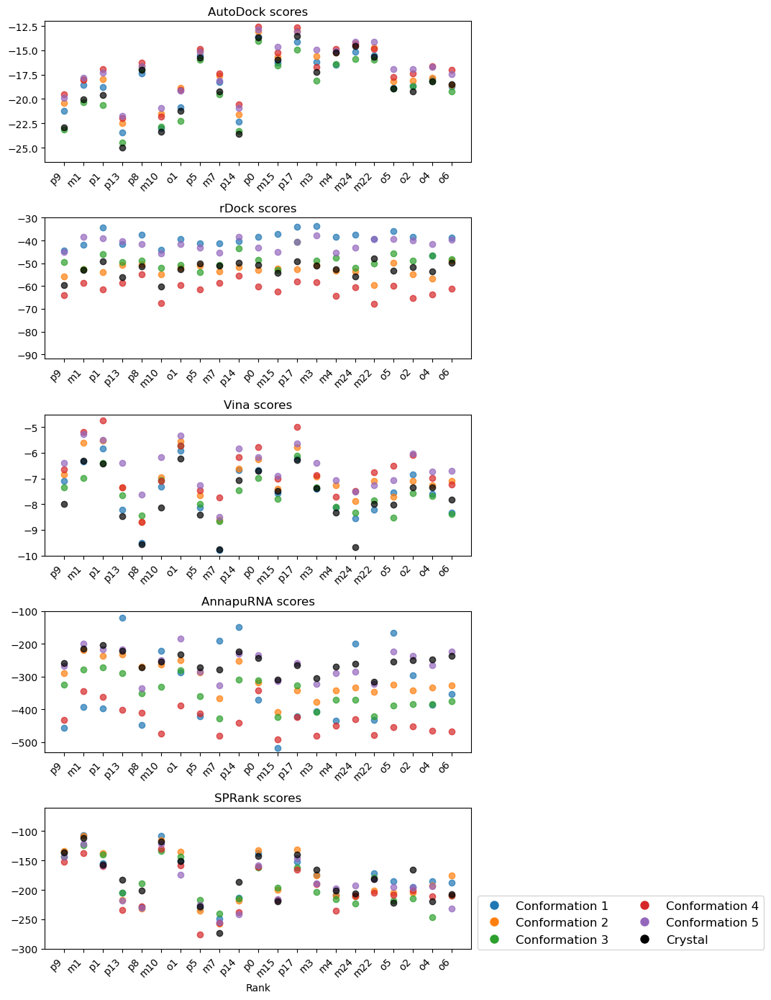

In [125]:
scores_best=[]
array_0_4=[]
for key,value in results_tot_sorted_best_score.items():
    scores_best.append(value)
    if key[0]=="centroid_1":
        array_0_4.append(0)
    elif key[0]=="centroid_2":
        array_0_4.append(1)
    elif key[0]=="centroid_3":
        array_0_4.append(2)
    elif key[0]=="centroid_4":
        array_0_4.append(3)
    elif key[0]=="centroid_5":
        array_0_4.append(4)
    elif key[0]=="crystal":
        array_0_4.append("black")
    else:
        array_0_4.append(9)
plt.figure(figsize=(12,14))
plt.subplot(5,1,1)
j=0
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j]))
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j]))
        j+=105
plt.title("AutoDock scores")
plt.ylim(-26.5,-12)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,2)
j=21
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j]))
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j]))
        j+=105
plt.title("rDock scores")
plt.ylim(-92,-30)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,3)
j=42
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j]))
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j])) 
        j+=105
plt.title("Vina scores")
plt.ylim(-10,-4.5)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,4)
j=63
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j])) 
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j])) 
        j+=105
plt.title("AnnapuRNA scores")
plt.ylim(-530,-100)
plt.xticks(rotation=45, ha="right") 
plt.subplot(5,1,5)
j=84
for i in range(0,int(len(results_tot_sorted_best_score)/105)):
    if array_0_4[j]!="black":
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c="C"+str(array_0_4[j])) 
        j+=105
    else:
        plt.scatter(x_values, scores_best[j:j+21], alpha=0.7,c=str(array_0_4[j])) 
        j+=105
plt.title("SPRank scores")
plt.xlabel("Rank")
plt.ylim(-300,-60)
plt.xticks(rotation=45, ha="right")
handles = []
for i in range(5):
    handles.append(Line2D([0], [0],marker='o', color='w',markerfacecolor=f'C{i}',markersize=10,label=f'Conformation {i+1}'))

# Crystal (nero)
handles.append(Line2D([0], [0],marker='o', color='w',markerfacecolor='black',markersize=10,label='Crystal'))

plt.legend(handles=handles,fontsize=12,loc='lower center',bbox_to_anchor=(1.35, -0.05),ncol=2)  

plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/temp/legenda_conf.png', dpi=300, bbox_inches='tight')
plt.show()

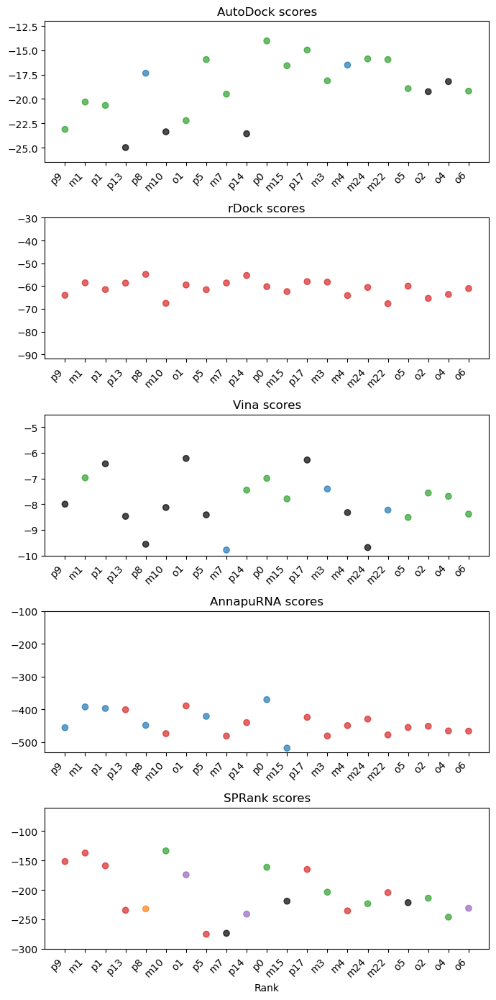

In [126]:
best_centroid={}
color_best=[]
for k in range(0,21):
    j=0
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.figure(figsize=(7,14))
plt.subplot(5,1,1)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("AutoDock scores")
plt.ylim(-26.5,-12)
plt.xticks(rotation=45, ha="right") 

best_centroid={}
color_best=[]
for k in range(0,21):
    j=21
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.subplot(5,1,2)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("rDock scores")
plt.ylim(-92,-30)
plt.xticks(rotation=45, ha="right")  

best_centroid={}
color_best=[]
for k in range(0,21):
    j=42
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.subplot(5,1,3)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("Vina scores")
plt.ylim(-10,-4.5)
plt.xticks(rotation=45, ha="right")  

best_centroid={}
color_best=[]
for k in range(0,21):
    j=63
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.subplot(5,1,4)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("AnnapuRNA scores")
plt.ylim(-530,-100)
plt.xticks(rotation=45, ha="right")  

best_centroid={}
color_best=[]
for k in range(0,21):
    j=84
    best=0
    for i in range(0,int(len(results_tot_sorted_best_score)/105)):
        if scores_best[k+j]<best:
            best=scores_best[k+j]
            z=k+j
        j+=105
    best_centroid[z]=best
keys_best=[]
values_best=[]
for key,value in best_centroid.items():
    keys_best.append(array_0_4[key])
    values_best.append(value)
key_best_color=[]
for element in keys_best:
    if element=="black":
        key_best_color.append(str(element))
    else:
        key_best_color.append("C"+str(element))
plt.subplot(5,1,5)
plt.scatter(x_values, values_best, alpha=0.7,c=key_best_color)
plt.title("SPRank scores")
plt.xlabel("Rank")
plt.ylim(-300,-60)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

In [ ]:
coord_tot_site1=[]
os.chdir(work_dir_site1+"dim_reduction")
temp=mdt.load("results_adt_rdock_tot_noh.pdb", top='p13_noh.pdb')
selection=temp.topology.select("not element H")
removes_adt=[12,13,16,15,18,17,7,8,20,21,51,50,27,28,49,48,37,36,46,47,41,42,45,44]
coord_tot_site1_rdock=temp.xyz[2500:,selection,:]
reorder_tot=[35,34,36,37,38,39,40,41,42,43,44,49,45,47,46,48,50,51,3,4,5,6,7,8,9,10,15,14,13,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,12,11,1,2]
coord_tot_site1_rdock_reordered=np.copy(coord_tot_site1_rdock)
for i in range(len(coord_tot_site1_rdock)):
    k=0
    for element in reorder_tot:
        coord_tot_site1_rdock_reordered[i][k]=coord_tot_site1_rdock[i][element-1]
        k+=1
reorder_filter=[1,2,3,4,5,6,9,10,11,14,19,22,23,24,25,26,29,30,31,32,33,34,35,38,39,40,43]
coord_tot_site1_rdock_reordered_filtered=np.zeros((len(coord_tot_site1_rdock),len(reorder_filter),3))
for i in range(len(coord_tot_site1_rdock_reordered)):
    k=0
    for element in reorder_filter:
        coord_tot_site1_rdock_reordered_filtered[i][k]=coord_tot_site1_rdock_reordered[i][element-1]
        k+=1
selection_new=[]
for element in selection:
    element_coun1=element+1
    if element_coun1 not in removes_adt:
        selection_new.append(element)
selection_new=np.array(selection_new)
coord_tot_site1_adt=temp.xyz[:2500,selection_new,:]
coord_tot_site1=[]
for i in range(len(coord_tot_site1_adt)):
    coord_tot_site1.append(coord_tot_site1_adt[i])
for i in range(len(coord_tot_site1_rdock_reordered_filtered)):
    coord_tot_site1.append(coord_tot_site1_rdock_reordered_filtered[i])
coord_tot_site1=np.array(coord_tot_site1)

In [134]:
coord_tot_site1 = coord_tot_site1.reshape(coord_tot_site1.shape[0],-1)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/coord_tot_site1.pkl", "wb") as f:
#    pickle.dump(coord_tot_site1, f)

# --- Load ---
with open(path_data+"data_plots/coord_tot_site1.pkl", "rb") as f:
    coord_tot_site1 = pickle.load(f)

In [136]:
pca_site1 = PCA(n_components=2)
converted_data_site1 = pca_site1.fit_transform(coord_tot_site1)

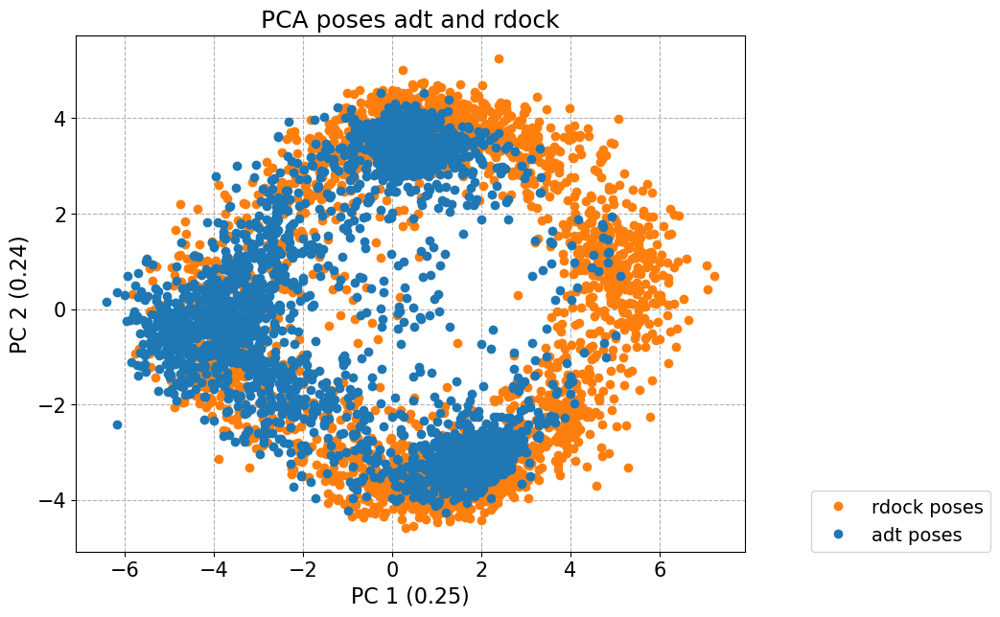

In [137]:
plt.figure(figsize=(9,7))
plt.plot(converted_data_site1[2500:,0],converted_data_site1[2500:,1],'o',color="C1",label="rdock poses")
plt.plot(converted_data_site1[:2500,0],converted_data_site1[:2500,1],'o',color="C0",label="adt poses")
plt.legend(loc=(1.1,0),fontsize=14)
plt.xlabel("PC 1 (%s)"%round(pca_site1.explained_variance_ratio_[0],2), fontsize=16)
plt.ylabel("PC 2 (%s)"%round(pca_site1.explained_variance_ratio_[1],2), fontsize=16)
plt.title('PCA poses adt and rdock', fontsize=18)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.grid(axis='both',ls='--')
plt.show()

In [ ]:
coord_tot_site2=[]
os.chdir(work_dir_site2+"dim_reduction")
temp=mdt.load("results_adt_rdock_tot_noh.pdb", top='p13_noh.pdb')
selection=temp.topology.select("not element H")
removes_adt=[12,13,16,15,18,17,7,8,20,21,51,50,27,28,49,48,37,36,46,47,41,42,45,44]
coord_tot_site2_rdock=temp.xyz[1250:,selection,:]
reorder_tot=[35,34,36,37,38,39,40,41,42,43,44,49,45,47,46,48,50,51,3,4,5,6,7,8,9,10,15,14,13,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,12,11,1,2]
coord_tot_site2_rdock_reordered=np.copy(coord_tot_site2_rdock)
for i in range(len(coord_tot_site2_rdock)):
    k=0
    for element in reorder_tot:
        coord_tot_site2_rdock_reordered[i][k]=coord_tot_site2_rdock[i][element-1]
        k+=1
reorder_filter=[1,2,3,4,5,6,9,10,11,14,19,22,23,24,25,26,29,30,31,32,33,34,35,38,39,40,43]
coord_tot_site2_rdock_reordered_filtered=np.zeros((len(coord_tot_site2_rdock),len(reorder_filter),3))
for i in range(len(coord_tot_site2_rdock_reordered)):
    k=0
    for element in reorder_filter:
        coord_tot_site2_rdock_reordered_filtered[i][k]=coord_tot_site2_rdock_reordered[i][element-1]
        k+=1
selection_new=[]
for element in selection:
    element_coun1=element+1
    if element_coun1 not in removes_adt:
        selection_new.append(element)
selection_new=np.array(selection_new)
coord_tot_site2_adt=temp.xyz[:1250,selection_new,:]
coord_tot_site2=[]
for i in range(len(coord_tot_site2_adt)):
    coord_tot_site2.append(coord_tot_site2_adt[i])
for i in range(len(coord_tot_site2_rdock_reordered_filtered)):
    coord_tot_site2.append(coord_tot_site2_rdock_reordered_filtered[i])
coord_tot_site2=np.array(coord_tot_site2)

In [139]:
coord_tot_site2 = coord_tot_site2.reshape(coord_tot_site2.shape[0],-1)

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/coord_tot_site2.pkl", "wb") as f:
#    pickle.dump(coord_tot_site2, f)

# --- Load ---
with open(path_data+"data_plots/coord_tot_site2.pkl", "rb") as f:
    coord_tot_site2 = pickle.load(f)

In [141]:
pca_site2 = PCA(n_components=2)
converted_data_site2 = pca_site2.fit_transform(coord_tot_site2)

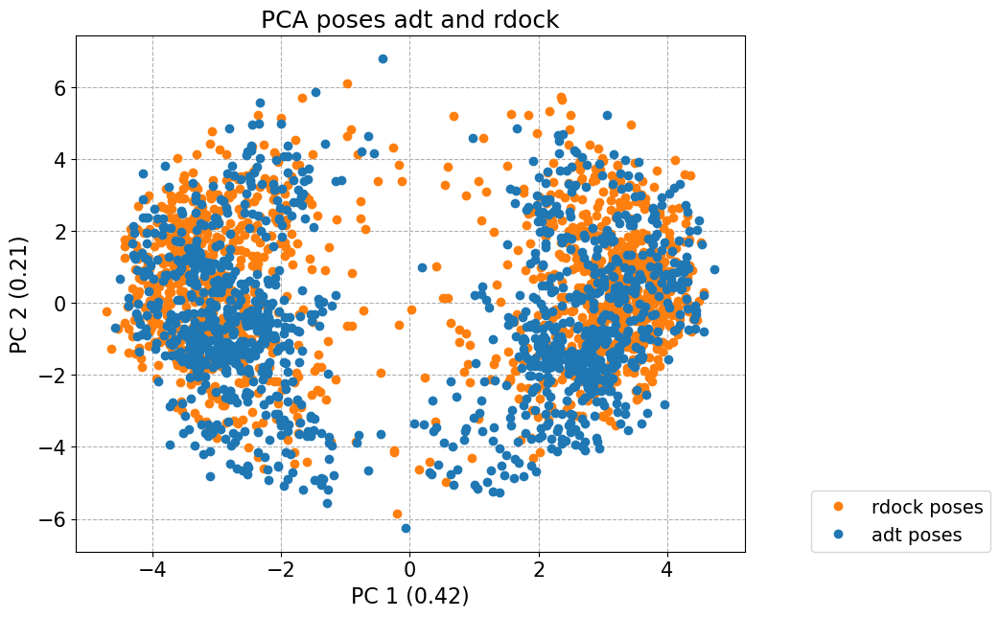

In [142]:
plt.figure(figsize=(9,7))
plt.plot(converted_data_site2[1250:,0],converted_data_site2[1250:,1],'o',c='C1',label="rdock poses")
plt.plot(converted_data_site2[:1250,0],converted_data_site2[:1250,1],'o',c='C0',label="adt poses")
plt.legend(loc=(1.1,0),fontsize=14)
plt.xlabel("PC 1 (%s)"%round(pca_site2.explained_variance_ratio_[0],2), fontsize=16)
plt.ylabel("PC 2 (%s)"%round(pca_site2.explained_variance_ratio_[1],2), fontsize=16)
plt.title('PCA poses adt and rdock', fontsize=18)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.grid(axis='both',ls='--')
plt.show()

## FingeRNAt

Here you can find the FingeRNAt analysis for all poses generated with AutoDock-GPU for each binding site, together with the PCA performed on the corresponding interaction profiles.

In [ ]:
proteins_site2=['centroid_1','centroid_2','centroid_3','centroid_4','centroid_5']
proteins_site1=['centroid_1','centroid_2','centroid_3','centroid_4','centroid_5','centroid_6','centroid_7','centroid_8','centroid_9','centroid_10']
ligands=["p9","m1","p1","p13","p8","m10","o1","p5","m7","p14","p0","m15","p17","m3","m4","m24","m22","o5","o2","o4","o6"]
interactions = {'HB': 'blue','Lipophilic': 'red','CA': 'green','Pi_Stacking': 'orange','Pi_Anion': 'purple','Pi_Cation': 'brown','HAL':'black'}
work_fingernat=path_data+"data_fingernat/"

In [162]:
os.chdir(work_fingernat+"site1/outputs_adt_dha_tot")
df_adt={}
for prot in proteins_site1:
    for lig in ligands:
        data=open("DETAIL_{}.pdb_results_{}_{}_reordered.sdf_FULL.txt".format(prot,lig,prot),"r")
        data_array=[]
        data.readline()
        for line in data:
            temp=[]
            line=line.split('\t')
            temp.append(str(line[4]))
            temp.append(float(line[-1]))
            data_array.append(temp)
        df_adt['{}'.format(prot),'{}'.format(lig)] = pd.DataFrame(data_array, columns=['Interaction', 'Distance'])

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/df_adt_site1.pkl", "wb") as f:
#    pickle.dump(df_adt, f)

# --- Load ---
with open(path_data+"data_plots/df_adt_site1.pkl", "rb") as f:
    df_adt = pickle.load(f)

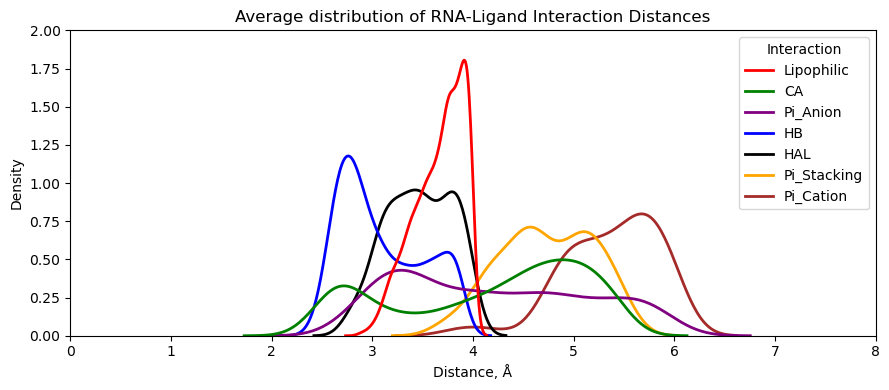

In [147]:
plt.figure(figsize=(9, 4))
sns.kdeplot(data=df_adt['{}'.format(prot),'{}'.format(lig)],  hue='Interaction', x='Distance', linewidth=2, common_norm=False,palette=interactions)
plt.xlabel('Distance, Å')
plt.ylabel('Density')
plt.xlim(0, 8) 
plt.ylim(0,2)
plt.title('Average distribution of RNA-Ligand Interaction Distances')
plt.tight_layout()
plt.show()

In [ ]:
df_adt_poses={}
os.chdir(work_fingernat+"site1/outputs_adt_dha_tot")
for prot in proteins_site1:
    for lig in ligands:
        for i in range(1,251):
            data_array=[]
            data=open("DETAIL_{}.pdb_results_{}_{}_reordered.sdf_FULL.txt".format(prot,lig,prot),"r")
            data.readline()
            for line in data:
                line=line.split('\t')
                temp=[]
                if int(line[2])==i:
                    temp.append(str(line[4]))
                    temp.append(float(line[-1]))
                if len(temp)>0:
                    data_array.append(temp)
            df_adt_poses['{}'.format(prot),'{}'.format(lig),i] = pd.DataFrame(data_array, columns=['Interaction', 'Distance'])

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/df_adt_poses_site1.pkl", "wb") as f:
#    pickle.dump(df_adt_poses, f)

# --- Load ---
with open(path_data+"data_plots/df_adt_poses_site1.pkl", "rb") as f:
    df_adt_poses = pickle.load(f)

In [148]:
hist_adt=[]
bin_edges=[]
bin_centers=[]
for prot in proteins_site1:
    for lig in ligands:
        for i in range(1,251):
            hist_i=[]
            bin_edges_i=[]
            for interaction in interactions.keys():
                distances=[]
                temp=[]
                for element in range(len(df_adt_poses[prot,lig,i]["Interaction"])):
                    if df_adt_poses[prot,lig,i]["Interaction"][element]==interaction:
                        temp.append(df_adt_poses[prot,lig,i]["Distance"][element])
                distances.append(temp)
                temp_hist_i, temp_bin_edges_i = np.histogram(distances, bins=np.linspace(2, 8, 81))
                hist_i.extend(temp_hist_i)
                bin_edges_i.extend(temp_bin_edges_i)
            hist_adt.append(hist_i)
            bin_edges.append(bin_edges_i)
bin_centers = (np.array(bin_edges_i[:-1]) + np.array(bin_edges_i[1:])) / 2

In [149]:
hist_ok_adt=[]
for i in range(len(hist_adt)):
    hist_ok_adt.append([int(x) for x in hist_adt[i]])
hist_ok_adt=np.array(hist_ok_adt)
hist_norm_adt = normalize(hist_ok_adt, axis=1)

In [150]:
pca_adt = PCA(n_components=2)
pca_data_adt = pca_adt.fit_transform(np.array(hist_norm_adt))
pca_adt.explained_variance_ratio_

array([0.08644178, 0.05619043])

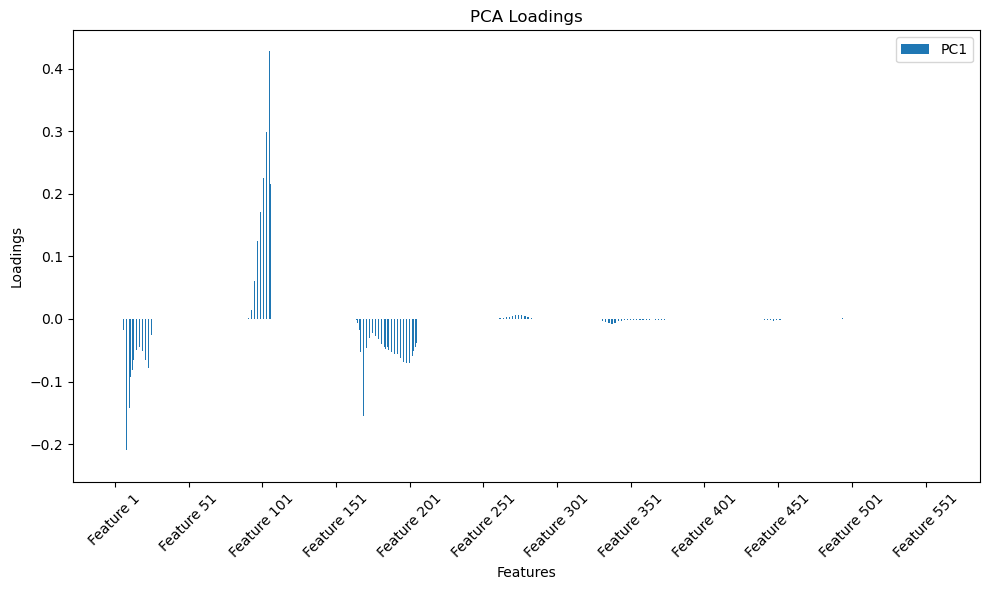

In [152]:
feature_names = [f"Feature {i+1}" for i in range(hist_norm_adt.shape[1])]


loadings = pca_adt.components_.T  
loadings_df = pd.DataFrame(loadings, columns=["PC1", "PC2"], index=feature_names)


plt.figure(figsize=(10, 6))

x = np.arange(len(feature_names))
plt.bar(x - 0.2, loadings[:, 0], width=0.4, label="PC1")
#plt.bar(x + 0.2, loadings[:, 1], width=0.4, label="PC2")

plt.xticks(x[::50], feature_names[::50], rotation=45)
plt.xlabel("Features")
plt.ylabel("Loadings")
plt.title("PCA Loadings")
plt.legend()
plt.tight_layout()
plt.show()

In [153]:
luminosity = 0.9

color_legend = [
    (1.0 * luminosity, 0.0 * luminosity, 0.0 * luminosity, 1.0),
    (1.0 * luminosity, 0.208 * luminosity, 0.0 * luminosity, 1.0),
    (1.0 * luminosity, 0.439 * luminosity, 0.0 * luminosity, 1.0),
    (1.0 * luminosity, 0.671 * luminosity, 0.0 * luminosity, 1.0),
    (1.0 * luminosity, 0.902 * luminosity, 0.0 * luminosity, 1.0),
    (0.863 * luminosity, 1.0 * luminosity, 0.0 * luminosity, 1.0),
    (0.631 * luminosity, 1.0 * luminosity, 0.0 * luminosity, 1.0),
    (0.4 * luminosity, 1.0 * luminosity, 0.0 * luminosity, 1.0),
    (0.169 * luminosity, 1.0 * luminosity, 0.0 * luminosity, 1.0),
    (0.0 * luminosity, 1.0 * luminosity, 0.059 * luminosity, 1.0),
    (0.0 * luminosity, 1.0 * luminosity, 0.29 * luminosity, 1.0),
    (0.0 * luminosity, 1.0 * luminosity, 0.522 * luminosity, 1.0),
    (0.0 * luminosity, 1.0 * luminosity, 0.753 * luminosity, 1.0),
    (0.0 * luminosity, 1.0 * luminosity, 0.984 * luminosity, 1.0),
    (0.0 * luminosity, 0.78 * luminosity, 1.0 * luminosity, 1.0),
    (0.0 * luminosity, 0.545 * luminosity, 1.0 * luminosity, 1.0),
    (0.0 * luminosity, 0.314 * luminosity, 1.0 * luminosity, 1.0),
    (0.0 * luminosity, 0.082 * luminosity, 1.0 * luminosity, 1.0),
    (0.145 * luminosity, 0.0 * luminosity, 1.0 * luminosity, 1.0),
    (0.376 * luminosity, 0.0 * luminosity, 1.0 * luminosity, 1.0),
    (0.608 * luminosity, 0.0 * luminosity, 1.0 * luminosity, 1.0)
]
temp = np.concatenate([np.tile(np.array([color]), (250, 1))for color in color_legend], axis=0)
labels_lig = np.tile(temp, (len(proteins_site1),1))

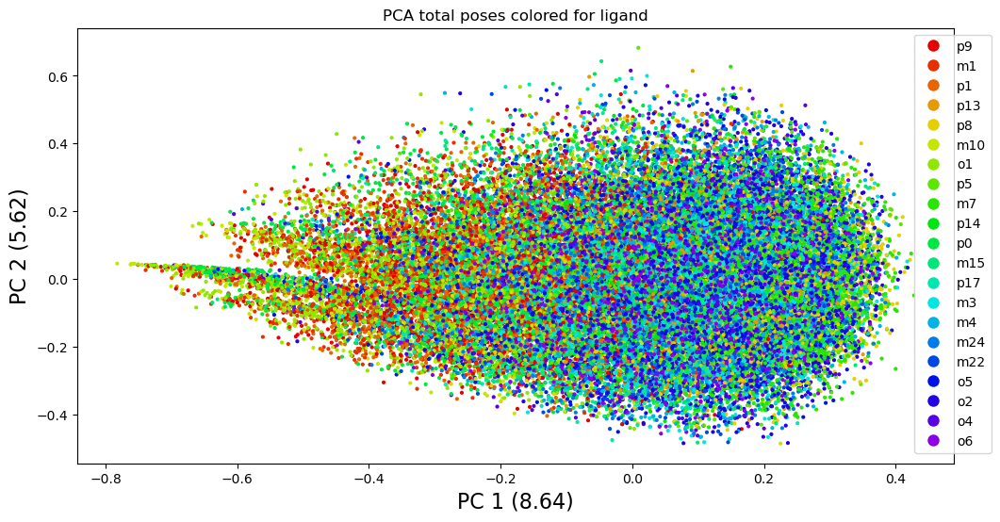

In [154]:
plt.figure(figsize=(12, 6))
scatter = plt.scatter(pca_data_adt[:, 0], pca_data_adt[:, 1], c=labels_lig,s=4)

handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=c, markersize=10) for c in color_legend]
legend_labels = [f'{i}' for i in ligands]
plt.legend(handles,legend_labels, loc='upper right', bbox_to_anchor=(1.05, 1))
plt.title('PCA total poses colored for ligand')
plt.xlabel("PC 1 (%s)"%round(pca_adt.explained_variance_ratio_[0]*100,2), fontsize=16)
plt.ylabel("PC 2 (%s)"%round(pca_adt.explained_variance_ratio_[1]*100,2), fontsize=16)
plt.show()

In [164]:
os.chdir(work_fingernat+"site2/outputs_adt_dha_tot")
df_adt={}
for prot in proteins_site2:
    for lig in ligands:
        data=open("DETAIL_{}.pdb_results_{}_{}_reordered.sdf_FULL.txt".format(prot,lig,prot),"r")
        data_array=[]
        data.readline()
        for line in data:
            temp=[]
            line=line.split('\t')
            temp.append(str(line[4]))
            temp.append(float(line[-1]))
            data_array.append(temp)
        df_adt['{}'.format(prot),'{}'.format(lig)] = pd.DataFrame(data_array, columns=['Interaction', 'Distance'])

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/df_adt_site2.pkl", "wb") as f:
#    pickle.dump(df_adt, f)

# --- Load ---
with open(path_data+"data_plots/df_adt_site2.pkl", "rb") as f:
    df_adt = pickle.load(f)

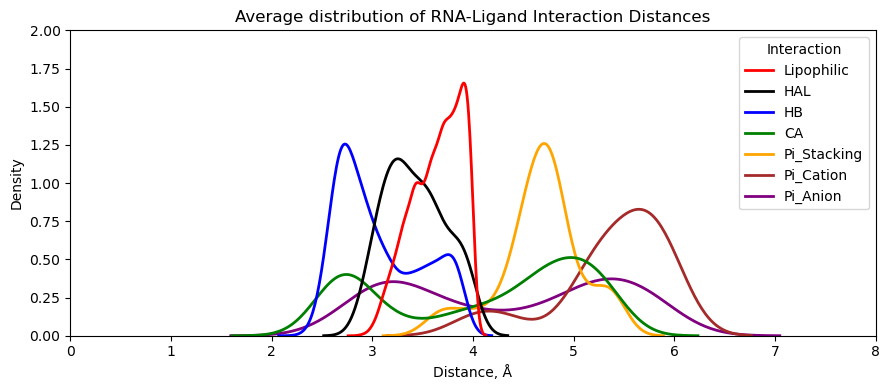

In [167]:
plt.figure(figsize=(9, 4))
sns.kdeplot(data=df_adt['{}'.format(prot),'{}'.format(lig)],  hue='Interaction', x='Distance', linewidth=2, common_norm=False,palette=interactions)
plt.xlabel('Distance, Å')
plt.ylabel('Density')
plt.xlim(0, 8)
plt.ylim(0,2)
plt.title('Average distribution of RNA-Ligand Interaction Distances')
plt.tight_layout()
plt.show()

In [160]:
df_adt_poses={}
os.chdir(work_fingernat+"site2/outputs_adt_dha_tot/")
for prot in proteins_site2:
    for lig in ligands:
        for i in range(1,251):
            data_array=[]
            data=open("DETAIL_{}.pdb_results_{}_{}_reordered.sdf_FULL.txt".format(prot,lig,prot),"r")
            data.readline()
            for line in data:
                line=line.split('\t')
                temp=[]
                if int(line[2])==i:
                    temp.append(str(line[4]))
                    temp.append(float(line[-1]))
                if len(temp)>0:
                    data_array.append(temp)
            df_adt_poses['{}'.format(prot),'{}'.format(lig),i] = pd.DataFrame(data_array, columns=['Interaction', 'Distance'])

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/df_adt_poses_site2.pkl", "wb") as f:
#    pickle.dump(df_adt_poses, f)

# --- Load ---
with open(path_data+"data_plots/df_adt_poses_site2.pkl", "rb") as f:
    df_adt_poses = pickle.load(f)

In [169]:
hist_adt=[]
bin_edges=[]
bin_centers=[]
for prot in proteins_site2:
    for lig in ligands:
        for i in range(1,251):
            hist_i=[]
            bin_edges_i=[]
            for interaction in interactions.keys():
                distances=[]
                temp=[]
                for element in range(len(df_adt_poses[prot,lig,i]["Interaction"])):
                    if df_adt_poses[prot,lig,i]["Interaction"][element]==interaction:
                        temp.append(df_adt_poses[prot,lig,i]["Distance"][element])
                distances.append(temp)
                temp_hist_i, temp_bin_edges_i = np.histogram(distances, bins=np.linspace(2, 8, 81))
                hist_i.extend(temp_hist_i)
                bin_edges_i.extend(temp_bin_edges_i)
            hist_adt.append(hist_i)
            bin_edges.append(bin_edges_i)
bin_centers = (np.array(bin_edges_i[:-1]) + np.array(bin_edges_i[1:])) / 2

In [170]:
hist_ok_adt=[]
for i in range(len(hist_adt)):
    hist_ok_adt.append([int(x) for x in hist_adt[i]])
hist_ok_adt=np.array(hist_ok_adt)
hist_norm_adt = normalize(hist_ok_adt, axis=1)

In [171]:
pca_adt = PCA(n_components=2)
pca_data_adt = pca_adt.fit_transform(np.array(hist_norm_adt))

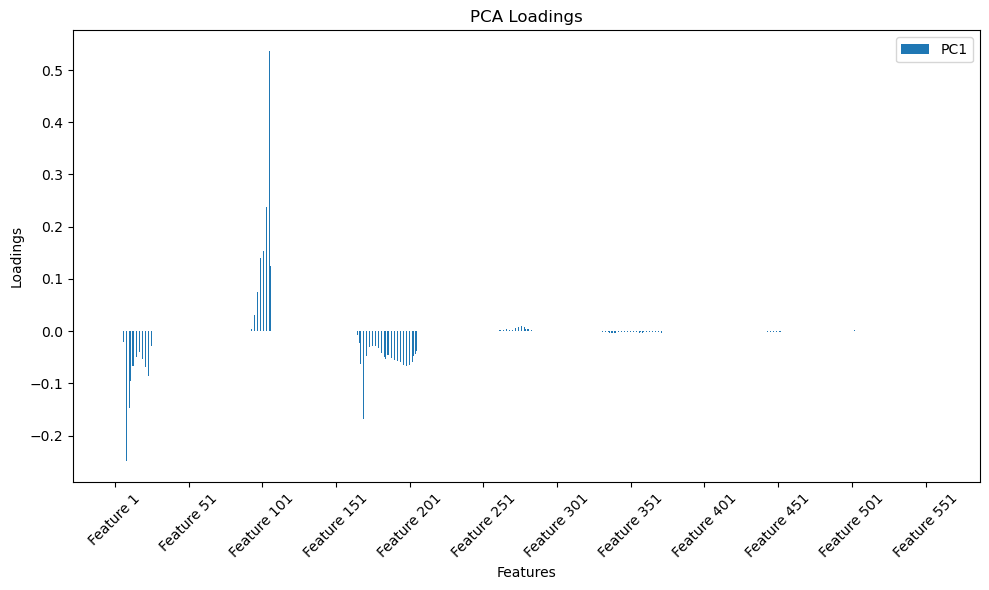

In [172]:
feature_names = [f"Feature {i+1}" for i in range(hist_norm_adt.shape[1])]

loadings = pca_adt.components_.T  # Shape: (n_features, n_components)
loadings_df = pd.DataFrame(loadings, columns=["PC1", "PC2"], index=feature_names)

plt.figure(figsize=(10, 6))


x = np.arange(len(feature_names))
plt.bar(x - 0.2, loadings[:, 0], width=0.4, label="PC1")
#plt.bar(x + 0.2, loadings[:, 1], width=0.4, label="PC2")

plt.xticks(x[::50], feature_names[::50], rotation=45)
plt.xlabel("Features")
plt.ylabel("Loadings")
plt.title("PCA Loadings")
plt.legend()
plt.tight_layout()
plt.show()

In [173]:
temp = np.concatenate([np.tile(np.array([color]), (250, 1))for color in color_legend], axis=0)
labels_lig = np.tile(temp, (len(proteins_site2),1))

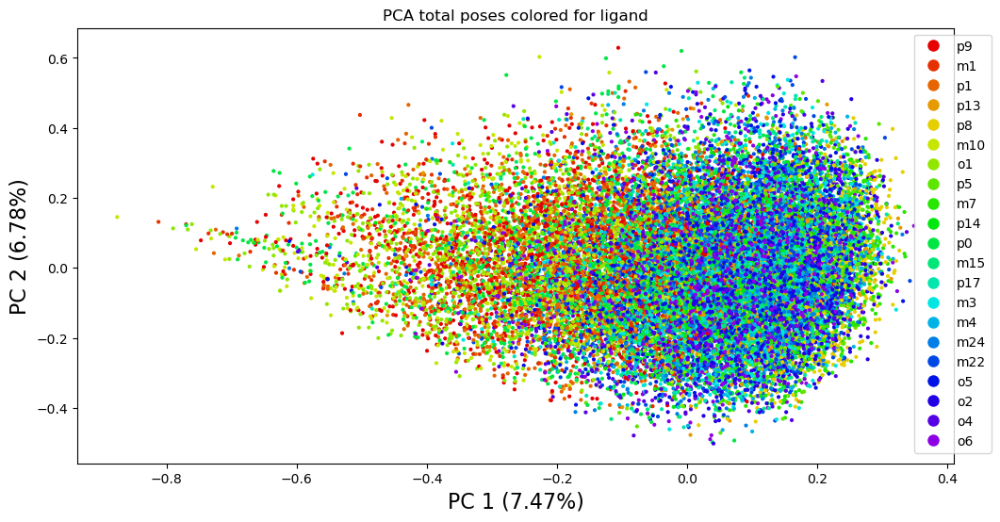

In [174]:
plt.figure(figsize=(12, 6))
scatter = plt.scatter(pca_data_adt[:, 0], pca_data_adt[:, 1], c=labels_lig,s=4)

handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=c, markersize=10) for c in color_legend]
legend_labels = [f'{i}' for i in ligands]
plt.legend(handles,legend_labels, loc='upper right', bbox_to_anchor=(1.05, 1))
plt.title('PCA total poses colored for ligand')
plt.xlabel("PC 1 (%s%%)"%round(pca_adt.explained_variance_ratio_[0]*100,2), fontsize=16)
plt.ylabel("PC 2 (%s%%)"%round(pca_adt.explained_variance_ratio_[1]*100,2), fontsize=16)
plt.show()

## Clustering poses

Here you can find the clustering analysis of all AutoDock-GPU poses, from which only the clusters accounting for approximately 50% of the total poses were retained. For these selected clusters, we performed PCA on the corresponding interaction profiles and computed the regression line between the PC1 values of each ligand within each cluster and the experimental affinity measurements.

In [176]:
os.chdir(work_fingernat+"site1/cluster_poses_site1_adt")
with open('clustered_poses_site1_adt.pkl', 'rb') as file:
    clustered_poses = pickle.load(file)
with open('clustered_poses_site1_adt_dictionary.pkl', 'rb') as file:
    clustered_poses_adt_dict = pickle.load(file)

In [177]:
BLOCK = 250
L = len(ligands)
P = len(proteins_site1)
PER_PROT = L * BLOCK

clusters = clustered_poses.clusters
result = defaultdict(list)

for cid, pose_indices in enumerate(clusters[:31]):
    for g in np.asarray(pose_indices, dtype=int):
        p_idx = g // PER_PROT
        within = g % PER_PROT
        l_idx = within // BLOCK
        pose_num = (within % BLOCK) + 1
        key = (proteins_site1[p_idx], ligands[l_idx], cid)
        result[key].append(pose_num)

for k in result:
    result[k].sort()

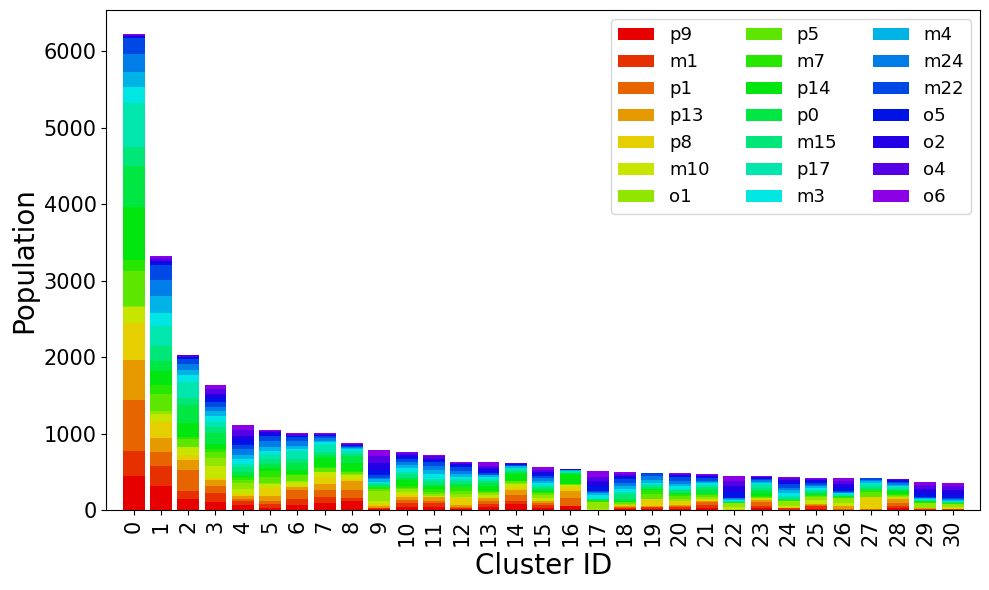

In [178]:
# map ligand → color and ligand → row index
ligand_to_color = {lig: color_legend[i] for i, lig in enumerate(ligands)}
lig_idx = {lig: i for i, lig in enumerate(ligands)}

# count occurrences for each (ligand, cluster)
num_elements_x_lig = defaultdict(int)
for (_, lig, cid), poses in result.items():
    num_elements_x_lig[(lig, cid)] += len(poses)

# number of clusters to plot (0..K-1), max 31
max_cid = max((cid for (_, cid) in num_elements_x_lig.keys()), default=-1)
K = min(31, max_cid + 1)

# build count matrix [ligand, cluster]
counts = np.zeros((len(ligands), K), dtype=int)
for (lig, cid), cnt in num_elements_x_lig.items():
    if 0 <= cid < K:
        counts[lig_idx[lig], cid] = cnt

# stacked bar plot
x = np.arange(K)
plt.figure(figsize=(10, 6))
bottom = np.zeros(K, dtype=int)

for i, lig in enumerate(ligands):
    h = counts[i]
    if h.any():
        plt.bar(x, h, bottom=bottom, color=ligand_to_color[lig], label=lig)
        bottom += h

plt.xlabel("Cluster ID", fontsize=20)
plt.ylabel("Population", fontsize=20)
plt.xticks(x, x, rotation=90 if K > 20 else 0, fontsize=15)
plt.yticks(fontsize=15)
plt.legend(loc="upper right", fontsize=13, ncol=3)
plt.xlim(-1, K)
plt.tight_layout()
plt.show()

In [179]:
n_clusters=22

In [180]:
clustered_poses_adt_dict_ordered = {}
for i in range(n_clusters):
    for lig in ligands:
        for key in clustered_poses_adt_dict:
            if key[1] == lig and key[2] == i:
                 clustered_poses_adt_dict_ordered[key] = clustered_poses_adt_dict[key]

In [181]:
os.chdir(work_fingernat+"site1/outputs_adt_dha_tot_clustered_site1")
df_adt_clusters={}
for i in range(n_clusters):
        data=open("interaction_cl_{}.txt".format(i),"r")
        data_array=[]
        data.readline()
        for line in data:
            temp=[]
            line=line.split('\t')
            temp.append(str(line[4]))
            temp.append(float(line[-1]))
            data_array.append(temp)
        df_adt_clusters['cluster_{}'.format(i)] = pd.DataFrame(data_array, columns=['Interaction', 'Distance'])

In [183]:
df_adt_poses_clusters={}
os.chdir(work_fingernat+"site1/outputs_adt_dha_tot_clustered_site1/")
for key in clustered_poses_adt_dict_ordered:
    data_array=[]
    data=open("DETAIL_{}.pdb_poses_cluster_{}_{}_{}.sdf_FULL.txt".format(key[0],key[1],key[0],key[2]),"r")
    data.readline()
    lines=data.readlines()
    index_max=int(lines[-1].split('\t')[2])
    for i in range(1,index_max+1):
        for line in lines:
            line=line.split('\t')
            temp=[]
            if int(line[2])==i:
                temp.append(str(line[4]))
                temp.append(float(line[-1]))
            if len(temp)>0:
                data_array.append(temp)
        df_adt_poses_clusters[key[0],key[1],key[2],int(clustered_poses_adt_dict_ordered[key][i-1])] = pd.DataFrame(data_array, columns=['Interaction', 'Distance'])

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/df_adt_poses_clusters_site1.pkl", "wb") as f:
#    pickle.dump(df_adt_poses_clusters, f)

# --- Load ---
with open(path_data+"data_plots/df_adt_poses_clusters_site1.pkl", "rb") as f:
    df_adt_poses_clusters = pickle.load(f)

In [185]:
bins = np.linspace(2, 8, 81)
bin_centers_clustered = (bins[:-1] + bins[1:]) / 2


hist_clustered = []
bin_edges_clustered = []


for key in df_adt_poses_clusters:
    distances = {interaction: [] for interaction in interactions.keys()}
    
    for interaction, distance in zip(df_adt_poses_clusters[key]["Interaction"], df_adt_poses_clusters[key]["Distance"]):
        if interaction in distances:
            distances[interaction].append(distance)
    
    hist_i = []
    for interaction in interactions.keys():
        temp_hist_i, temp_bin_edges_i = np.histogram(distances[interaction], bins=bins)
        hist_i.extend(temp_hist_i)
    
    hist_clustered.append(hist_i)
    bin_edges_clustered.append(bins)  

In [186]:
hist_ok_clustered=[]
for i in range(len(hist_clustered)):
    hist_ok_clustered.append([int(x) for x in hist_clustered[i]])
hist_ok_clustered=np.array(hist_ok_clustered)
hist_norm_clustered = normalize(hist_ok_clustered, axis=1)

In [187]:
pca_clustered = PCA(n_components=2)
pca_data_clustered = pca_clustered.fit_transform(np.array(hist_norm_clustered))
pca_clustered.explained_variance_ratio_

array([0.18501154, 0.05124754])

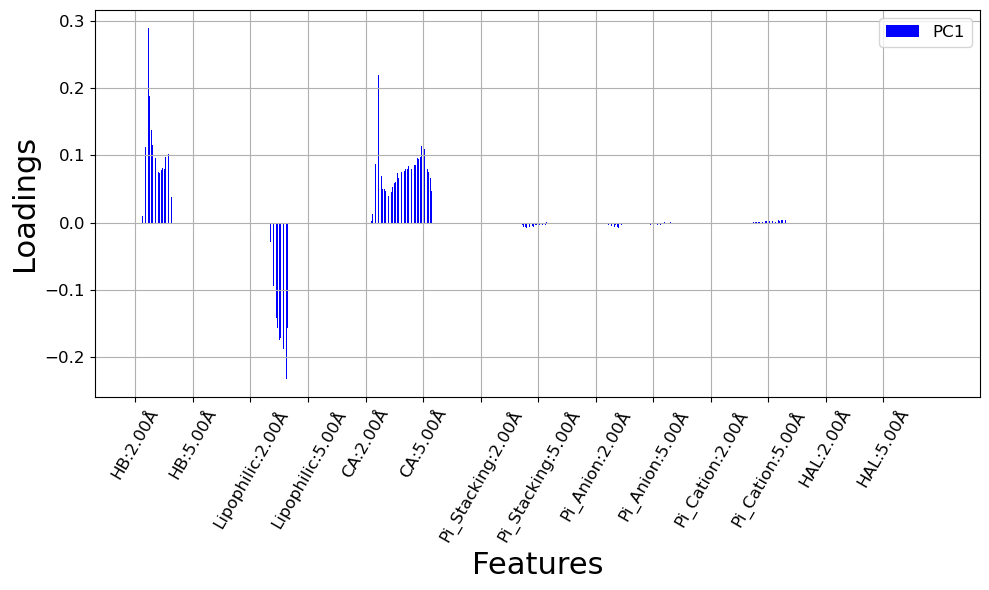

In [188]:
n_per_block = 80
categories = list(interactions.keys())
n_features = len(categories) * n_per_block

feature_labels = [f"{cat}:{2 + (i / n_per_block) * 6:.2f}Å"for cat in categories for i in range(n_per_block)]

loadings = pca_clustered.components_.T
x = np.arange(n_features)

plt.figure(figsize=(10, 6))
plt.bar(x, loadings[:, 0], width=0.5, color="blue", label="PC1")

plt.xticks(x[::40], feature_labels[::40], rotation=60, fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel("Features", fontsize=22)
plt.ylabel("Loadings", fontsize=22)
plt.grid()
plt.legend(fontsize=12)
plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/loadings_site2.png', dpi=300, bbox_inches='tight')
plt.show()

In [189]:
num_elements_x_lig={}
for i in range(n_clusters):
    for lig in ligands:
        sum=0
        for key in clustered_poses_adt_dict_ordered:
            if key[1]==lig and key[2]==i:
                sum+=len(clustered_poses_adt_dict_ordered[key])
                key_temp=key[1:]
        num_elements_x_lig[(lig,i)]=sum

In [190]:
colors_cluster_tot = []
for (ligand, _), count in num_elements_x_lig.items():
    color = ligand_to_color[ligand]
    colors_cluster_tot.extend([color] * count) 



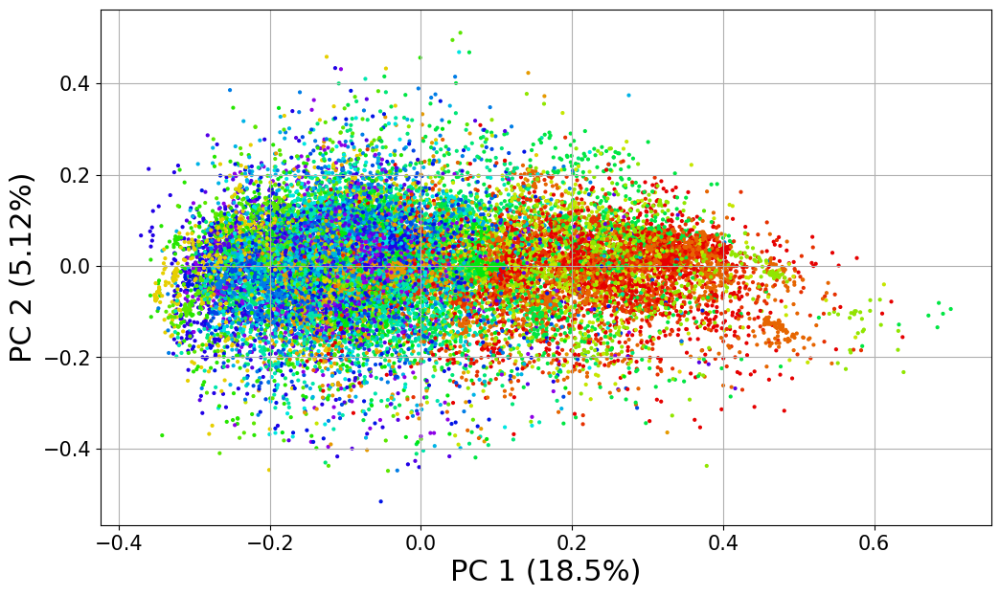

In [191]:
plt.figure(figsize=(12, 7))
scatter = plt.scatter(pca_data_clustered[:, 0], pca_data_clustered[:, 1], c=colors_cluster_tot,s=4)

handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=c, markersize=10) for c in color_legend]
legend_labels = [f'{i}' for i in ligands]

plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel("PC 1 (%s%%)"%round(pca_clustered.explained_variance_ratio_[0]*100,2), fontsize=22)
plt.ylabel("PC 2 (%s%%)"%round(pca_clustered.explained_variance_ratio_[1]*100,2), fontsize=22)
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/pca_tot_color_lig_clusters_site1.png', dpi=300, bbox_inches='tight')
plt.show()

In [192]:
el_clusters={}
for i in range(n_clusters):
    sum=0
    for key in clustered_poses_adt_dict_ordered:
        if key[2]==i:
            sum+=len(clustered_poses_adt_dict_ordered[key])
    el_clusters[i]=sum

In [193]:
color_legend_clusters = ["#FF0000","#FF3300","#FF6600","#FF8000","#FF9933","#FFB266","#FFCC00","#FFE600","#FFFF00","#CCFF00","#99FF00","#66FF33","#33FF66","#00FF99","#00FFCC","#00FFFF","#00CCFF","#0099FF","#0066FF","#0033FF","#0000FF","#3300FF"]

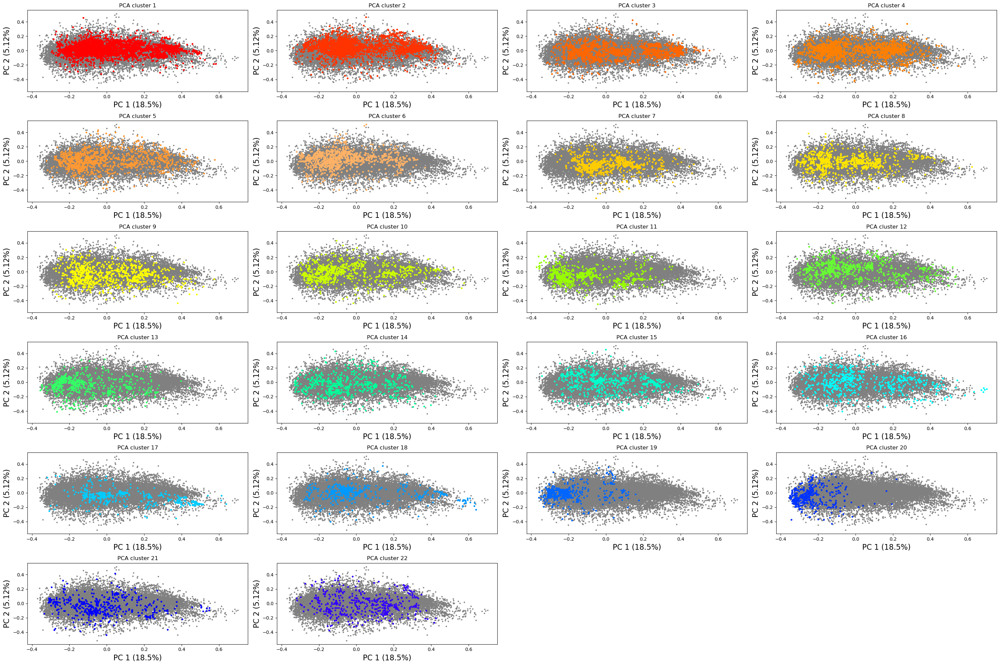

In [194]:
plt.figure(figsize=(30, 20))
temp_el=0
for i in range(1,n_clusters+1):
    j=i-1
    plt.subplot(int(n_clusters/4)+1,4,i)
    if j==0:
        scatter = plt.scatter(pca_data_clustered[:, 0], pca_data_clustered[:, 1], color="grey",s=4)
        scatter = plt.scatter(pca_data_clustered[:el_clusters[j], 0], pca_data_clustered[:el_clusters[j], 1], color=color_legend_clusters[j],s=8)
    else:
        scatter = plt.scatter(pca_data_clustered[:, 0], pca_data_clustered[:, 1], color="grey",s=4)
        scatter = plt.scatter(pca_data_clustered[temp_el:(temp_el+el_clusters[j]), 0], pca_data_clustered[temp_el:(temp_el+el_clusters[j]), 1], color=color_legend_clusters[j],s=8)
    # Customize plot
    #plt.legend(handles,legend_labels, loc='upper right', bbox_to_anchor=(1.05, 1))
    temp_el+=el_clusters[j]
    plt.title('PCA cluster {}'.format(i))
    plt.xlabel("PC 1 (%s%%)"%round(pca_clustered.explained_variance_ratio_[0]*100,2), fontsize=16)
    plt.ylabel("PC 2 (%s%%)"%round(pca_clustered.explained_variance_ratio_[1]*100,2), fontsize=16)
plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/temp/S14.png', dpi=300, bbox_inches='tight')
plt.show()

In [195]:
lig_per_cluster={}
for n_cl in range(n_clusters):
    for lig in ligands:
        tot_element=0
        for key, frames in clustered_poses_adt_dict_ordered.items():
            if key[1]==lig and key[2]==n_cl:
                tot_element+=len(frames)
        lig_per_cluster[lig,n_cl]=tot_element
cluster_avg_pc1={}
start=0
end=0
for n_cl in range(n_clusters):
    array_avg=[]
    for lig in ligands:
        end+=lig_per_cluster[lig,n_cl]
        avg=np.average(pca_data_clustered[start:end, 0])
        array_avg.append(avg)
        start=end
    cluster_avg_pc1[n_cl]=array_avg

/home/francy/.local/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/francy/.local/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [196]:
exp_values = [0.29, 0.45, 0.5, 0.55, 0.69, 0.79, 0.81, 0.87, 0.87, 1.03, 1.03,1.27, 1.42, 1.44, 1.56, 1.58, 1.81, 2]
ligands_regression = ['p9', 'm1', 'p1', 'p13','p8' 'm10', 'o1', 'p5', 'm7', 'p14', 'p0', 'm15', 'p17', 'm3', 'm4', 'm24', 'm22', 'o5']

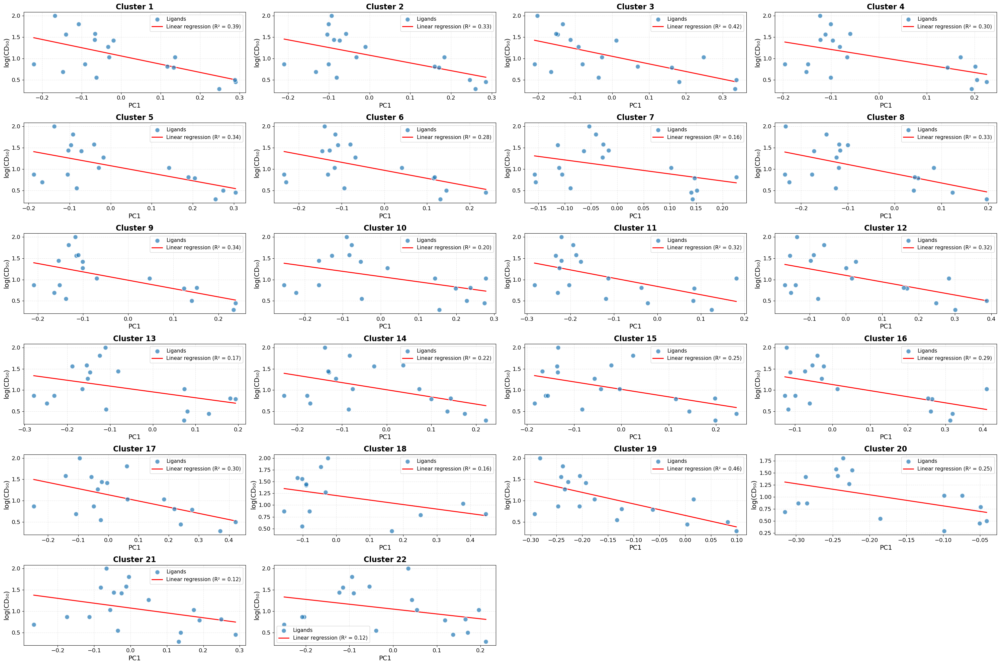

In [197]:
fig, axes = plt.subplots((n_clusters//4)+1, 4, figsize=(30, 20))
axes = axes.flatten()

for cluster_num in range(n_clusters):
    ax = axes[cluster_num]
    
    x_data = np.array(cluster_avg_pc1[cluster_num][:18])
    y_data = exp_values.copy()
    
    # Rimuovi NaN
    mask = ~np.isnan(x_data)
    k=0
    x_clean=[]
    y_clean=[]
    for el in mask:
        if el==True:
            x_clean.append(x_data[k])
            y_clean.append(y_data[k])
        k+=1
    x_clean=np.array(x_clean)
    y_clean=np.array(y_clean)
    slope, intercept, r_value, p_value, std_err = stats.linregress(x_clean, y_clean)
    r_squared = r_value**2
    
    # Plot punti
    ax.scatter(x_clean, y_clean, s=100, alpha=0.7, edgecolors='white', linewidth=1.5, label='Ligands', zorder=3)
    
    # Linea di regressione
    x_line = np.array([x_clean.min(), x_clean.max()])
    y_line = slope * x_line + intercept
    ax.plot(x_line, y_line, 'r-', linewidth=2, label=f'Linear regression (R² = {r_squared:.2f})', zorder=2)
    
    ax.set_xlabel('PC1', fontsize=14)
    ax.set_ylabel('log(CD₅₀)', fontsize=14)
    ax.set_title(f'Cluster {cluster_num+1}', fontsize=16, fontweight='bold')
    ax.grid(True, alpha=0.3, linestyle='--')
    ax.legend(frameon=True, fontsize=11, loc='best')
    ax.tick_params(labelsize=12)
for idx in range(n_clusters, n_clusters+2):
    fig.delaxes(axes[idx])

plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/temp/S15.png', dpi=300, bbox_inches='tight')
plt.show()

In [198]:
os.chdir(work_fingernat+"site2/cluster_poses_site2_adt")
with open('clustered_poses_site2_adt.pkl', 'rb') as file:
    clustered_poses = pickle.load(file)
with open('clustered_poses_site2_adt_dictionary.pkl', 'rb') as file:
    clustered_poses_adt_dict = pickle.load(file)

In [199]:
BLOCK = 250
L = len(ligands)
P = len(proteins_site1)
PER_PROT = L * BLOCK

clusters = clustered_poses.clusters
result = defaultdict(list)

for cid, pose_indices in enumerate(clusters[:31]):
    for g in np.asarray(pose_indices, dtype=int):
        p_idx = g // PER_PROT
        within = g % PER_PROT
        l_idx = within // BLOCK
        pose_num = (within % BLOCK) + 1
        key = (proteins_site1[p_idx], ligands[l_idx], cid)
        result[key].append(pose_num)

for k in result:
    result[k].sort()

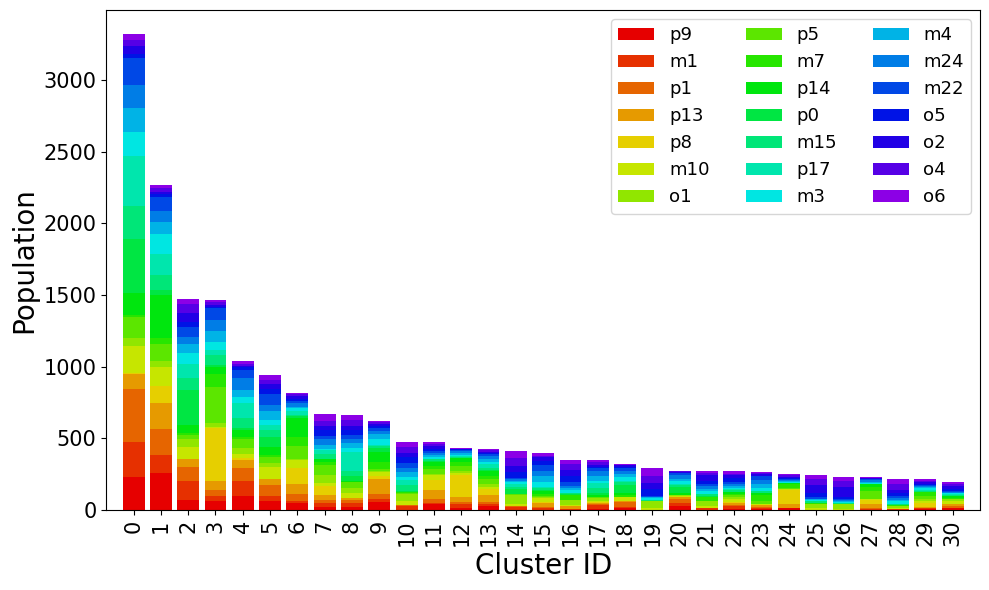

In [200]:
# map ligand → color and ligand → row index
ligand_to_color = {lig: color_legend[i] for i, lig in enumerate(ligands)}
lig_idx = {lig: i for i, lig in enumerate(ligands)}

# count occurrences for each (ligand, cluster)
num_elements_x_lig = defaultdict(int)
for (_, lig, cid), poses in result.items():
    num_elements_x_lig[(lig, cid)] += len(poses)

# number of clusters to plot (0..K-1), max 31
max_cid = max((cid for (_, cid) in num_elements_x_lig.keys()), default=-1)
K = min(31, max_cid + 1)

# build count matrix [ligand, cluster]
counts = np.zeros((len(ligands), K), dtype=int)
for (lig, cid), cnt in num_elements_x_lig.items():
    if 0 <= cid < K:
        counts[lig_idx[lig], cid] = cnt

# stacked bar plot
x = np.arange(K)
plt.figure(figsize=(10, 6))
bottom = np.zeros(K, dtype=int)

for i, lig in enumerate(ligands):
    h = counts[i]
    if h.any():
        plt.bar(x, h, bottom=bottom, color=ligand_to_color[lig], label=lig)
        bottom += h

plt.xlabel("Cluster ID", fontsize=20)
plt.ylabel("Population", fontsize=20)
plt.xticks(x, x, rotation=90 if K > 20 else 0, fontsize=15)
plt.yticks(fontsize=15)
plt.legend(loc="upper right", fontsize=13, ncol=3)
plt.xlim(-1, K)
plt.tight_layout()
plt.show()

In [201]:
n_clusters=10

In [202]:
clustered_poses_adt_dict_ordered = {}
for i in range(n_clusters):
    for lig in ligands:
        for key in clustered_poses_adt_dict:
            if key[1] == lig and key[2] == i:
                 clustered_poses_adt_dict_ordered[key] = clustered_poses_adt_dict[key]

In [203]:
os.chdir(work_fingernat+"site2/outputs_adt_dha_tot_clustered_site2")
df_adt_clusters={}
for i in range(n_clusters):
        data=open("interaction_cl_{}.txt".format(i),"r")
        data_array=[]
        data.readline()
        for line in data:
            temp=[]
            line=line.split('\t')
            temp.append(str(line[4]))
            temp.append(float(line[-1]))
            data_array.append(temp)
        df_adt_clusters['cluster_{}'.format(i)] = pd.DataFrame(data_array, columns=['Interaction', 'Distance'])

In [204]:
df_adt_poses_clusters={}
os.chdir(work_fingernat+"site2/outputs_adt_dha_tot_clustered_site2/")
for key in clustered_poses_adt_dict_ordered:
    data_array=[]
    data=open("DETAIL_{}.pdb_poses_cluster_{}_{}_{}.sdf_FULL.txt".format(key[0],key[1],key[0],key[2]),"r")
    data.readline()
    lines=data.readlines()
    index_max=int(lines[-1].split('\t')[2])
    for i in range(1,index_max+1):
        for line in lines:
            line=line.split('\t')
            temp=[]
            if int(line[2])==i:
                temp.append(str(line[4]))
                temp.append(float(line[-1]))
            if len(temp)>0:
                data_array.append(temp)
        df_adt_poses_clusters[key[0],key[1],key[2],int(clustered_poses_adt_dict_ordered[key][i-1])] = pd.DataFrame(data_array, columns=['Interaction', 'Distance'])

In [ ]:
# --- Save ---
#with open(path_data+"data_plots/df_adt_poses_clusters_site2.pkl", "wb") as f:
#    pickle.dump(df_adt_poses_clusters, f)

# --- Load ---
with open(path_data+"data_plots/df_adt_poses_clusters_site2.pkl", "rb") as f:
    df_adt_poses_clusters = pickle.load(f)

In [205]:
bins = np.linspace(2, 8, 81)
bin_centers_clustered = (bins[:-1] + bins[1:]) / 2


hist_clustered = []
bin_edges_clustered = []


for key in df_adt_poses_clusters:
    distances = {interaction: [] for interaction in interactions.keys()}
    

    for interaction, distance in zip(df_adt_poses_clusters[key]["Interaction"], df_adt_poses_clusters[key]["Distance"]):
        if interaction in distances:
            distances[interaction].append(distance)
    

    hist_i = []
    for interaction in interactions.keys():
        temp_hist_i, temp_bin_edges_i = np.histogram(distances[interaction], bins=bins)
        hist_i.extend(temp_hist_i)
    
    hist_clustered.append(hist_i)
    bin_edges_clustered.append(bins)

print(np.array(hist_clustered).shape)

(13278, 560)


In [207]:
hist_ok_clustered=[]
for i in range(len(hist_clustered)):
    hist_ok_clustered.append([int(x) for x in hist_clustered[i]])
hist_ok_clustered=np.array(hist_ok_clustered)
hist_norm_clustered = normalize(hist_ok_clustered, axis=1)

In [208]:
pca_clustered = PCA(n_components=2)
pca_data_clustered = pca_clustered.fit_transform(np.array(hist_norm_clustered))
pca_clustered.explained_variance_ratio_

array([0.19921148, 0.05926381])

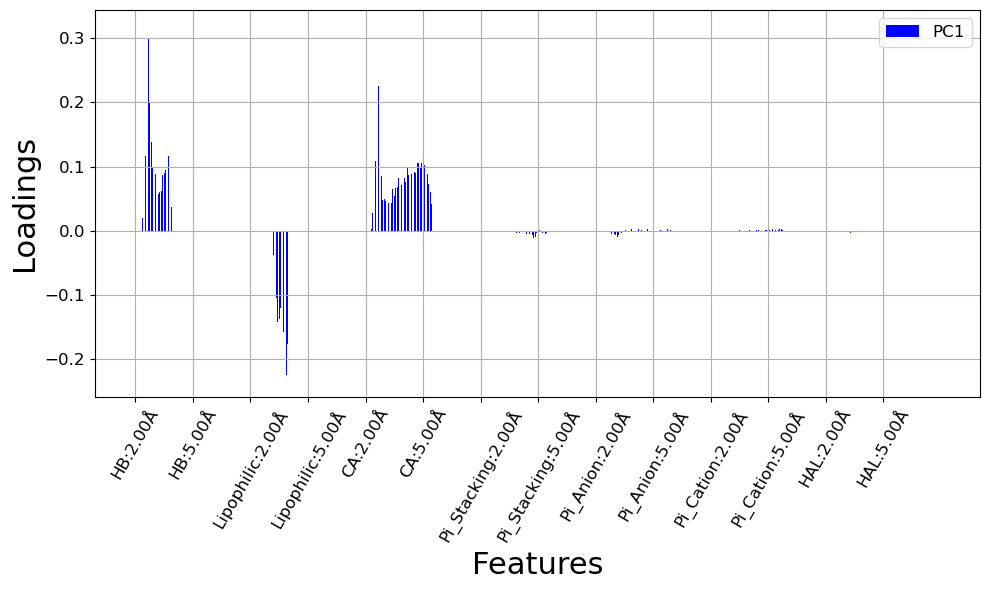

In [209]:
n_per_block = 80
categories = list(interactions.keys())
n_features = len(categories) * n_per_block

feature_labels = [f"{cat}:{2 + (i / n_per_block) * 6:.2f}Å"for cat in categories for i in range(n_per_block)]

loadings = pca_clustered.components_.T
x = np.arange(n_features)

plt.figure(figsize=(10, 6))
plt.bar(x, loadings[:, 0], width=0.5, color="blue", label="PC1")

plt.xticks(x[::40], feature_labels[::40], rotation=60, fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel("Features", fontsize=22)
plt.ylabel("Loadings", fontsize=22)
plt.grid()
plt.legend(fontsize=12)
plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/loadings_site2.png', dpi=300, bbox_inches='tight')
plt.show()

In [210]:
num_elements_x_lig={}
for i in range(n_clusters):
    for lig in ligands:
        sum=0
        for key in clustered_poses_adt_dict_ordered:
            if key[1]==lig and key[2]==i:
                sum+=len(clustered_poses_adt_dict_ordered[key])
                key_temp=key[1:]
        num_elements_x_lig[(lig,i)]=sum

In [211]:
colors_cluster_tot = []
for (ligand, _), count in num_elements_x_lig.items():
    color = ligand_to_color[ligand]
    colors_cluster_tot.extend([color] * count) 

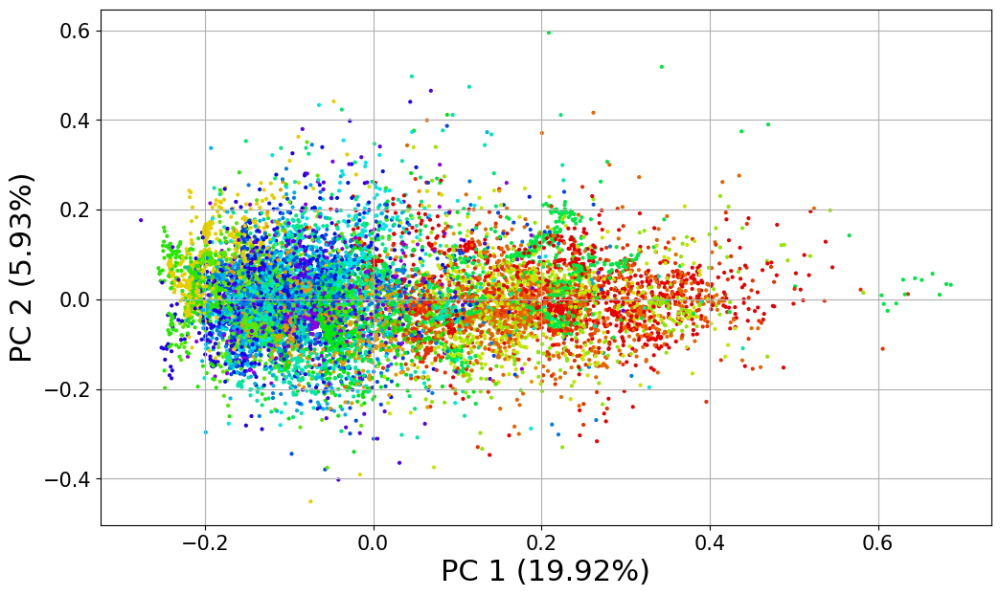

In [212]:
plt.figure(figsize=(12, 7))
scatter = plt.scatter(pca_data_clustered[:, 0], pca_data_clustered[:, 1], c=colors_cluster_tot,s=4)

handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=c, markersize=10) for c in color_legend]
legend_labels = [f'{i}' for i in ligands]

plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel("PC 1 (%s%%)"%round(pca_clustered.explained_variance_ratio_[0]*100,2), fontsize=22)
plt.ylabel("PC 2 (%s%%)"%round(pca_clustered.explained_variance_ratio_[1]*100,2), fontsize=22)
plt.grid()
#plt.savefig('/media/francy/Storage/raguti/file4ric/imm_malat/pca_tot_color_lig_clusters_site2.png', dpi=300, bbox_inches='tight')
plt.show()

In [213]:
el_clusters={}
for i in range(n_clusters):
    sum=0
    for key in clustered_poses_adt_dict_ordered:
        if key[2]==i:
            sum+=len(clustered_poses_adt_dict_ordered[key])
    el_clusters[i]=sum

In [214]:
color_legend_clusters=["#FF0000","#FF4000","#FF8000","#FFBF00","#FFFF00","#80FF00","#00FF80","#00FFFF","#0080FF","#0000FF"]

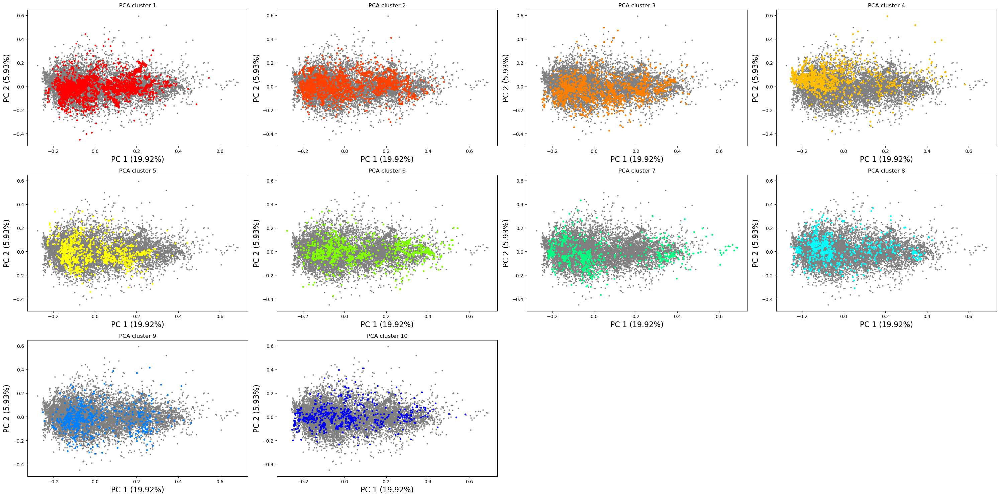

In [215]:
plt.figure(figsize=(30, 15))
temp_el=0
for i in range(1,n_clusters+1):
    j=i-1
    plt.subplot(int(n_clusters/4)+1,4,i)
    if j==0:
        scatter = plt.scatter(pca_data_clustered[:, 0], pca_data_clustered[:, 1], color="grey",s=4)
        scatter = plt.scatter(pca_data_clustered[:el_clusters[j], 0], pca_data_clustered[:el_clusters[j], 1], color=color_legend_clusters[j],s=8)
    else:
        scatter = plt.scatter(pca_data_clustered[:, 0], pca_data_clustered[:, 1], color="grey",s=4)
        scatter = plt.scatter(pca_data_clustered[temp_el:(temp_el+el_clusters[j]), 0], pca_data_clustered[temp_el:(temp_el+el_clusters[j]), 1], color=color_legend_clusters[j],s=8)
    # Customize plot
    #plt.legend(handles,legend_labels, loc='upper right', bbox_to_anchor=(1.05, 1))
    temp_el+=el_clusters[j]
    plt.title('PCA cluster {}'.format(i))
    plt.xlabel("PC 1 (%s%%)"%round(pca_clustered.explained_variance_ratio_[0]*100,2), fontsize=16)
    plt.ylabel("PC 2 (%s%%)"%round(pca_clustered.explained_variance_ratio_[1]*100,2), fontsize=16)
plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/temp/S16.png', dpi=300, bbox_inches='tight')
plt.show()

In [216]:
lig_per_cluster={}
for n_cl in range(n_clusters):
    for lig in ligands:
        tot_element=0
        for key, frames in clustered_poses_adt_dict_ordered.items():
            if key[1]==lig and key[2]==n_cl:
                tot_element+=len(frames)
        lig_per_cluster[lig,n_cl]=tot_element
cluster_avg_pc1={}
start=0
end=0
for n_cl in range(n_clusters):
    array_avg=[]
    for lig in ligands:
        end+=lig_per_cluster[lig,n_cl]
        avg=np.average(pca_data_clustered[start:end, 0])
        array_avg.append(avg)
        start=end
    cluster_avg_pc1[n_cl]=array_avg



/home/francy/.local/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/francy/.local/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


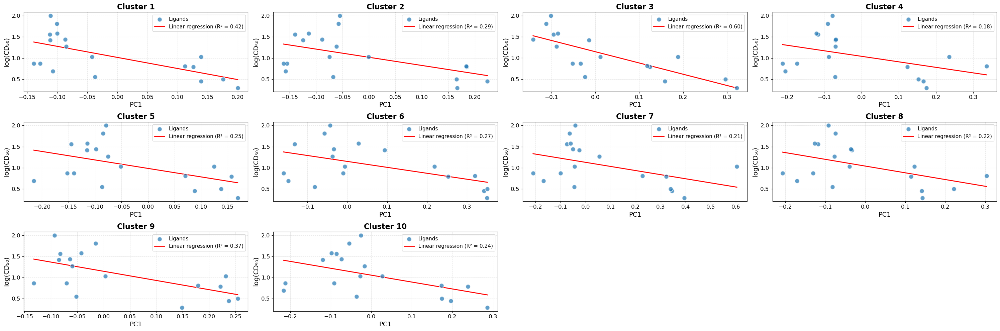

In [217]:
fig, axes = plt.subplots(3, 4, figsize=(30, 10))
axes = axes.flatten()

for cluster_num in range(n_clusters):
    ax = axes[cluster_num]
    
    x_data = np.array(cluster_avg_pc1[cluster_num][:18])
    y_data = exp_values.copy()
    
    # Rimuovi NaN
    mask = ~np.isnan(x_data)
    k=0
    x_clean=[]
    y_clean=[]
    for el in mask:
        if el==True:
            x_clean.append(x_data[k])
            y_clean.append(y_data[k])
        k+=1
    x_clean=np.array(x_clean)
    y_clean=np.array(y_clean)
    slope, intercept, r_value, p_value, std_err = stats.linregress(x_clean, y_clean)
    r_squared = r_value**2
    
    # Plot punti
    ax.scatter(x_clean, y_clean, s=100, alpha=0.7, edgecolors='white', linewidth=1.5, label='Ligands', zorder=3)
    
    # Linea di regressione
    x_line = np.array([x_clean.min(), x_clean.max()])
    y_line = slope * x_line + intercept
    ax.plot(x_line, y_line, 'r-', linewidth=2, label=f'Linear regression (R² = {r_squared:.2f})', zorder=2)
    
    ax.set_xlabel('PC1', fontsize=14)
    ax.set_ylabel('log(CD₅₀)', fontsize=14)
    ax.set_title(f'Cluster {cluster_num+1}', fontsize=16, fontweight='bold')
    ax.grid(True, alpha=0.3, linestyle='--')
    ax.legend(frameon=True, fontsize=11, loc='best')
    ax.tick_params(labelsize=12)

# Rimuovi gli ultimi 2 assi vuoti
for idx in range(n_clusters, n_clusters+2):
    fig.delaxes(axes[idx])

plt.tight_layout()
#plt.savefig('/media/francy/Storage/raguti/file4ric/temp/S17.png', dpi=300, bbox_inches='tight')
plt.show()